In [2]:
# Import Python standard library and IPython packages we need.
import os
import subprocess
import sys
import csv
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict

# Ask GRASS GIS where its Python packages are.
gisbase = subprocess.check_output(["grass", "--config", "path"], text=True).strip()
os.environ["GISBASE"] = gisbase
sys.path.append(os.path.join(gisbase, "etc", "python"))

# Import the GRASS GIS packages we need.
import grass.script as gs
import grass.jupyter as gj

# Helper function saved in rapid_dem.py
import rapid_dem as rd

# Start GRASS Session
## Set your grass data location
gj.init("../../../grassdata", "nc_spm_08_grass7", "rapid-dem")

# Source Data

In [83]:
gs.parse_command("g.region", flags="p")

{'projection: 99 (Lambert Conformal Conic)': None,
 'zone:       0': None,
 'datum:      nad83': None,
 'ellipsoid:  a': '6378137 es=0.006694380022900787',
 'north:      227531.84698497': None,
 'south:      215523.977271': None,
 'west:       629266.09686877': None,
 'east:       651974.95050478': None,
 'nsres:      0.99998915': None,
 'ewres:      0.99999355': None,
 'rows:       12008': None,
 'cols:       22709': None,
 'cells:      272689672': None}

# PlanetScope Data

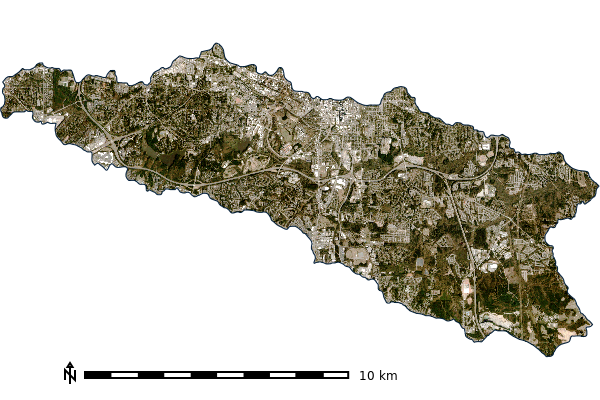

In [11]:
gs.run_command("g.region", raster="ps_before_3m_comp", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
before_30m_map = gj.GrassRenderer(filename="output/before_30m.png")
before_30m_map.d_erase()
before_30m_map.d_rast(map="ps_before_3m_comp")
before_30m_map.d_vect(map="walnut_creek", fill_color="none")
before_30m_map.d_barscale(at=(10,10,10,10), units="kilometers", flags="n")
before_30m_map.show()

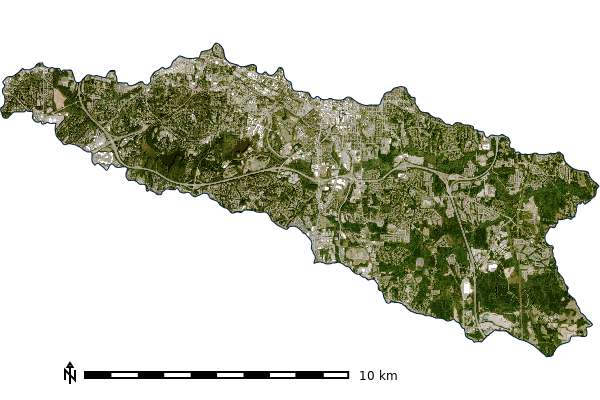

In [12]:
gs.run_command("g.region", raster="ps_before_3m_comp", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
after_30m_map = gj.GrassRenderer(filename="output/after_30m.png")
after_30m_map.d_erase()
after_30m_map.d_rast(map="ps_after_3m_comp")
after_30m_map.d_vect(map="walnut_creek", fill_color="none")
after_30m_map.d_barscale(at=(10,10,10,10), units="kilometers", flags="n")
after_30m_map.show()

## Binary Change Detection

### Binary Change Red

Mean: 38.4974641875785
Std: 194.156128751552
Change Threshold: -446.89285769130146


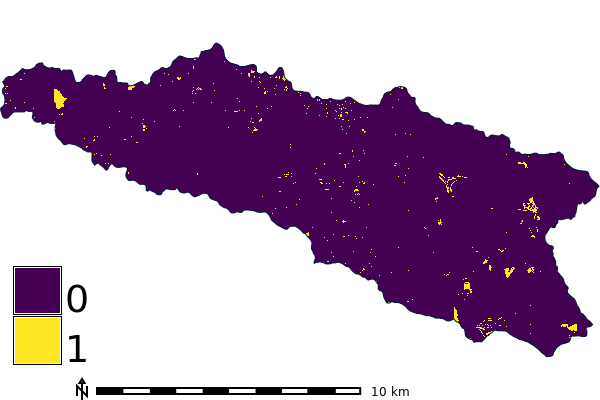

In [4]:
gs.run_command("g.region", raster="ps_before_3m_comp", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)

rd.binary_change("ps_before_3m.r", "ps_after_3m.r")
binary_change_map = gj.GrassRenderer(filename="output/binary_change_mask.png")
binary_change_map.d_erase()
binary_change_map.d_rast(map="binary_change_mask")
binary_change_map.d_vect(map="walnut_creek", fill_color="none")
binary_change_map.d_legend(raster="binary_change_mask", at=(2,40,2,6))
binary_change_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
binary_change_map.show()

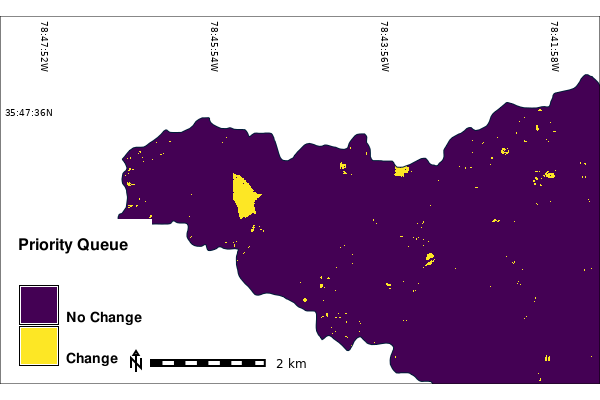

In [5072]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

!r.reclass input=binary_change_mask output=binary_change_mask_reclass rules="grass_config/binary_change_reclass.txt" title="Binary Change"


binary_change_map = gj.GrassRenderer(filename="output/binary_change_mask_nw.png")
binary_change_map.d_erase()
binary_change_map.d_rast(map="binary_change_mask_reclass")
binary_change_map.d_vect(map="walnut_creek", fill_color="none")
binary_change_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
binary_change_map.d_legend(raster="binary_change_mask_reclass", at=(3,34,3,6),title="Priority Queue",title_fontsize=16,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white",flags="cb" )
binary_change_map.d_barscale(at=(21,13), units="kilometers", length=2, flags="n")

binary_change_map.show()

# Land Cover Before and After

## Reclass and Color

In [8]:
!r.reclass input=classified_before_30m output=classified_before_30m_recl rules="grass_config/classified_reclass.txt" title="Land Cover (Before)"
!r.reclass input=classified_after_30m output=classified_after_30m_recl rules="grass_config/classified_reclass.txt" title="Land Cover (After)"
!r.colors map="classified_before_30m_recl,classified_after_30m_recl" rules="grass_config/classified_colors.txt"

Color table for raster map <classified_before_30m_recl> set to
'grass_config/classified_colors.txt'
Color table for raster map <classified_after_30m_recl> set to
'grass_config/classified_colors.txt'


### View Before Land Cover

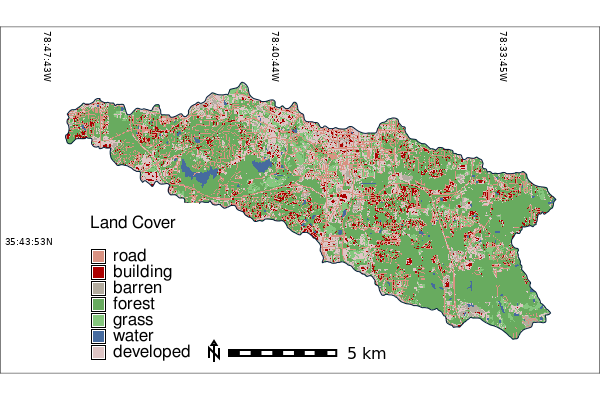

In [9]:
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
gs.run_command("g.region",
               raster="walnut_creek",
               # region="nw_one_third",
               res=3, flags="pa")

view_reg = gs.region("walnut_creek")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 3000
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 1500

gs.run_command("g.region",
               raster="walnut_creek",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               res=3, flags="pa")

classified_before_30m_map = gj.GrassRenderer(filename="output/classified_before_30m.png")
classified_before_30m_map.d_erase()
classified_before_30m_map.d_rast(map="classified_before_30m_recl")
classified_before_30m_map.d_vect(map="walnut_creek", fill_color="none")

classified_before_30m_map.d_legend(raster="classified_before_30m_recl", at=(7,40,15,20),title="Land Cover",title_fontsize=12,
                                fontsize=12, 
                                font="FreeSans", 
                                border_color="none",
                                bgcolor="white", 
                                flags="ncb")
classified_before_30m_map.d_barscale(at=(34,15.5), units="kilometers", flags="n", fontsize="16", length=5)
classified_before_30m_map.d_grid(size="00:06:59", flags="dw", width=1, color="black",text_color="black")

classified_before_30m_map.show()

### View After Land Cover

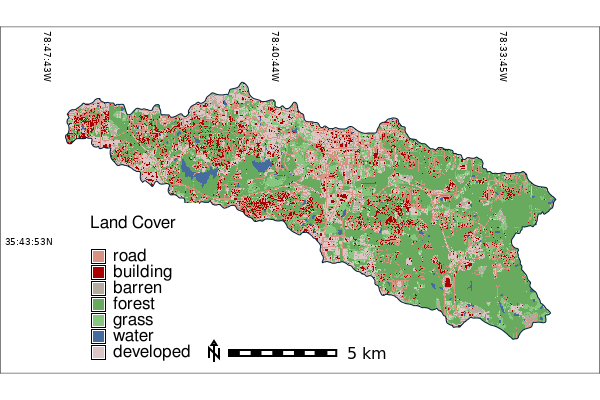

In [10]:
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
gs.run_command("g.region",
               raster="walnut_creek",
               res=3, flags="pa")

view_reg = gs.region("walnut_creek")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 3000
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 1500

gs.run_command("g.region",
               raster="walnut_creek",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               res=3, flags="pa")

classified_before_30m_map = gj.GrassRenderer(filename="output/classified_after_30m.png")
classified_before_30m_map.d_erase()
classified_before_30m_map.d_rast(map="classified_after_30m_recl")
classified_before_30m_map.d_vect(map="walnut_creek", fill_color="none")
classified_before_30m_map.d_legend(raster="classified_after_30m_recl", at=(7,40,15,20),title="Land Cover",title_fontsize=12,
                                fontsize=12, 
                                font="FreeSans", 
                                border_color="none",
                                bgcolor="white", 
                                flags="ncb")
classified_before_30m_map.d_barscale(at=(34,15.5), units="kilometers", flags="n", fontsize="16", length=5)
classified_before_30m_map.d_grid(size="00:06:59", flags="dw", width=1, color="black",text_color="black")
classified_before_30m_map.show()

{'0 road 18806058.000000 2089562 15.80%': None, '1 building 7173702.000000 797078 6.03%': None, '2 barren 3580362.000000 397818 3.01%': None, '3 forest 58360212.000000 6484468 49.02%': None, '4 grass 9974655.000000 1108295 8.38%': None, '5 water 2243916.000000 249324 1.88%': None, '6 developed 18908073.000000 2100897 15.88%': None}


<Figure size 1440x720 with 0 Axes>

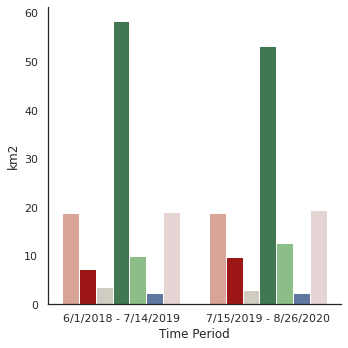

In [4495]:
# !r.stats -a -c -p -l -n input=classified_before_30m_recl
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt

before_class_stats = gs.parse_command("r.stats", input="classified_before_30m_recl", flags="acpln")
after_class_stats = gs.parse_command("r.stats", input="classified_after_30m_recl", flags="acpln")

landcover_dict = {"class":[] , "land cover":[], "m2":[], "cells":[], "percent":[], "Time Period":[] }
print(before_class_stats)
for k in before_class_stats.keys():
    row = k.split(" ") 
    row.append("6/1/2018 - 7/14/2019")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])

for k in after_class_stats.keys():
    row = k.split(" ")
    row.append("7/15/2019 - 8/26/2020")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])  

df_landcover = pd.DataFrame(landcover_dict)
df_landcover.head(10)
df_landcover['km2'] = df_landcover['m2'].apply(pd.to_numeric) / 1e6
landcover_color_palette = [
    'E29E8C', # Class 0 - road/highways         NLCD class color 22
    'B50000', # Class 1 - Building dark red     NLCD class color 24
    'D2CDC0', # Class 2 - barren                NLCD class color 31
    '38814E', # Class 3 - Forest                NLCD class color 42
    '85C77E', # Class 4 - Grass                 NLCD class color 41
    '5475A8', # Class 5 -  water                 NLCD class color 11
    'E8D1D1' # Class 5 -  developed             NLCD class color 21
]

fig = plt.figure(figsize=(20, 10))
sns.catplot(x="Time Period", 
            y="km2", 
            hue="land cover", 
            # orient="h",
            data=df_landcover,
            kind="bar", 
            legend_out=True,
            legend=False,
            palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))

plt.savefig("output/land_cover_change_chart.png",bbox_inches='tight', dpi=300)

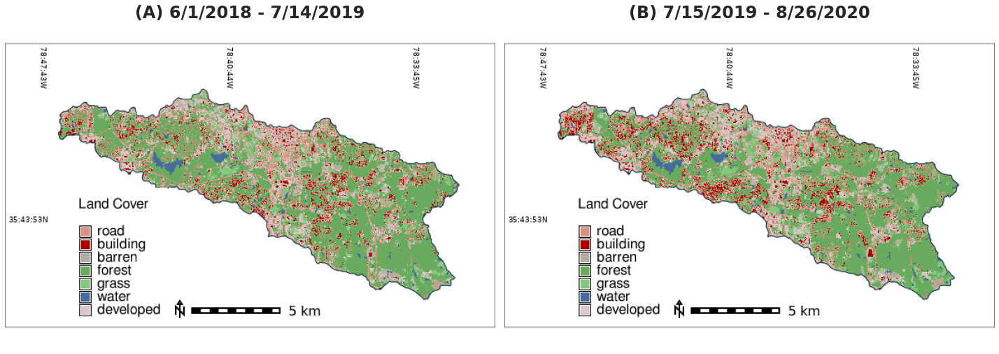

In [4525]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

# ax = fig.add_subplot(2, 1, 1)
# fig.subplots_adjust(hspace=0, wspace=0.1)

grs = fig.add_gridspec(1, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)

img1 = Image.open("output/classified_before_30m.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) 6/1/2018 - 7/14/2019',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0, 1])
ax2.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)

img1 = Image.open("output/classified_after_30m.png")
imgplot = plt.imshow(img1)
ax2.set_title('(B) 7/15/2019 - 8/26/2020',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/before_after_classified_fig.png",bbox_inches='tight', dpi=300)

In [505]:
df_landcover.head(10)

,class,land cover,m2,cells,percent,time,km2
0,0,road,18901800.000000,21002,15.88%,before,18.9018
1,1,building,7108200.000000,7898,5.97%,before,7.1082
2,2,barren,3573900.000000,3971,3.00%,before,3.5739
3,3,forest,58446000.000000,64940,49.09%,before,58.4460
4,4,grass,9894600.000000,10994,8.31%,before,9.8946
5,5,water,2238300.000000,2487,1.88%,before,2.2383
6,6,developed,18898200.000000,20998,15.87%,before,18.8982
7,0,road,18901800.000000,21002,15.88%,after,18.9018
8,1,building,9720900.000000,10801,8.17%,after,9.7209
9,2,barren,3014100.000000,3349,2.53%,after,3.0141


In [506]:
df_landcover_p = pd.pivot_table(df_landcover, values='km2', index=['land cover'], columns=['time'], aggfunc=np.sum) #.pct_change(axis='columns')
df_landcover_p['% change'] = df_landcover_p.apply(lambda r : ((r['after'] - r['before'])/r['before']) * 100, axis = 1)
df_landcover_p.reset_index().head()

time,land cover,after,before,% change
0,barren,3.0141,3.5739,-15.663561
1,building,9.7209,7.1082,36.756141
2,developed,19.3194,18.8982,2.228784
3,forest,53.2575,58.4460,-8.877425
4,grass,12.6090,9.8946,27.433145


Image Save Location: output/landcover_graph.png


<Figure size 864x432 with 0 Axes>

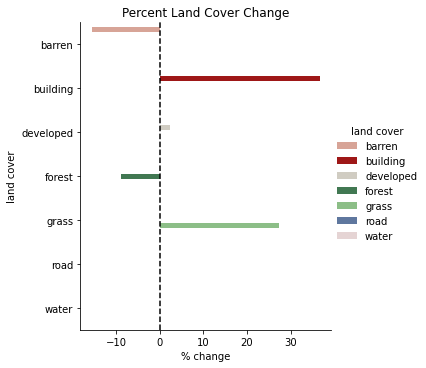

In [502]:
fig = plt.figure(figsize=(12, 6))
sns.catplot(y="land cover", x="% change", hue="land cover", data=df_landcover_p.reset_index(), kind="bar", palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))
plt.title("Percent Land Cover Change")
plt.axvline(0, 0,1, ls="--", color="black")
output = f"output/landcover_graph.png"
print(f"Image Save Location: {output}")
    
# plt.tight_layout()
plt.savefig(output,bbox_inches='tight')

In [438]:
!r.coin first=classified_before_30m_recl second=classified_after_30m_recl units=k
!r.stats -a -c -p -l -n input=classified_before_30m_recl,classified_after_30m_recl

Tabulating Coincidence between 'classified_before_30m_recl' and
'classified_after_30m_recl'
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100

+------------------------------------------------------------------------------+
|                        COINCIDENCE TABULATION REPORT                         |
|------------------------------------------------------------------------------|
| Location: nc_spm_08_gras  Mapset: rapid-dsm        Date: Thu Dec  2 13:10:36 |
|                                                                              |
| Layer 1: classified_befo-- Land Cover (Before)                               |
| Layer 2: classified_afte-- Land Cover (After)                                |
| Mask:    <MASK> in mapset <rapid-dsm>                                        |
|                                                                              |
| Units:   square kilometers         

# Priority Queue

## Priority Change (PC)

In [14]:
def priority_change_calc(before_landcover, after_landcover,output):
    """
    Generates the priority queue
    """

    
    change_priority = {
        "No Change": 0,
        "road to building": 7,#7,
        "road to barren": 4,
        "road to water": 0,
        "road to grass": 1,
        "road to forest": 1,
        "road to developed": 4,
        "building to road": 1,
        "building to barren": 7,
        "building to water": 0,
        "building to grass": 3,
        "building to forest": 3,
        "building to developed": 5,
        "barren to road": 3,
        "barren to building": 7,
        "barren to water": 0,
        "barren to grass": 2,
        "barren to forest": 2,
        "barren to developed": 5,
        "water to road": 0,
        "water to building": 0,
        "water to barren": 0,
        "water to grass": 0,
        "water to forest": 0,
        "water to developed": 0,
        "grass to road": 3,
        "grass to building": 7,
        "grass to barren": 3,
        "grass to water":0,
        "grass to forest": 3,
        "grass to developed": 5,
        "forest to road": 3,
        "forest to building": 7, #7,
        "forest to barren": 7,
        "forest to water": 0,
        "forest to grass": 3,
        "forest to developed": 7,
        "developed to road": 3,
        "developed to building": 7,
        "developed to barren": 7,
        "developed to water": 0,
        "developed to grass": 3,
        "developed to forest": 3
    }
    
    
    def expression_builder(from_val, to_val, priority):
            return f"if({before_landcover} == {from_val} && {after_landcover} == {to_val}, {priority}," # if({new_expression}))"
    
   
    class_list = range(0,7)
    classnames = ["road", "building", "barren", "forest", "grass", "water", "developed"]
    expression = ""
    closing = ""
    for from_class in class_list:
        for to_class in class_list:
            if from_class != to_class:
                change_key = f"{classnames[from_class]} to {classnames[to_class]}"
                change_value = change_priority[change_key]
                expression += expression_builder(from_class,to_class,change_value)
                closing += ")"
    expression+= "0"  
    expression+= closing
    tmp_output = "tmp_priority_change"
    gs.mapcalc(f"{tmp_output} = {expression}")
    gs.run_command("r.colors", map=tmp_output, color="plasma")
    gs.run_command("r.reclass",input=tmp_output, output=output, rules="grass_config/priority_reclass.txt", title="Priority Change")
    gs.run_command("g.remove", flags="f", type="raster", name=tmp_output, quiet=True)


In [5]:
gs.run_command("g.region", raster="classified_before_30m", res=30, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)

priority_change_calc(before_landcover="classified_before_30m_recl", after_landcover="classified_after_30m_recl",output="priority_change_30m")
priority_change_30m_map = gj.GrassRenderer(filename="output/priority_change.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="priority_change_30m")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="priority_change_30m", at=(2,40,2,6))
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

NameError: name 'priority_change_calc' is not defined

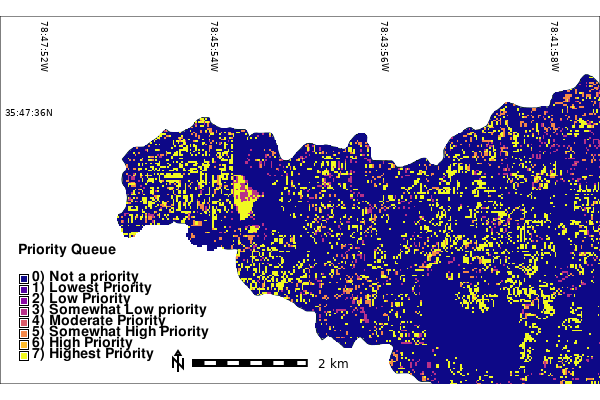

In [5083]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")





priority_change_30m_map = gj.GrassRenderer(filename="output/priority_change_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
priority_change_30m_map.d_legend(raster="priority_change_30m_reclass", at=(7,33,3,6),title="Priority Queue",title_fontsize=14,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white",flags="b" )
priority_change_30m_map.d_rast(map="priority_change_30m")

priority_change_30m_map.d_barscale(at=(28,13), units="kilometers", length=2, flags="n")

priority_change_30m_map.show()

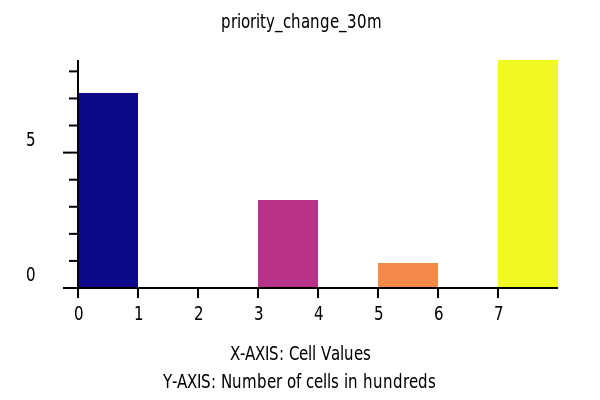

In [3873]:
gs.run_command("r.mask",raster="binary_change_objects",overwrite=True)
priority_change_30m_hist = gj.GrassRenderer()
priority_change_30m_hist.d_histogram(map="priority_change_30m")
priority_change_30m_hist.show()

### Mean Object Priority Change (MOPC)

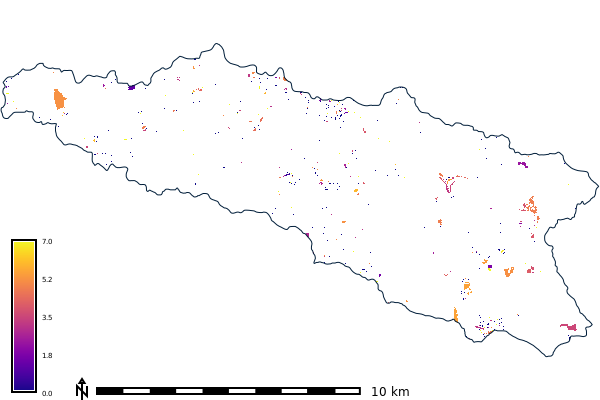

In [3874]:
gs.run_command("g.region", raster="classified_before_30m", res=30, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
gs.run_command("r.stats.zonal", base="binary_change_objects", cover="priority_change_30m", method="average", output="mopc", overwrite=True)
priority_change_30m_map = gj.GrassRenderer(filename="output/mopc.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="mopc")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="mopc", at=(2,40,2,6))
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

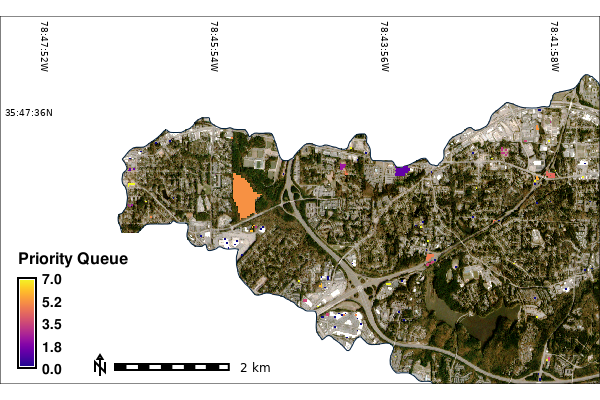

In [5089]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

priority_change_30m_map = gj.GrassRenderer(filename="output/mopc_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="mopc")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
priority_change_30m_map.d_legend(raster="mopc", at=(8,30.5,3,6),title="Priority Queue",title_fontsize=16,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white",flags="b" )
priority_change_30m_map.d_rast(map="mopc")

priority_change_30m_map.d_barscale(at=(15,12), units="kilometers", length=2, flags="n")
priority_change_30m_map.show()

In [3876]:
!r.univar mopc

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 303958
total null cells: 301983

Of the non-null cells:
----------------------
n: 1975
minimum: 0
maximum: 7
range: 7
mean: 3.70937
mean of absolute values: 3.70937
standard deviation: 2.0954
variance: 4.3907
variation coefficient: 56.4894 %
sum: 7326.00005888939


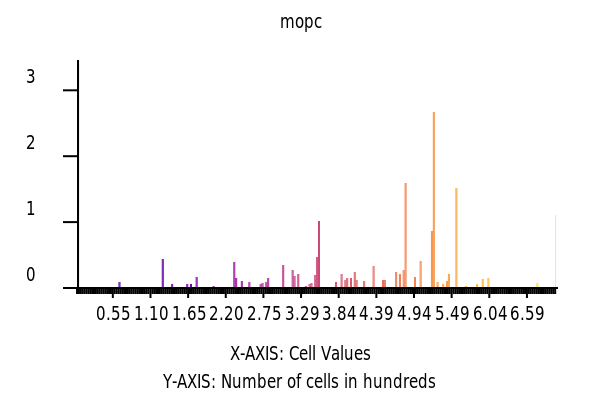

In [3878]:
mopc_hist = gj.GrassRenderer()
mopc_hist.d_histogram(map="mopc")
mopc_hist.show()

### Change Object Area (COA)

#### Object Size (OS)

First pass
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
Writing output map
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
Color table for raster map <object_size> set to 'gyr'


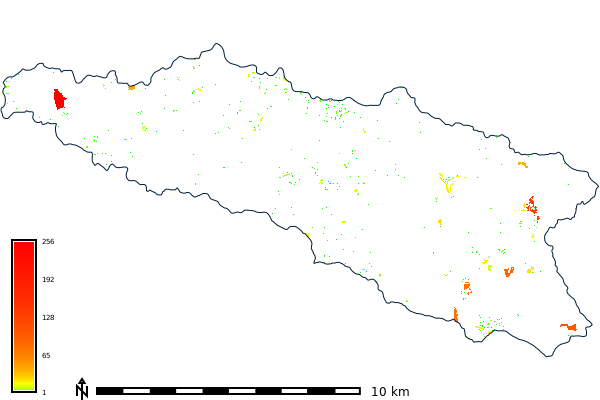

In [3879]:
gs.run_command("g.region", raster="classified_before_30m", res=30, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
!r.stats.zonal base=binary_change_objects cover=binary_change_mask method=count output=object_size --overwrite
!r.colors object_size color=gyr -g
priority_change_30m_map = gj.GrassRenderer(filename="output/object_size.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="object_size")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="object_size", at=(2,40,2,6))
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

#### Object Area (OA)

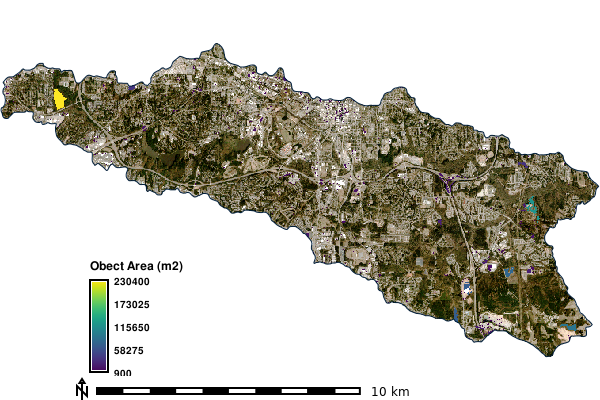

In [4574]:
gs.run_command("g.region", raster="classified_before_30m", res=30, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)

gs.mapcalc(f"object_pixel_area = object_size * 900") # 30m x 30m = 900m2 (OPA)
priority_change_30m_map = gj.GrassRenderer(filename="output/object_pixel_area.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="object_pixel_area")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="object_pixel_area", at=(7,30,15,18),title="Obect Area (m2)",title_fontsize=16,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white" )
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

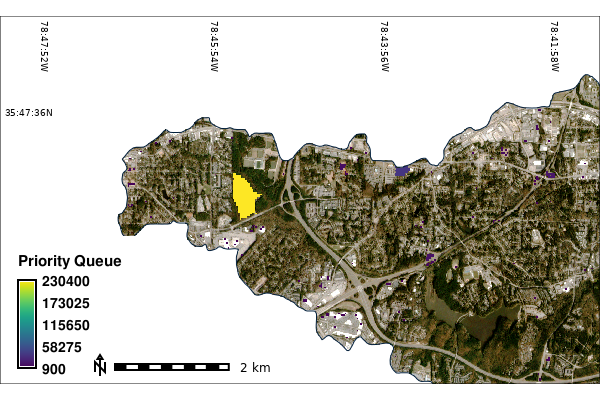

In [5093]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

priority_change_30m_map = gj.GrassRenderer(filename="output/object_pixel_area_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="object_pixel_area")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
priority_change_30m_map.d_legend(raster="object_pixel_area", at=(8,30,3,6),title="Priority Queue",title_fontsize=15,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white",flags="b" )
priority_change_30m_map.d_barscale(at=(15,12), units="kilometers", length=2, flags="n")
priority_change_30m_map.show()

### Priority Queue (PQ)

0.0
1197900.0
0.500000 rounded up to 0
0.690000 rounded up to 0
0.700000 rounded up to 0
0.890000 rounded up to 0
0.900000 rounded up to 0
1.090000 rounded up to 1
1.100000 rounded up to 1
1.290000 rounded up to 1
1.300000 rounded up to 1
1.500000 rounded up to 1
Color table for raster map <priority_queue_norm_recl> set to
'grass_config/priority_colors.txt'


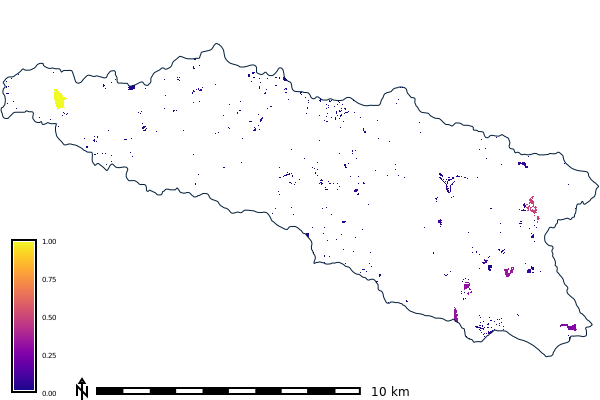

In [3885]:
gs.run_command("g.region", raster="object_pixel_area", res=30, flags="p")
gs.mapcalc(f"priority_queue = float(mopc) * float(object_pixel_area)")
univar = gs.parse_command("r.univar", map="priority_queue", flags="ge")
min_val = float(univar["min"])
print(min_val)
max_val = float(univar["max"])
print(max_val)
gs.run_command("r.mapcalc", 
               expression=f"priority_queue_norm = ((priority_queue - {min_val}) / ({max_val} - {min_val}))",
               overwrite=True)
!r.reclass input=priority_queue_norm output=priority_queue_norm_recl rules="grass_config/priority_reclass.txt" title="Priority Queue"
!r.colors map="priority_queue_norm_recl" rules="grass_config/priority_colors.txt"
priority_change_30m_map = gj.GrassRenderer(filename="output/priority_queue_norm.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_before_3m_comp")
priority_change_30m_map.d_rast(map="priority_queue_norm")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="priority_queue_norm", at=(2,40,2,6))
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

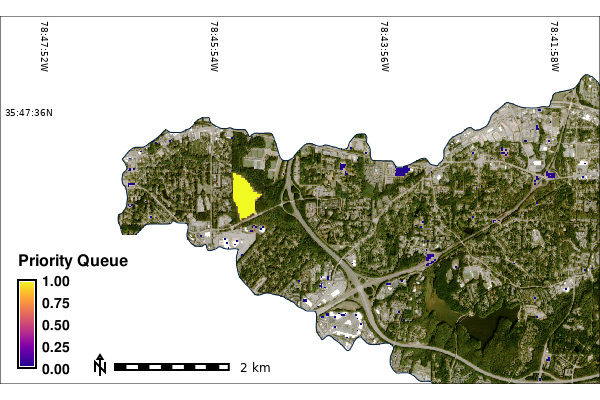

In [5094]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

priority_change_30m_map = gj.GrassRenderer(filename="output/priority_queue_norm_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_rast(map="priority_queue_norm")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
priority_change_30m_map.d_legend(raster="priority_queue_norm", at=(8,30,3,6),title="Priority Queue",title_fontsize=16,
                                fontsize=14, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white",flags="b" )
priority_change_30m_map.d_barscale(at=(15,12), units="kilometers", length=2, flags="n")
priority_change_30m_map.show()

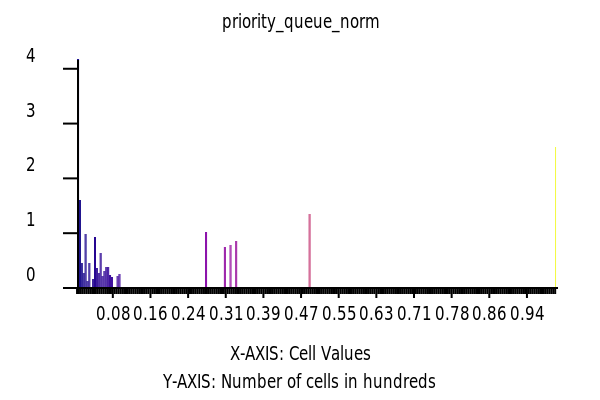

In [3887]:
gs.run_command("g.region", raster="classified_before_30m", res=30, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
priorityQueueMulti30m_hist = gj.GrassRenderer(filename="output/priority_queue_norm_hist.png")
priorityQueueMulti30m_hist.d_histogram(map="priority_queue_norm")
priorityQueueMulti30m_hist.show()

### Priority Queue Vector (PQV)

In [335]:
!r.fill.stats input=priority_queue_norm output=priority_queue_norm_filled uncertainty=uncertainty distance=4 mode=mode power=2.0 cells=5
!r.to.vect input=priority_queue_norm_filled output=priority_queue_norm type=area -vs # Do not overwrite this file it has the validation data
# Add and area field
!v.db.addcolumn map=priority_queue_norm columns="area double precision"
!v.to.db map=priority_queue_norm option=area columns=area
!v.colors map=priority_queue_norm use=attr column=value color=plasma

W-E size of neighborhood is 9 cells.
S-N size of neighborhood is 9 cells.
Input data range is 0.000000 to 1.000000.
Input data type is 'double' (8 bytes) and output data type is 'double' (8
bytes).
Minimal estimated memory usage is 0.120 MB.
Interpolating:
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
r.fill.stats complete. Processing time was 0h0m0s.
         written to the table.
WARNING: Vector map <priority_queue_norm> already exists and will be
         overwritten
Extracting areas...
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
Writing areas...
   0   4   8  12  16  20  24  28  32  36  40  44  48  52  56  60  64  68  72  76  80  84  88  92  96 100
Building topology for vector map <priority_queue_norm@rapid-dsm>...
Registering primitives...
Building areas...
   0   2   4   6   8  10  12  14  16

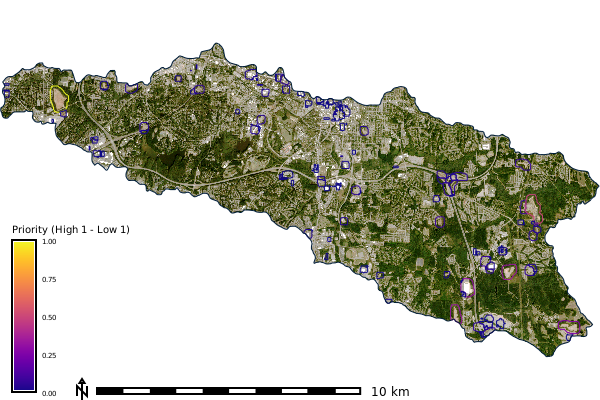

In [543]:
priority_change_30m_map = gj.GrassRenderer(filename="output/priority_queue_norm_vect.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_vect(map="priority_queue_norm", fill_color="none")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
# Change to d_thematic
priority_change_30m_map.d_legend(raster="priority_queue_norm", at=(2,40,2,6), title="Priority (High 1 - Low 1)", title_fontsize=10)
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

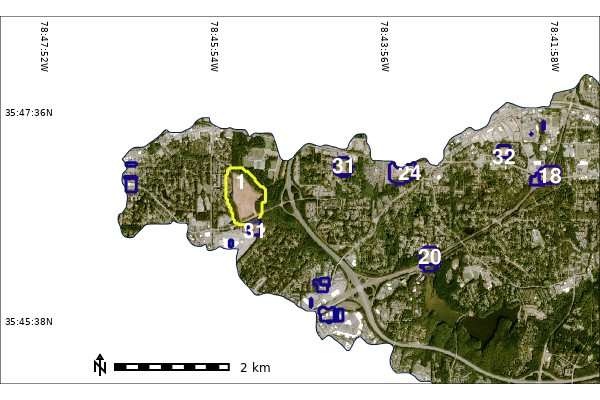

In [4585]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")
view_reg = gs.region("nw_one_third")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 2000
view_reg_e = view_reg['e'] + 1000
view_reg_s = view_reg['s'] - 500

gs.run_command("g.region",
               region="nw_one_third",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

priority_change_30m_map = gj.GrassRenderer(filename="output/priority_queue_norm_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_rast(map="priority_queue_norm")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_legend(raster="priority_queue_norm", at=(7,30,15,18),title="Priority Queue",title_fontsize=12,
                                fontsize=10, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white" )
priority_change_30m_map.d_barscale(at=(25,12), units="kilometers", length=2, flags="n")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=1, color="black",text_color="black")
# priority_change_30m_map.show()




priority_change_30m_map = gj.GrassRenderer(filename="output/priority_queue_norm_vect_nw.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_vect(map="priority_queue_norm", fill_color="none", width=3)
priority_change_30m_map.d_vect(map="priority_queue_clean_med",
                               fill_color="none", color="black",
                               attribute_column="rank", 
                               where="rank <= 100",
                               label_color="white", xref="center", yref="center",
                               label_size=21, font="FreeSans:Bold")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
# priority_change_30m_map.d_legend(raster="priority_queue_norm", at=(2,40,2,6), title="Priority (High 1 - Low 1)", title_fontsize=10)
priority_change_30m_map.d_barscale(at=(15,12), units="kilometers", length=2, flags="n")
priority_change_30m_map.d_grid(size="00:01:58", flags="dw", width=4, color="black",text_color="black")
priority_change_30m_map.show()

## Priority Queue Methods Figure

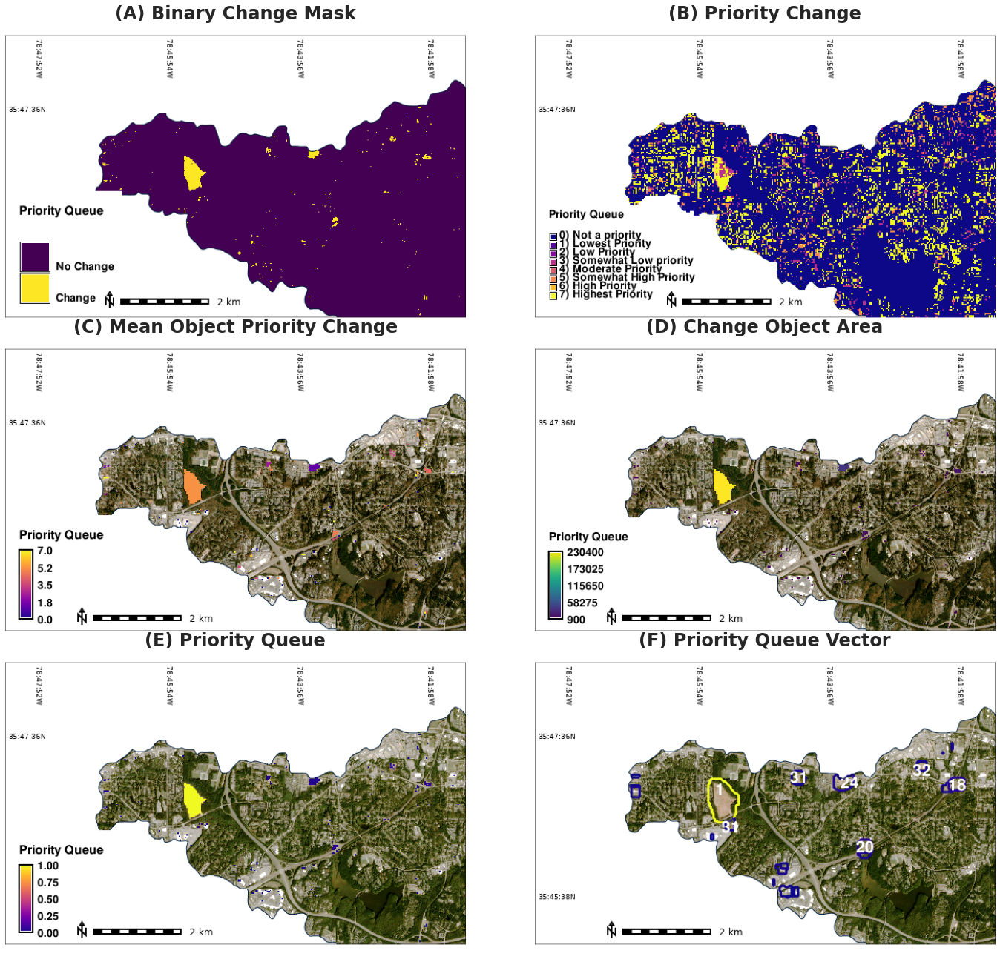

In [5095]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

grs = fig.add_gridspec(3, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)

img1 = Image.open("output/binary_change_mask_nw.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) Binary Change Mask',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0,1])
ax2.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)

img2 = Image.open("output/priority_change_nw.png")
imgplot = plt.imshow(img2)
ax2.set_title('(B) Priority Change',{"fontsize":24, "fontweight":"bold"})

ax3 = fig.add_subplot(grs[1,0])
ax3.axis('off')
fig.subplots_adjust(hspace=5, wspace=5)

img3 = Image.open("output/mopc_nw.png")
imgplot = plt.imshow(img3)
ax3.set_title('(C) Mean Object Priority Change',{"fontsize":24, "fontweight":"bold"})

# spans two rows:
ax4 = fig.add_subplot(grs[1, 1])
ax4.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)
img4 = Image.open("output/object_pixel_area_nw.png")
imgplot = plt.imshow(img4)
ax4.set_title('(D) Change Object Area',{"fontsize":24, "fontweight":"bold"})

ax5 = fig.add_subplot(grs[2, 0])
ax5.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)
img5 = Image.open("output/priority_queue_norm_nw.png")
imgplot = plt.imshow(img5)
ax5.set_title('(E) Priority Queue',{"fontsize":24, "fontweight":"bold"})

ax6 = fig.add_subplot(grs[2, 1])
ax6.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)
img6 = Image.open("output/priority_queue_norm_vect_nw.png")
imgplot = plt.imshow(img6)
ax6.set_title('(F) Priority Queue Vector',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/priority_queue_alg_figure1.png",bbox_inches='tight', dpi=300)

# Priority Context

In [ ]:
### Test to generate detailed land change transition map
def land_change_action(output):
    """
    X0 - primary class
    XF0 - New Feature
    X0F - Demolision
    X07 - Flooding
    X00F - Noise 
    
    10 - Roadway ( Base Class)
    20 - Building
    30 - Developed
    40 - Barren 
    50 - Grass
    60 - Forest
    70 - Water
    
    #
    0 - Static Feature
    1 - New Road
    2 - New Building
    3 - New Developed 
    4 - New Pond
    5 - Dug Up Road Road
    6 - Demolished Building
    7 - Demolished Developed
    8 - Forest Clearing
    """
   
    land_use_change = {
        ### Base Classes
        "road to road": {"class": 10, "label": "Roadway", "color":"217:146:130","action":"","priority": 0},
        "building to building": {"class": 20, "label": "Building", "color":"171:0:0","action":"","priority": 0}, # 7 # Building
        "developed to developed": {"class": 30, "label": "Developed", "color":"222:197:197","action":"","priority": 0}, # Developed
        "barren to barren": {"class": 40, "label": "Barren","color":"179:172:159","action":"","priority": 0}, # Barren
        "grass to grass": {"class": 50, "label": "Grass","color":"133:199:126","action":"","priority": 0}, # Grass
        "forest to forest":{"class": 60, "label": "Forest","color":"104:171:95","action":"","priority": 0}, # Forest
        "water to water": {"class": 70, "label": "Water","color":"70:107:159","action":"","priority": 0},
        
        # Added Features
        
        # New Road (Purple)
        "developed to road": {"class": 310, "label": "New Road", "color":"45:0:75", "action": 1, "priority": 3}, # New Road
        "barren to road": {"class": 410, "label": "New Road", "color": "45:0:75", "action": 1, "priority": 3}, # New Roadway
        
        # New Building (Teal)
        "developed to building": {"class": 320, "label": "New Building", "color":"1:102:94", "action": 2, "priority": 7}, # New Building
        "barren to building": {"class": 420, "label": "New Building","color": "1:102:94", "action": 2, "priority": 7}, # New Building
        "grass to building": {"class": 520, "label": "New Building", "color":"1:102:94", "action": 2, "priority": 7}, # New Building
       
        # New Developed Area (Light Purple
        "barren to developed": {"class": 430,"label": "New Developed Area", "color":"128:115:172", "action": 3, "priority": 5}, # New Developed Area
        "grass to developed": {"class": 530, "label": "New Developed Area", "color":"128:115:172", "action": 3, "priority": 5}, # New Developed Area (Grass to Developed)

        # New Pond (Light Blue)
        "barren to water": {"class": 470, "label": "New Pond/Flooding", "color":"166:206:227", "action": 4, "priority": 0}, # New Pond/Flooding
        
        
        ### Removed Features ()
        "road to barren": {"class": 104, "label": "Dug Up Roadway", "color":"179:88:6", "action": 5, "priority":4}, # Dark Orange Brown
        "building to barren": {"class": 204, "label": "Demolished Building", "color": "224:130:20", "action": 6, "priority": 7}, # Orange Brown
        "developed to barren": {"class": 304, "label": "Demolished Developed", "color":"253:184:99", "action": 7, "priority": 7}, # Light Orange Brown
        "forest to developed": {"class": 630, "label": "Forest Clearing", "color":"197:27:125", "action": 8, "priority": 7}, # Dark Pink
        "forest to barren": {"class": 640, "label": "Forest Clearing", "color":"197:27:125","action":8, "priority": 7}, # (Seasonal forest to Road)
        
        # Flooded Features
        "road to water": {"class": 107, "label": "Flooded Roadway", "color":"","action":"", "priority":0}, # 
        "building to water": {"class": 207, "label": "Flooded Building", "color":"","action":"", "priority": 0}, # 10, # 
        "developed to water": {"class": 307, "label": "Flooded Developed", "color":"","action":"", "priority": 0}, # Flooding
        "grass to water":{"class": 507, "label": "Flooded Field", "color":"","action":"", "priority": 0},# Flooded Field
  
        #Noise
        "road to building": {"class": 1002, "label": "Noise (Roadway to Building)", "color":"", "action": "","priority":1}, # High Priority queue (7)...same not sure why this is a 7
        "road to grass": {"class": 1005, "label": "Noise (Road to Grass)", "color":"","action":"","priority":1},  
        "road to forest": {"class": 1006, "label": "Noise (Road to Forest)", "color":"","action":"", "priority":1},
        "road to developed": {"class": 1003, "label": "Noise (Road to Developed)", "color":"","action":"", "priority": 4},
           
        "building to road": {"class": 20001, "label": "Noise (Building to Road)", "color":"","action":"", "priority":1}, 
        "building to forest": {"class": 2002, "label": "Noise (Building to Forest)", "color":"","action":"", "priority": 3},  
        "building to developed": {"class": 2003, "label": "Noise (Building to Developed)", "color":"","action":"", "priority": 5},  
        "building to grass": {"class": 2005, "label": "Noise (Building to Grass)", "color":"","action":"", "priority": 3}, 
        
        "developed to grass": {"class": 3005, "label": "Noise ( Developed to Grass)", "color":"","action":"","priority": 3}, # Reclaimed Grass
        "developed to forest": {"class": 3006, "label": "Noise (Developed to Forest)", "color":"","action":"","priority": 3}, # Reclaimed Forest
        
        "barren to grass": {"class": 4005, "label": "Noise (Barren to Grass)", "color":"","action":"", "priority": 2}, 
        "barren to forest": {"class": 4006, "label": "Noise (Barren to Forest)", "color":"","action":"", "priority": 2},
        
        "grass to road": {"class": 5001, "label": " Noise (Grass to Road)", "color":"","action":"", "priority": 3}, 
        "grass to barren": {"class": 5004, "label": " Noise (Field/Barren)", "color":"","action":"", "priority": 3}, 
        "grass to forest": {"class": 5006, "label": "Noise (Grass to Forest)", "color":"","action":"", "priority": 3}, 
        
        "forest to road": {"class": 6001, "label": "Nosie (Seasonal forest to Road)", "color":"","action":"","priority": 3}, 
        "forest to building": {"class": 6002, "label": "Nosie (Seasonal forest to Road)", "color":"", "action": "", "priority": 1}, # I dont know why I made this a 7,might be an error..
       
        "forest to grass": {"class": 6005, "label": "Noise (Forest to Grass)", "color":"","action":"","priority": 3}, 
        "forest to water": {"class": 6007, "label": "Noise (Forest to Water)", "color":"","action":"", "priority": 0},
       
        "water to road": {"class": 7001, "label": "Noise (Water to Road)", "color":"","action":"", "priority": 0},  
        "water to building": {"class": 7002, "label": "Noise (Water to Building)", "color":"","action":"", "priority": 0},  
        "water to developed": {"class": 7003, "label": "Noise (Water to Developed)", "color":"","action":"", "priority": 0},  
        "water to barren": {"class": 7004, "label": "Noise (Water to Barren)", "color":"","action":"", "priority": 0}, 
        "water to grass": {"class": 7005, "label": "Noise (Water to Grass)", "color":"","action":"", "priority": 0},  
        "water to forest": {"class": 7006, "label": "Noise (Water to Forest)", "color":"","action":"", "priority": 0},  
        
        
    }
    
    # Create Color Table
    with open("grass_config/land_change_action_colors.txt","w") as f:
        for k, feature in land_use_change.items():
            klass = feature['class']
            kolor = feature['color']
            if kolor != "":
                print(f"{klass} {kolor}", file=f)  
                
        print("nv 255:255:255", file=f)
        print("default 255:255:255", file=f)
        
    # Create Reclass Tabel
    with open("grass_config/land_change_reclass.txt","w") as f:
        for k, feature in land_use_change.items():
            klass = feature['class']
            label = feature['label']
            if klass and label != "":
                print(f"{klass} = {klass} {label}", file=f)  
                
        print("* = NULL", file=f)
    
    # Create Reclass Tabel
    with open("grass_config/land_change_action_reclass.txt","w") as f:
        for k, feature in land_use_change.items():
            klass = feature['class']
            aklass = feature['action']
            label = feature['label']
            if klass and aklass and label != "":
                print(f"{klass} = {aklass} {label}", file=f)  
                
        print("* = NULL", file=f)
        
    with open("grass_config/land_change_basic_action_colors.txt","w") as f:
        for k, feature in land_use_change.items():
            klass = feature['action']
            kolor = feature['color']
            if kolor and klass != "":
                print(f"{klass} {kolor}", file=f)  
                
        print("nv 255:255:255", file=f)
        print("default 255:255:255", file=f)
        
    with open("grass_config/land_change_zonal_action_reclass.txt","w") as f:
        for k, feature in land_use_change.items():
            klass = feature['class']
            aklass = feature['action']
            label = feature['label']
            if klass and aklass and label != "":
                print(f"{aklass} = {aklass} {label}", file=f)  
                
        print("* = NULL", file=f)
    
    
    def expression_builder(from_val, to_val, priority):
            return f"if(classified_before_30m_recl == {from_val} && classified_after_30m_recl == {to_val}, {priority}," # if({new_expression}))"
    
   
    class_list = range(0,7)
    classnames = ["road", "building", "barren", "forest", "grass", "water", "developed"]
    expression = ""
    closing = ""
    for from_class in class_list:
        for to_class in class_list:
            k = f"{from_class} to {to_class}"
            change_key = f"{classnames[from_class]} to {classnames[to_class]}"
            change_dict = land_use_change[change_key]
            change_value = change_dict['class']
            expression += expression_builder(from_class,to_class,change_value)
            closing += ")"
    expression+= "0"         
    expression+= closing
    
    # for k, v in land_use_change.items():
        
    # print(expression)
    gs.mapcalc(f"{output} = {expression}")
    gs.run_command("r.reclass", input=output, rules="grass_config/land_change_reclass.txt", title="Land Change Classes",output="land_change_30m")
    gs.run_command("r.colors", map="land_change_30m", rules="grass_config/land_change_action_colors.txt")
    
    gs.run_command("r.reclass", input=output, rules="grass_config/land_change_action_reclass.txt", title="Land Change Actions",output="land_change_basic_actions_30m")
    gs.run_command("r.colors", map="land_change_basic_actions_30m", rules="grass_config/land_change_basic_action_colors.txt")

    
gs.run_command("g.region", raster="classified_before_30m", res=3, flags="pa")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
land_change_action("land_change_action_30m")


In [ ]:
gs.run_command("g.region", region="nw_one_third", res=3, flags="pa")

priority_change_30m_map = gj.GrassRenderer(filename="output/land_change_action_30m.png")
priority_change_30m_map.d_erase()
priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_rast(map="land_change_30m")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_vect(map="priority_queue_clean_med", fill_color="none")

priority_change_30m_map.d_legend(raster="land_change_30m", at=(2,40,2,6), flags="ncd")
priority_change_30m_map.d_barscale(at=(12,6,12,10), units="kilometers", flags="n")
priority_change_30m_map.show()

In [ ]:
gs.run_command("g.region", raster="ps_after_3m_comp", res=3, flags="pa")
!v.to.rast input=priority_queue_norm output=priority_queue_int_mask use=cat memory=3000
# v.to.rast input=priority_queue_clean_med@rapid-dsm output=priority_queue_clean_med use=cat memory=3000
# gs.run_command("r.mask",vector="priority_queue_norm",overwrite=True)
!v.to.rast input=priority_queue_clean_med output=priority_queue_clean_med use=cat memory=3000 --overwrite
# gs.run_command("r.mask",raster="priority_queue_clean_med",overwrite=True)
gs.run_command("r.neighbors",input="land_change_basic_actions_30m",
               method="mode,diversity,count",
               size=15,
               selection="priority_queue_norm",
               output="priority_queue_context_mode,priority_queue_context_diversity,priority_queue_context_count", overwrite=True)
gs.run_command("r.reclass", input="priority_queue_context_mode", rules="grass_config/land_change_zonal_action_reclass.txt", title="Land Change Actions",output="priority_queue_context_mode_reclass")

gs.run_command("r.mode",
               base="priority_queue_clean_med",
               # base="priority_queue_int_mask",
               cover="priority_queue_context_mode",
               output="priority_queue_context_zonal", overwrite=True)
gs.run_command("r.reclass", input="priority_queue_context_zonal", rules="grass_config/land_change_zonal_action_reclass.txt", title="Land Change Actions",output="priority_queue_context")
# gs.run_command("r.colors", map="priority_queue_context", raster="land_change_basic_actions_30m")

In [ ]:
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
gs.run_command("g.region",
               raster="walnut_creek",
               # region="nw_one_third",
               res=3, flags="pa")

view_reg = gs.region("walnut_creek")
view_reg_n = view_reg['n'] + 1500
view_reg_w = view_reg['w'] - 1500
gs.run_command("g.region",
               raster="walnut_creek",
               n=view_reg_n,
               w=view_reg_w,
               res=3, flags="pa")
priority_change_30m_map = gj.GrassRenderer(height=900, width=1400,filename="output/land_change_basic_actions_30m.png")
priority_change_30m_map.d_erase()

priority_change_30m_map.d_rast(map="ps_after_3m_comp")
priority_change_30m_map.d_rast(map="priority_queue_context")
priority_change_30m_map.d_vect(map="walnut_creek", fill_color="none")
priority_change_30m_map.d_vect(map="priority_queue_clean_med",
                               fill_color="none", color="black",
                               attribute_column="rank", 
                               where="rank <= 10",
                               label_color="white", xref="center", yref="center",
                               label_size=20, font="FreeSans:Bold")

priority_change_30m_map.d_legend(raster="priority_queue_context", at=(10,30,9,50),title="Priority Context",title_fontsize=20, use=[2,3,7,8],
                                fontsize=16, 
                                font="FreeSans:Bold", 
                                border_color="none",
                                bgcolor="white", 
                                flags="ncb")
priority_change_30m_map.d_barscale(at=(26,13.5), units="kilometers", flags="n", fontsize="16")
priority_change_30m_map.d_grid(size="00:03:58", flags="dw", width=1, color="black",text_color="black")

priority_change_30m_map.show()

## Priority Context with Rank

In [ ]:
!v.to.rast input=priority_queue_clean_med output=priority_queue_clean_med use=cat memory=3000 label_column=value --overwrite


In [ ]:
gs.run_command("g.region", raster="ps_after_3m_comp", res=3, flags="pa")

priority_change_context = gs.parse_command("r.stats", 
                                           input="priority_queue_clean_med,priority_queue_context",#,priority_queue_context_mode_reclass", 
                                           flags="acpln", separator="|")
landcover_change_dict = {
    # "east":[],"north":[],
    "ObjectId":[], "Priority Value":[],"Action Class":[],"Action":[],
    # "Mode Action Class":[],"Mode Action":[],
    "m2":[], "cells":[], "percent":[] }
for k in priority_change_context.keys():
    row = k.split("|") 
    # print(row)
    for i, col in enumerate(landcover_change_dict.keys()):
        landcover_change_dict[col].append(row[i])

# landcover_change_dict["Priority Value"] = [round(float(value.split("-")[1]),3) for value in landcover_change_dict["Priority Value"]]
df_landcover_change = pd.DataFrame(landcover_change_dict)

df_landcover_change['km2'] = df_landcover_change['m2'].apply(pd.to_numeric) / 1e6
df_landcover_change['rank'] = df_landcover_change['Priority Value'].rank(ascending=False, method="dense")

df_landcover_change = df_landcover_change.sort_values(by="Priority Value",ascending=False)
df_landcover_change.head(10)



In [ ]:
# gs.run_command("v.db.addcolumn", map="priority_queue_clean_med", columns="rank double precision")
for index, row in df_landcover_change.iterrows():
    # print(row["ObjectId"], row["rank"])
    query = f'cat = {row["ObjectId"]}'
    # I'm sure there is a better way to do this but this will work for now
    gs.run_command("v.db.update", map="priority_queue_clean_med", column="rank", qcol=row["rank"], where=query)

# gs.run_command("db.execute", sql=f"UPDATE priority_queue_clean_med SET rank={} WHERE cat is {}")

In [ ]:
df_landcover_change.groupby(by=["Action"]).describe()

In [ ]:
sns.scatterplot(x="rank", y="km2", hue="Action", data=df_landcover_change)

# Generate Elevation Figures Functions

In [4739]:
def shadedRelief(elevation, relief, output, shade_only=False):
    """
    Add shaded releif elevation data
    @param elevation : string : Name of existing elevation raster
    @param relief : string : Name of newly created relief raster
    @param output : string: Name of shaded relief raster
    @param shade_only : Bool : Applied shading to exisiting releif map where elevation works as a color
    """
    if shade_only:
        gs.run_command("r.shade", shade=relief, color=elevation, output=output, overwrite=True)
    else:
        gs.run_command("r.relief", input=elevation, output=relief, overwrite=True)
        gs.run_command("r.shade", shade=relief, color=elevation, output=output, overwrite=True)
        
def generate_elevation_figure(elev, filename):
    """
    Generates a shade png image of an elevation (DTM, DSM)
    @param elev : string : Name of raster
    @param filename: string: Name of file
    """
    relief = f"{elev}_relief"
    shaded_relief = f"{elev}_shaded_relief"
    # shadedRelief(elevation=elev,relief=relief, output=shaded_relief)
    output = f"output/{filename}.png"
    print(f"Image Save Location: {output}")
    elev_map = gj.GrassRenderer(height=900, width=1400, filename=output)
    elev_map.d_erase()
    elev_map.d_rast(map=shaded_relief)
    # elev_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width="1", legend_label="Fenton (White Area)")
    elev_map.d_legend(raster=elev, at=(14,50,10,12), title="Elevation (m)",font="FreeSans", title_fontsize=18, fontsize=16, flags="tb", border_color='none')
    elev_map.d_barscale(at=(8,10,10,12), units="meters", flags="n",font="FreeSans", fontsize=24)
    elev_map.d_grid(size="00:58:40", flags="dw", width=1, color="black",text_color="black")

    return elev_map.show()

def generate_ortho_figure(ortho, filename):
    output = f"output/{filename}.png"
    print(f"Image Save Location: {output}")
    ortho_composite_map = gj.GrassRenderer(height=900, width=900,filename=output)
    ortho_composite_map.d_erase()
    ortho_composite_map.d_rast(map=ortho)
    # ortho_composite_map.d_barscale(at=(1,6,2,2), units="meters", flags="n",font="FreeSans",fontsize=24)
    ortho_composite_map.d_barscale(at=(16,7), units="meters", flags="n",font="FreeSans", fontsize=24)
    ortho_composite_map.d_grid(size="00:0:56", flags="dw", width=1, color="black",text_color="black",fontsize=12)
    return ortho_composite_map.show()

def generate_uas_footprint(elev, output, overwrite=False):
    """
    Creates a footprint of the UAS flight area
    """
    gs.mapcalc(f"{output} = if(isnull({elev}), null(), 1)")
    gs.run_command("r.to.vect", input=output, output=output, type="area", overwrite=overwrite)
    
    

# View NED 1/9 sec (3m) DEM data from USGS

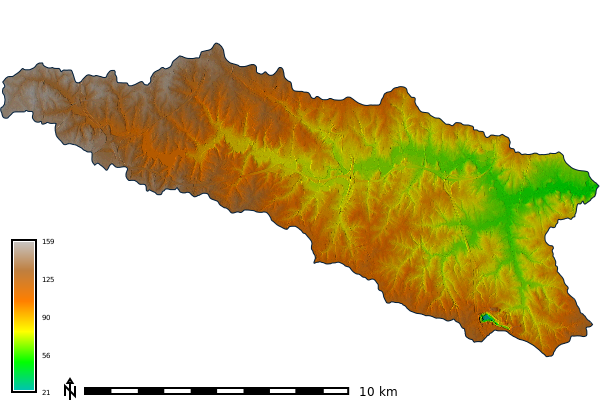

In [24]:
gs.parse_command("g.region", raster="ned_19sec", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
ned_19sec_map = gj.GrassRenderer(filename="output/ned_19sec_shaded_relief.png")
ned_19sec_map.d_rast(map="ned_19sec_shaded_relief")
ned_19sec_map.d_vect(map="walnut_creek", fill_color="none")
ned_19sec_map.d_legend(raster="ned_19sec", at=(2,40,2,6))
ned_19sec_map.d_barscale(at=(10,6,10,10), units="kilometers", flags="n")
ned_19sec_map.show()

# Import UAS Data

In [184]:
def import_uas_data(dtm_input, dtm_output, dsm_input, dsm_output, ortho_input, ortho_output, ortho_composite, laz_input, laz_output, laz_dsm, res=0.5, memory=300, nprocs=1, overwrite=False):
    """
    Imports DSM, DTM, Ortho, and point cloud data exported from WebDOM into GRASS GIS.
    @param dtm_input : string : file location (.tif)
    @param dtm_output : string : Output file name
    @param dsm_input : string : file location (.tif)
    @param dsm_output : string : Output file name
    @param ortho_input : string : file location (.tif)
    @param ortho_output : string : Output file name
    @param ortho_composite: string :  Output file name of composite image
    @param laz_input : string : file location (.laz)
    @param laz_output : string : Output file name
    @param laz_dsm : Output file name of point cloud derived DSM
    @param laz_be_pc : DOES NOT WORK Output file name of bare earth point cloud
    @param laz_dem : DOES NOT WORK Output file name of point cloud derived DEM
    @param res : The the import resolution (Dfault = 0.5)
    @param memory : Allocate memeory for import steps (Default = 300) 
    @param nprocs : Allocate total processes used during interpolation (Default = 1) 
    @param overwrite : Overwrite existing files (Default = False)
    
    """
    print("*" * 100)
    print("Starting UAS Import")
    print(f"Setting Region with {res} resolution")
    gs.run_command("g.region", res=res, flags="ap")
    
    print(f"Importing DTM: {dtm_output}")

    gs.run_command("r.import",
                   input=dtm_input, 
                   memory=memory,
                   output=dtm_output,
                   resample="bilinear",
                   overwrite=overwrite
                  )
    gs.run_command("r.colors", map=dtm_output, color="elevation", flags="e")


    print(f"Importing DSM: {dsm_output}")
    gs.run_command("r.import",
                   input=dsm_input, 
                   memory=memory,
                   output=dsm_output,
                   resample="bilinear",
                   overwrite=overwrite
                  )

    print(f"Importing Ortho: {ortho_output}")
    gs.run_command("r.import",
                   input=ortho_input, 
                   memory=memory,
                   output=ortho_output,
                   resample="nearest",
                   overwrite=overwrite
                  )

    print(f"Creating Ortho: {ortho_composite}")
    gs.run_command("g.region", raster=f"{ortho_output}.1", res=res, flags="ap")

    gs.run_command("r.composite",
                red=f"{ortho_output}.1",
                green=f"{ortho_output}.2",
                blue=f"{ortho_output}.3",
                output=ortho_composite,
                overwrite=overwrite
            )
    
    print(f"Importing Point Cloud (DSM): {laz_output}")
    gs.run_command("v.in.pdal",
                 input=laz_input,
                 output=laz_output,
                 flags="w",
                 # input_srs="EPSG:4326",
                 overwrite=overwrite
              )
    # Set  computaional region to imported raster data
    gs.run_command("g.region", raster=ortho_composite, res=res, flags="ap")
    
    print(f"Generating DSM: {laz_output}")
    gs.run_command("v.surf.rst",
                 input=laz_output,
                 elevation=laz_dsm,
                 npmin=120,
                 segmax=25,
                 tension=100,
                 smooth=0.5,
                 dmin=1,
                 mask=ortho_composite,
                 nprocs=nprocs,
                 overwrite=overwrite
              )
    
    print("Import Complete")
    print("*" * 100)
    
def resample_uas_data(dtm, dtm_output, dsm, dsm_output, ortho, ortho_output, res, overwrite=False):
    """
    Resamples UAS data into another resolution
    """
    # Resample DTM
    gs.run_command("g.region", raster=dtm, res=res, flags="ap")
    gs.run_command("r.resamp.interp", input=dtm, output=dtm_output, overwrite=overwrite)
    # Resample DSM
    gs.run_command("g.region", raster=dsm, res=res, flags="ap")
    gs.run_command("r.resamp.interp", input=dsm, output=dsm_output, overwrite=overwrite)
    # Resample Ortho
    gs.run_command("g.region", raster=ortho, res=3, flags="ap")
    gs.run_command("r.resamp.interp", input=ortho, output=ortho_output, method="nearest", overwrite=True)
    # Set DTM an DSM color tables
    gs.run_command("r.colors", map=f"{dtm_output},{dsm_output}", color="elevation", flags="e")
    

## Site 1 - Nov 23, 2021

### Import 15cm Data

In [ ]:
import_uas_data(
    dtm_input="data/cary_town_blvd_flight_1/odm_dtm.tif",
    dtm_output="cary_town_blvd_flight_1_odm_dtm_05m",
    dsm_input="data/cary_town_blvd_flight_1/odm_dsm.tif",
    dsm_output="cary_town_blvd_flight_1_odm_dsm_05m",
    ortho_input="data/cary_town_blvd_flight_1/odm_orthophoto.tif",
    ortho_output="cary_town_blvd_flight_1_odm_ortho_05m",
    ortho_composite="cary_town_blvd_flight_1_odm_ortho_composite_05m",
    laz_input="data/cary_town_blvd_flight_1/odm_georeferenced_model.laz", 
    laz_output="cary_town_blvd_flight_1_odm_pc",
    laz_dsm="cary_town_blvd_flight_1_pc_dsm_05m",
    res=0.5,
    memory=3000, 
    nprocs=10,
    overwrite=True
)

****************************************************************************************************
Starting UAS Import
Setting Region with 0.5 resolution
Importing DTM: cary_town_blvd_flight_1_odm_dtm_05m
Importing DSM: cary_town_blvd_flight_1_odm_dsm_05m
Importing Ortho: cary_town_blvd_flight_1_odm_ortho_05m
Creating Ortho: cary_town_blvd_flight_1_odm_ortho_composite_05m
Importing Point Cloud (DSM): cary_town_blvd_flight_1_odm_pc
Generating DSM: cary_town_blvd_flight_1_odm_pc
Import Complete
****************************************************************************************************


### Resample DTM Data to 3m for fusion

In [680]:
resample_uas_data(
    dtm="cary_town_blvd_flight_1_odm_dtm_05m", 
    dtm_output="cary_town_blvd_flight_1_odm_dtm_3m", 
    dsm="cary_town_blvd_flight_1_odm_dsm_05m",
    dsm_output="cary_town_blvd_flight_1_odm_dsm_3m", 
    ortho="cary_town_blvd_flight_1_odm_ortho_composite_05m", 
    ortho_output="cary_town_blvd_flight_1_odm_ortho_composite_3m", 
    res=3, overwrite=True)

## View the USA Data

### 3m Resolution

#### Ortho 3m

Image Save Location: output/cary_town_blvd_flight_1_odm_ortho_composite_3m.png


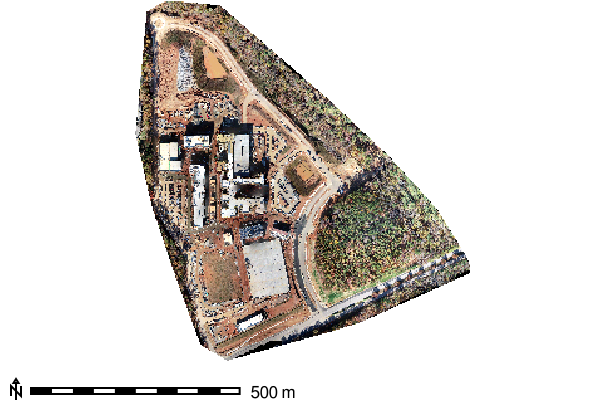

In [223]:
gs.run_command("g.region", raster="cary_town_blvd_flight_1_odm_ortho_composite_3m", res=3, flags="ap")
gs.run_command("r.mask",vector="cary_town_blvd_flight_1_odm_footprint",overwrite=True)
view_reg_e = view_reg['e'] - 20
view_reg_s = view_reg['s'] - 80
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_ortho_composite_3m", e=view_reg_e,s=view_reg_s, res=3, flags="pa")

rd.generate_ortho_figure(ortho="cary_town_blvd_flight_1_odm_ortho_composite_3m", filename="cary_town_blvd_flight_1_odm_ortho_composite_3m")

#### DTM 3m

In [3579]:
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dtm_3m", res=3, flags="pa")
view_reg = gs.region("cary_town_blvd_flight_1_odm_dtm_3m")
view_reg_e = view_reg['e'] - 20
view_reg_s = view_reg['s'] - 80
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dtm_3m", e=view_reg_e,s=view_reg_s, res=3, flags="pa")

gs.run_command("r.mask",raster="cary_town_blvd_flight_1_odm_dtm_3m",overwrite=True)
rd.generate_elevation_figure(elev="cary_town_blvd_flight_1_odm_dtm_3m", filename="cary_town_blvd_flight_1_odm_dtm_3m_shaded_relief")

#### DSM 3m

Image Save Location: output/cary_town_blvd_flight_1_odm_dsm_3m_shaded_relief.png


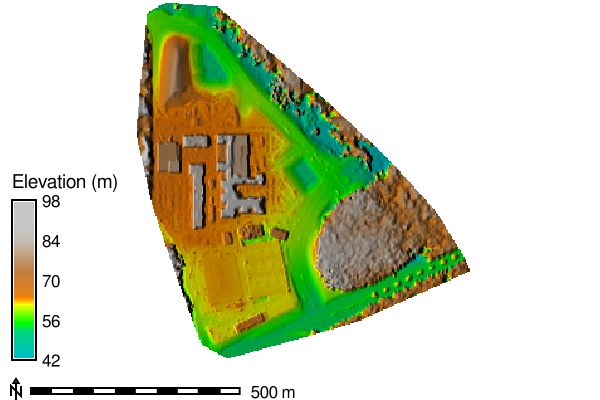

In [227]:
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dsm_3m", res=3, flags="pa")
view_reg = gs.region("cary_town_blvd_flight_1_odm_dsm_3m")
view_reg_e = view_reg['e'] - 20
view_reg_s = view_reg['s'] - 80
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dsm_3m", e=view_reg_e,s=view_reg_s, res=3, flags="pa")

gs.run_command("r.mask",raster="cary_town_blvd_flight_1_odm_dsm_3m",overwrite=True)
rd.generate_elevation_figure(elev="cary_town_blvd_flight_1_odm_dsm_3m", filename="cary_town_blvd_flight_1_odm_dsm_3m_shaded_relief")

### 15cm Resolution

#### Figure: DSM 15cm

Image Save Location: output/fenton_odm_dsm_5cm_shaded_relief.png


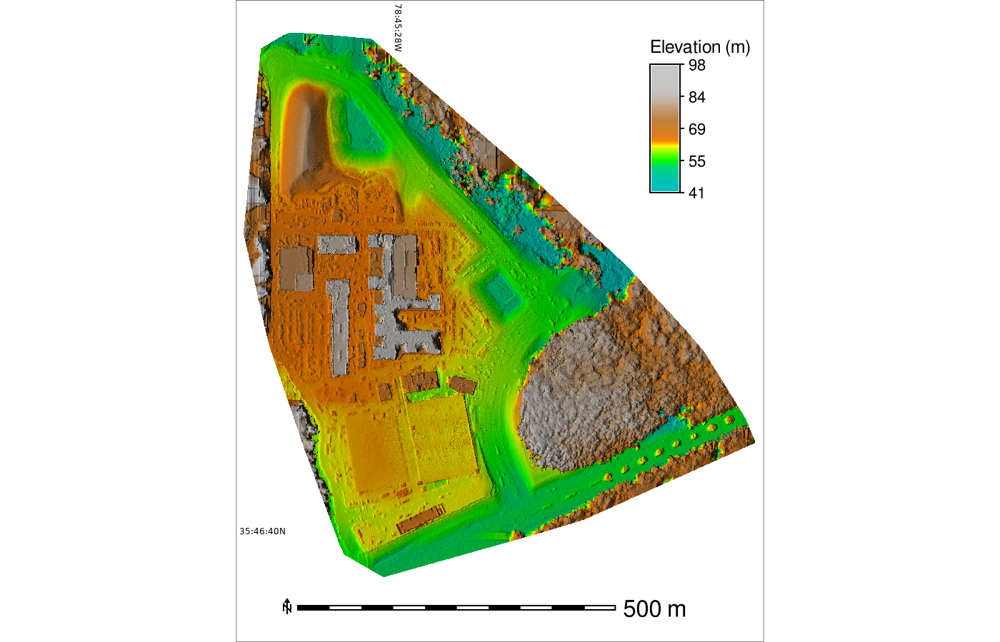

In [4690]:
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15, flags="pa")
gs.run_command("r.colors", map="site_1_dsm_15cm", color="elevation", flags="e")
view_reg = gs.region("site_1_dsm_15cm")
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 90
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15,s=view_reg_s,n=view_reg_n, flags="pa")
rd.generate_elevation_figure(elev="site_1_dsm_15cm", filename="site_1_dsm_15cm_shaded_relief")

#### Figure: DTM 15cm

Image Save Location: output/fenton_odm_dtm_5cm_shaded_relief.png


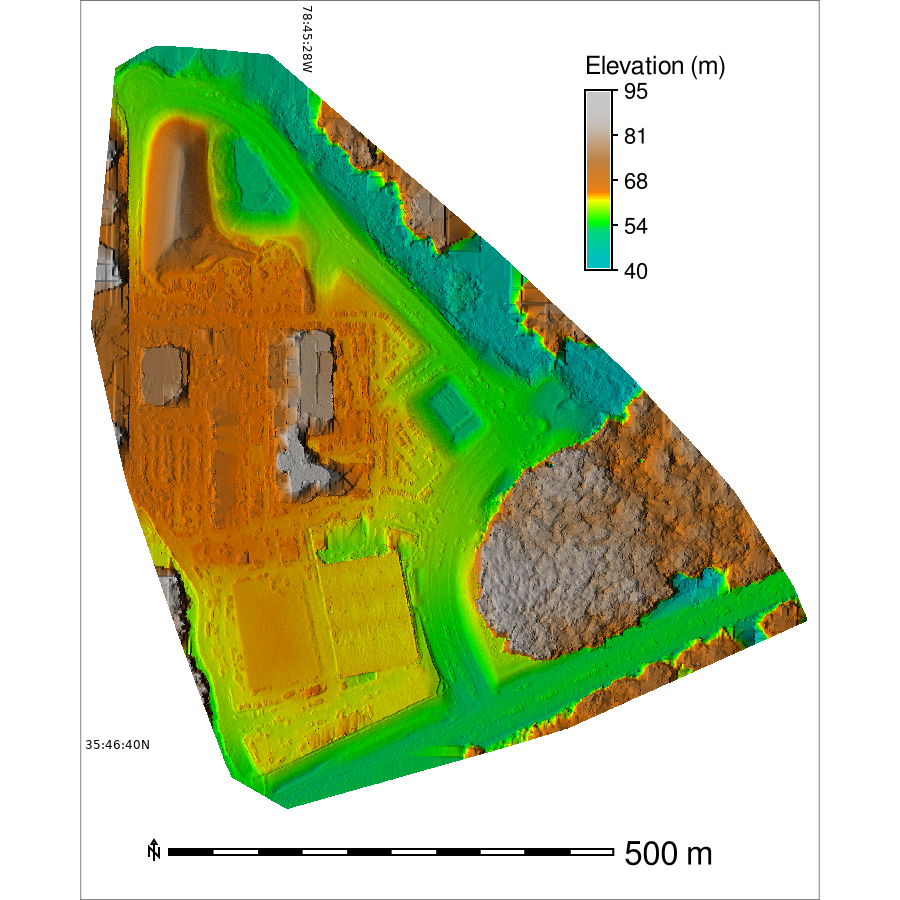

In [4738]:
gs.run_command("r.mask",flags="r")
gs.run_command("g.region",raster="site_1_dtm_15cm", res=0.15, flags="pa")
view_reg = gs.region("fenton_odm_dtm_5cm")
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 90
gs.run_command("g.region",raster="site_1_dtm_15cm", res=0.15,s=view_reg_s,n=view_reg_n, flags="pa")
rd.generate_elevation_figure(elev="site_1_dtm_15cm", filename="site_1_dtm_15cm_shaded_relief")


#### Figure: Ortho 15cm

Image Save Location: output/fenton_odm_ortho_composite_5cm.png


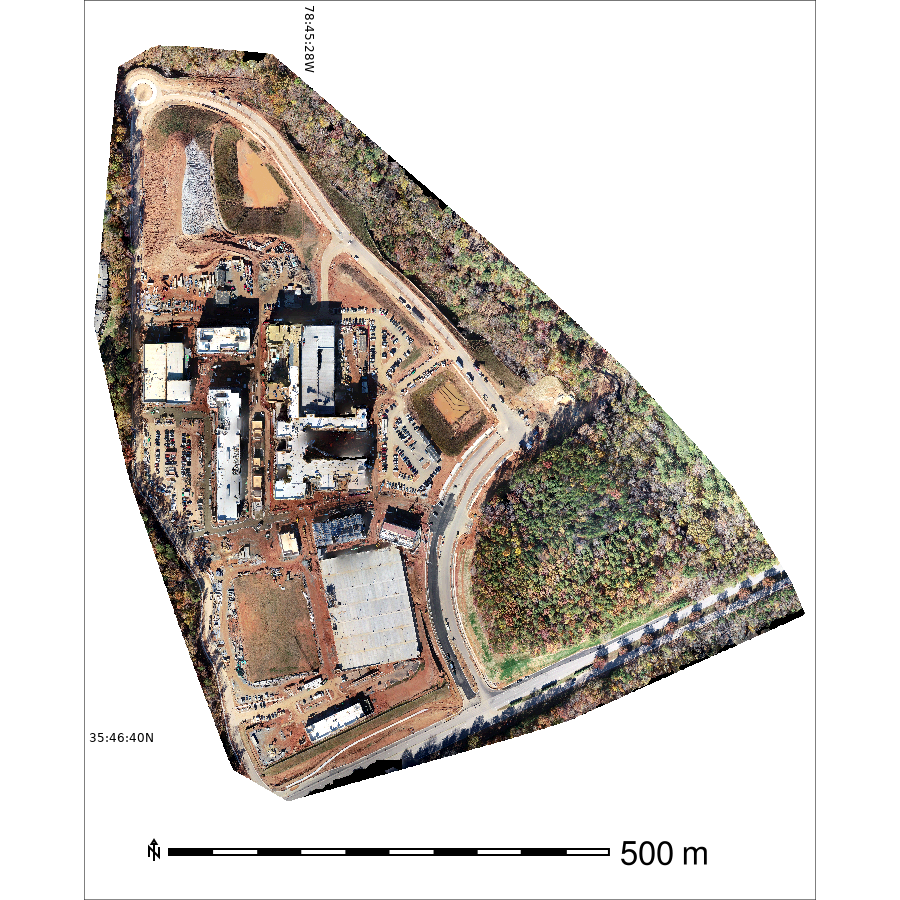

In [4741]:
gs.run_command("g.region", raster="site_1_ortho_composite_15cm", res=0.15, flags="ap")
gs.run_command("r.mask",raster="site_1_dsm_15cm",overwrite=True)
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 100
gs.run_command("g.region",raster="site_1_ortho_composite_15cm",s=view_reg_s, n=view_reg_n, res=0.15, flags="pa")
rd.generate_ortho_figure(ortho="site_1_ortho_composite_15cm", filename="site_1_ortho_composite_15cm")

#### Figure: UAS DEMs Figure

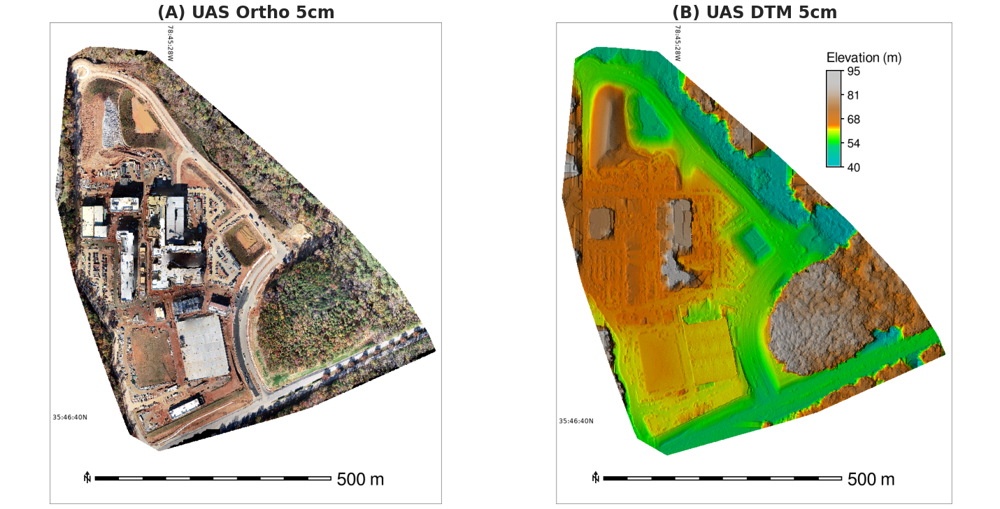

In [4743]:
from PIL import Image

fig = plt.figure(figsize=(20, 10),constrained_layout=True)
ax.set_title("Site 1 - 5cm Resolution", {"fontsize":24, "fontweight":"bold"})

grs = fig.add_gridspec(1, 2)

ax = fig.add_subplot(grs[0,0])
ax.set_axis_off()
# fig.subplots_adjust(hspace=0, wspace=0.0)
img = Image.open("output/fenton_odm_ortho_composite_5cm.png")
imgplot = plt.imshow(img)
ax.set_title('(A) UAS Ortho 5cm',{"fontsize":24, "fontweight":"bold"})

ax1 = fig.add_subplot(grs[0, 1])
ax1.set_axis_off()
# fig.subplots_adjust(hspace=0, wspace=0.0)
img1 = Image.open("output/fenton_odm_dtm_5cm_shaded_relief.png")
imgplot = plt.imshow(img1)
ax1.set_title('(B) UAS DTM 5cm',{"fontsize":24, "fontweight":"bold"})

ax2 = fig.add_subplot(grs[1 ,1])
ax2.set_axis_off()
fig.subplots_adjust(hspace=0, wspace=0.5)
img2 = Image.open("output/bare_earth_thin_shaded_relief.png")
imgplot = plt.imshow(img2)
ax2.set_title('(C) DEM 3m',{"fontsize":24, "fontweight":"bold"})

plt.savefig("output/priority_queue_elevation_shaded_relief.png",bbox_inches='tight', dpi=300)

# Create Bare Earth DEM

In [ ]:
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15, flags="pa")
gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_15cm", output="site_1_dtm_3m_hd_large_tall_objects", method="stddev", size=7)
zscore("site_1_dtm_3m_hd_large_tall_objects","site_1_dtm_3m_hd_log_zscore",log=True)
gs.run_command("r.colors", 
               map="site_1_dtm_3m_hd_log_zscore", 
               color="difference", flags="e", overwrite=True)
gs.mapcalc(f"site_1_dsm_15cm.1 = if(site_1_dtm_3m_hd_log_zscore < 0.5, site_1_dsm_15cm, null())")
gs.run_command("r.colors", 
               map="site_1_dsm_15cm.1", 
               color="elevation", flags="e", overwrite=True)
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dsm_15cm.1")
# fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dtm_3m_hd_log_zscore"
#                                         , values="-7.2-0.5"
#                                        )
# fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dtm_3m_hd_log_zscore")
fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_15cm.1")


fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

In [1]:
# zscore("site_1_dsm_15cm.1","site_1_dsm_15cm.1_log_zscore", log=False)
# gs.run_command("r.colors", 
#                map="site_1_dsm_15cm.1_log_zscore", 
#                color="difference", flags="e", overwrite=True)
# gs.mapcalc(f"site_1_dsm_15cm.2 = if(site_1_dsm_15cm.1_log_zscore < 0.4, site_1_dsm_15cm, null())")
# gs.run_command("r.colors", 
#                map="site_1_dsm_15cm.2", 
#                color="elevation", flags="e", overwrite=True)

# gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_15cm.2", output="site_1_dsm_15cm.2.count", method="count", size=3)
# gs.mapcalc(f"site_1_dsm_15cm_be = if(site_1_dsm_15cm.2.count > 3, site_1_dsm_15cm, null())")
gs.run_command("g.region",raster="site_1_dsm_15cm", res=3, flags="pa")
gs.run_command("r.resamp.interp", input="site_1_dsm_15cm_be", output="site_1_dsm_3m_be", overwrite=True)

gs.run_command("r.colors", 
               map="site_1_dsm_3m_be", 
               color="elevation", flags="e", overwrite=True)


gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_3m_be", output="site_1_dsm_3m_be_count", method="count", size=3)
gs.mapcalc(f"site_1_dsm_3m_be_clean = if(site_1_dsm_3m_be_count > 3,site_1_dsm_3m_be, null())")
gs.run_command("r.colors", 
               map="site_1_dsm_3m_be_clean", 
               color="elevation", flags="e", overwrite=True)
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()

fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dsm_3m_be_clean"
                                        # , values="1-2"
                                       )

fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_3m_be_clean")
# fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_15cm.1_log_zscore")

fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

NameError: name 'gs' is not defined

## Mask Vegetation

In [ ]:
gs.run_command("g.region",raster="site_1_dsm_15cm", res=3, flags="pa")
gs.run_command("r.mask",raster="site_1_dsm_3m_be_clean",flags="i", overwrite=True)

gs.run_command("r.neighbors", overwrite=True, input="classified_after_30m_recl", output="classified_after_30m_recl_mode,site_1_3m_hd_bai_zscore_count", method="mode,count", size=3)
gs.mapcalc(f"site_1_dsm_3m_be_veg_build = if(site_1_3m_hd_bai_zscore_count > 4 && classified_after_30m_recl_mode == 3,1, null())")
gs.run_command("r.mask",flags="r")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()
# fenton_bare_earth_fused_diff_map.d_rast(map="classified_after_30m_recl_mode")
# fenton_bare_earth_fused_diff_map.d_rast(map="site_1_3m_hd_bai_zscore_count")
fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dsm_3m_be_veg_build")

# fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_3m_be_veg_build")

fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

## Smooth DEM and Fill Holes

In [ ]:
gs.run_command("r.mask",raster="site_1_dsm_15cm")

# gs.run_command("r.fillnulls", input="site_1_dsm_3m_be_clean", output="ready_dem_3m", tension=20,smooth=10,memory=10000)'
# gs.run_command("r.fillnulls", input="site_1_dsm_3m_be_clean", output="ready_dem_3m", tension=100,smooth=1,memory=10000)

gs.mapcalc(f"ready_to_fuse = if(isnull(site_1_dsm_3m_be_veg_build),ready_dem_3m, null())")
gs.mapcalc(f"ready_to_fuse_smooth1 = if(ready_to_fuse >= 52, ready_to_fuse,null())") #52
gs.run_command("r.neighbors", overwrite=True, input="ready_to_fuse_smooth1", output="ready_to_fuse_smooth2", method="average", size=3)

gs.run_command("r.neighbors", overwrite=True, input="ready_to_fuse_smooth2", output="ready_to_fuse_smooth2_count", method="count", size=5)
gs.mapcalc(f"ready_to_fuse_smooth = if(ready_to_fuse_smooth2_count >= 25,ready_to_fuse_smooth2, null())") #25

gs.run_command("r.colors", 
               map="ready_to_fuse,ready_to_fuse_smooth", 
               color="elevation", flags="e", overwrite=True)
gs.run_command("r.mask",flags="r")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="ready_to_fuse_smooth")
fenton_bare_earth_fused_diff_map.d_legend(raster="ready_to_fuse_smooth")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

#### Figure: UAS DEM

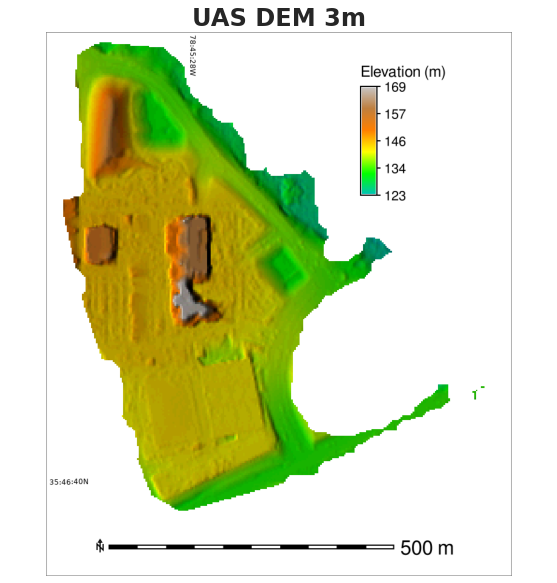

In [4753]:
def generate_elevation_figure(elev, filename):
    """
    Generates a shade png image of an elevation (DTM, DSM)
    @param elev : string : Name of raster
    @param filename: string: Name of file
    """
    relief = f"{elev}_relief"
    shaded_relief = f"{elev}_shaded_relief"
    # shadedRelief(elevation=elev,relief=relief, output=shaded_relief)
    output = f"output/{filename}.png"
    print(f"Image Save Location: {output}")
    elev_map = gj.GrassRenderer(height=900, width=900, filename=output)
    elev_map.d_erase()
    elev_map.d_rast(map=shaded_relief)
    # elev_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width="1", legend_label="Fenton (White Area)")
    elev_map.d_legend(raster=elev, at=(70,90,65,68), title="Elevation (m)",font="FreeSans", title_fontsize=18, fontsize=16, flags="tb", border_color='none')
    elev_map.d_barscale(at=(16,7), units="meters", flags="n",font="FreeSans", fontsize=24)
    elev_map.d_grid(size="00:0:56", flags="dw", width=1, color="black",text_color="black",fontsize=12)

    return elev_map.show()

gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dsm_3m", res=3, flags="pa")
view_reg = gs.region("cary_town_blvd_flight_1_odm_dsm_3m")
view_reg_e = view_reg['e'] - 20
view_reg_s = view_reg['s'] - 80
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dsm_3m", e=view_reg_e,s=view_reg_s, res=3, flags="pa")

# gs.run_command("r.mask",raster="cary_town_blvd_flight_1_odm_dsm_3m",overwrite=True)
generate_elevation_figure(elev="bare_earth_thin", filename="bare_earth_thin_shaded_relief")

# (TODO) Calculate Vertical Offset

# Fuse UAS DEM with USGS NED DEM

In [4638]:
#%module
#% description: Fuse UAS derived DSM into Lidar based DSM.
#%end
#%option
#% key: dsm_file
#% type: string
#% required: yes
#% multiple: no
#% description: GeoTIFF DEM containing the surface
#%end

# from __future__ import absolute_import
# import os
# import sys
# import atexit
import grass.script as gs
import grass.script.array as garray
# from sklearn.mixture import BayesianGaussianMixture as GMM
import numpy as np
from grass.pygrass.modules import Module


TMP_RAST = []
TMP_VECT = []
stddev_thr = 5
mean_thr = 2

# Install grass extensions
# git_repo = "https://github.com/OSGeo/grass-addons/grass7/raster/r.in.usgs.git"
# trac_url = "https://trac.osgeo.org/grass/browser/grass-addons/grass7/raster/r.in.usgs?format=zip"
# Module("g.extension", extension="r.in.usgs", url=trac_url)
# # gs.run_command("g.extension", extension="r.in.usgs")


def import_dsm(output, output_dir, input_srs, resolution, nprocs):
    gs.run_command(
        "r.in.usgs",
        product="lidar",
        output_name=output,
        output_directory=output_dir,
        input_srs=input_srs,
        resolution=resolution,
        nprocs=nprocs,
        flags="k",
    )

def edge_mask(uas, thres=-1):
    print(("#"*25) + " Edge Mask " + ("#" *25))
    mask = f"{uas}_mask"
    print(f"UAS Mask: {mask}")
    gs.mapcalc(f"{mask} = if({uas}, 1, null())")
    
    thin=f"{mask}_thin" # The thinned mask
    print(f"Thin UAS Mask: {thin}")
    gs.run_command("r.grow", overwrite=True, input=mask, output=thin, radius=thres)
    
    uas_thin = f"{uas}_thin"
    print(f"Thin UAS: {uas_thin}")
    gs.mapcalc(f"{uas_thin} = if({thin}, {uas}, null())")

    return uas_thin

def ground_dem(uas,uas_vert_c, dem, thres=1):
    """
    @param uas : UAS Data
    @param uas_vert_c : Vert Correct UAS
    @param dem : DEM Data
    @return ground: 
    """
    print(("#"*25) + " Ground DEM " + ("#" *25))
    ground_dem = "ground_dem"
    gs.mapcalc(f"{ground_dem} = if({uas_vert_c} - {dem} < {thres}, {uas},null())") # 1ft
    print(f"Output: Uncorrected Ground DEM< (UAS_Vert_Corrected - DEM < 0.3): {ground_dem}")
    # gs.mapcalc(f"{groud_mask} = if({uas_vert_c} - {dem} < {thres}, {uas},null())") # 1ft
    # print(f"Output: Ground Mask: {ground_mask}")
    ground_dem_point_sample = "ground_dem_point_sample"
    # !r.random -d input=ground_dem npoints=20 raster=ground_dem_point_sample seed=1

    return ground_dem_point_sample

def report_diff_stats(raster):
    univar = gs.parse_command("r.univar", map=raster, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    tb_median = float(univar["median"])
    dmin = float(univar["min"])
    dmax = float(univar["max"])
    print(f"{raster}: Mean: {mean}, STD: {stddev}, Median: {tb_median}, Min: {dmin}, Max: {dmax}")
    return univar
    
    
#New Fuctions to create bare earth DTM
def bare_earth(uas, dem, ndvi, smooth=0):
    print(("#"*25) + " Bare Earth " + ("#" *25))
    print(f"Inputs: uas:{uas},dem:{dem},ndvi:{ndvi}")
    tmp_tall_objects = "tall_objects"
    tall_objects_clump = "tall_objects_clump"
    tall_objects_clump_ndvi = "tall_objects_clump_ndvi"
    bare_earth = "bare_earth"
    bare_earth_smooth = "bare_earth_smooth"
    positive_diff = "positive_diff"
    positive_diff_clump = "positive_diff_clump"
    positive_diff_clump_avg = "positive_diff_clump_avg"
      
    gs.mapcalc(f"{positive_diff} = if({uas} - {dem} > 0, {uas} - {dem},null())")
    print(f"Output: Positive Diff: {positive_diff}")
    report_diff_stats(positive_diff)
    gs.run_command("r.clump",input=positive_diff,output=positive_diff_clump, minsize=10,threshold=0.025)
    gs.run_command("r.stats.zonal",overwrite=True, base=positive_diff_clump, cover=positive_diff, method="average", output=positive_diff_clump_avg)
    report_diff_stats(positive_diff_clump_avg)
    gs.mapcalc(f"{tmp_tall_objects} = if({positive_diff_clump_avg} > 5, {uas} - {dem},null())")
    # gs.mapcalc(f"{tmp_tall_objects} = if({uas} - {dem} > 5, {uas} - {dem},null())")
    print(f"Output: Tall Objects (UAS - DEM > 2m): {tmp_tall_objects}")
    report_diff_stats(tmp_tall_objects)

    # Clump Tall Objects and calculate averge ndvi
    gs.run_command("r.clump",input=tmp_tall_objects,output=tall_objects_clump, minsize=10,threshold=0.5)
    gs.run_command("r.stats.zonal",overwrite=True, base=tall_objects_clump, cover=ndvi, method="average", output=tall_objects_clump_ndvi)
    print(f"Output: Tall Objects Clumped: {tall_objects_clump}")
    univar_ndvi = gs.parse_command("r.univar", map=tall_objects_clump_ndvi, flags="ge")#"fenton_ndvi_3m"
    mean_ndvi = float(univar_ndvi["mean"])
    stddev_ndvi = float(univar_ndvi["stddev"])
    median_ndvi = float(univar_ndvi["median"])
    ndvi_thres = mean_ndvi - (stddev_ndvi)
    print(f"Output: Tall Objects Clumped NDVI: {tall_objects_clump_ndvi}")
    print(f"Stats: Tall Objects Clumped NDVI: {mean_ndvi}, STD: {stddev_ndvi}, Median: {median_ndvi}, Threshold (mean - 0.25STD): {ndvi_thres}")
    # gs.mapcalc(f"{bare_earth} = if(({uas} - {dem} < {diff_thres} || {tall_objects_clump_ndvi} < {ndvi_thres}), {uas}, {dem})")
    
    vegitation = "veg_clumps"
    gs.mapcalc(f"{vegitation} = if(({tall_objects_clump_ndvi} >= {ndvi_thres}), 1,null())")
    print(f"Output: Vegitation Clumps : {vegitation}")
    
    # Calculate Bare Earth DEM (Includes Buildings
    gs.mapcalc(f"{bare_earth} = if({uas} - if(isnull({vegitation} ),0, {uas} ) > 0, {uas}, null())")
  
    print(f"Output: Bare Earth DEM: {bare_earth}")
    new_diff = f"{bare_earth}_diff"
    gs.mapcalc(f"{new_diff} = {bare_earth} - {dem}")
    print(f"Output: Bare Earth Diff (Bare Earth - DEM) : {new_diff}")
    report_diff_stats(new_diff)
    
    
    # Calculate Smooth Bare Earth DEM
    if smooth > 0:
        print(f"Output: Bare Earth Smooth DEM (median mw: {smooth}): {bare_earth_smooth}")
        gs.run_command("r.neighbors", input=bare_earth, output=bare_earth_smooth, method="median", size=3, overwrite=True)
        bare_earth_smooth_diff = f"{bare_earth}_smooth_diff"
        gs.mapcalc(f"{bare_earth_smooth_diff} = {bare_earth_smooth} - {dem}")
        report_dif#%module
#% description: Fuse UAS derived DSM into Lidar based DSM.
#%end
#%option
#% key: dsm_file
#% type: string
#% required: yes
#% multiple: no
#% description: GeoTIFF DEM containing the surface
#%end

# from __future__ import absolute_import
# import os
# import sys
# import atexit
import grass.script as gs
import grass.script.array as garray
# from sklearn.mixture import BayesianGaussianMixture as GMM
import numpy as np
from grass.pygrass.modules import Module


TMP_RAST = []
TMP_VECT = []
stddev_thr = 5
mean_thr = 2

# Install grass extensions
# git_repo = "https://github.com/OSGeo/grass-addons/grass7/raster/r.in.usgs.git"
# trac_url = "https://trac.osgeo.org/grass/browser/grass-addons/grass7/raster/r.in.usgs?format=zip"
# Module("g.extension", extension="r.in.usgs", url=trac_url)
# # gs.run_command("g.extension", extension="r.in.usgs")

def zscore(rast, output, log=False):
    if log:
        tmp_log = "tmp_log"
        gs.mapcalc(f"{tmp_log} = log({rast})")
        univar = gs.parse_command("r.univar", map=tmp_log, flags="ge")
        mean = float(univar["mean"])
        stddev = float(univar["stddev"])
        gs.mapcalc(f"{output} = ({tmp_log} - {mean}) / {stddev}")
    else:
        univar = gs.parse_command("r.univar", map=rast, flags="ge")
        mean = float(univar["mean"])
        stddev = float(univar["stddev"])
        gs.mapcalc(f"{output} = ({rast} - {mean}) / {stddev}")

def import_dsm(output, output_dir, input_srs, resolution, nprocs):
    gs.run_command(
        "r.in.usgs",
        product="lidar",
        output_name=output,
        output_directory=output_dir,
        input_srs=input_srs,
        resolution=resolution,
        nprocs=nprocs,
        flags="k",
    )

def edge_mask(uas, thres=-1, e=None):
    print(("#"*25) + " Edge Mask " + ("#" *25))
    mask = f"{uas}_mask"
    print(f"UAS Mask: {mask}")
    gs.mapcalc(f"{mask} = if({uas}, 1, null())")
    uas_thin = f"{uas}_thin"
    if e:
        gs.run_command("g.region", raster=uas)
        uas_reg = gs.region(uas)
        # avg_wh = ((uas_reg["n"] - uas_reg["s"]) + (uas_reg["e"] - uas_reg["w"])) / 2.0
        # n = uas_reg["n"] + avg_wh * buffer
        # s = uas_reg["s"] - avg_wh * buffer
        e = uas_reg["e"] - e
        # w = uas_reg["w"] - w
        gs.run_command("g.region", e=e)

        # gs.run_command("g.region", n=n, e=e, s=s, w=w)
        gs.mapcalc(f"{uas_thin} = if({uas}, {uas}, null())")
    else:
        thin=f"{mask}_thin" # The thinned mask
        print(f"Thin UAS Mask: {thin}")
        gs.run_command("r.grow", overwrite=True, input=mask, output=thin, radius=thres)
        gs.mapcalc(f"{uas_thin} = if({thin}, {uas}, null())")

    print(f"Thin UAS: {uas_thin}")

    return uas_thin

def ground_dem(uas,uas_vert_c, dem, thres=0.1):
    """
    @param uas : UAS Data
    @param uas_vert_c : Vert Correct UAS
    @param dem : DEM Data
    @return ground: 
    """
    print(("#"*25) + " Ground DEM " + ("#" *25))
    ground_dem = "ground_dem"
    gs.mapcalc(f"{ground_dem} = if({uas_vert_c} - {dem} <= {thres}, {uas},null())") # 1ft
    print(f"Output: Uncorrected Ground DEM< (UAS_Vert_Corrected - DEM < {thres}): {ground_dem}")
    # gs.mapcalc(f"{groud_mask} = if({uas_vert_c} - {dem} < {thres}, {uas},null())") # 1ft
    # print(f"Output: Ground Mask: {ground_mask}")
    ground_dem_point_sample = "ground_dem_point_sample"
    !r.random -d input=ground_dem npoints=20 raster=ground_dem_point_sample seed=1

    return ground_dem_point_sample

def report_diff_stats(raster):
    univar = gs.parse_command("r.univar", map=raster, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    tb_median = float(univar["median"])
    dmin = float(univar["min"])
    dmax = float(univar["max"])
    print(f"{raster}: Mean: {mean}, STD: {stddev}, Median: {tb_median}, Min: {dmin}, Max: {dmax}")
    return univar

def geographic_correct_dem(dem,output,row_shift=0, column_shift=0):
    """
    Geographic Registration
    @param dem string Input raster name
    @param output string Output raster name
    @param row_shift int (default=-5)
    @param column_shift int (default=-1)
    @return output Shifted raster name
    """
    print(("#"*25) + " Geographic Shift " + ("#" *25))
    print(f"Inputs: dem:{dem},output: {output},row_shift: {row_shift}, column_shift: {column_shift}")

    gs.mapcalc(f"{output} = if({dem} >= 0, {dem}[{row_shift},{column_shift}], null())")
    return output
    


def extract_tall_objects(uas, dem, tall_objects_clump, positive_diff_clump_avg, tall_object_thres=3.5, min_clump_size=100, clump_thres=0.007, bare_earth_thres=0):
    print(("#"*25) + " Extract Tall Objects " + ("#" *25))
    print(f"Inputs: uas: {uas}, dem: {dem}, tall_objects_clump: {tall_objects_clump}, positive_diff_clump_avg:{positive_diff_clump_avg}, tall_object_thres: {tall_object_thres}, min_clump_size: {min_clump_size}, clump_thres: {clump_thres}, bare_earth_thres: {bare_earth_thres}")
    tmp_tall_objects = "tall_objects"
    positive_diff = "positive_diff"
    positive_diff_clump = "positive_diff_clump"
    
    # Get cells with a positive height
    gs.mapcalc(f"{positive_diff} = if({uas} - {dem} > {bare_earth_thres}, {uas} - {dem},null())")
    print(f"Output: Positive Diff: {positive_diff}")
    report_diff_stats(positive_diff)
    
    # Calculate Average Height for each tall object
    gs.run_command("r.clump",input=positive_diff,output=positive_diff_clump,minsize=min_clump_size,threshold=clump_thres)
    # gs.run_command("i.segment.hierarchical", group="site_1_dsm_3m_group", output="site_1_dsm_3m_group_segs", thresholds=[0.25,0.5,0.55,0.65,0.7,0.75,0.8,0.85,0.95, 0.99])
    gs.run_command("r.stats.zonal",overwrite=True, base=positive_diff_clump, cover=positive_diff, method="average", output=positive_diff_clump_avg)
    
    # Remove large clumps and calucate average for buildings
    gs.run_command("r.area", input="positive_diff_clump", output="positive_diff_clump_reduced", greater="1000")
    gs.run_command("r.stats.zonal",overwrite=True, base="positive_diff_clump_reduced", cover="site_1_3m_bai", method="average", output=f"{positive_diff_clump_avg}_bai")

    report_diff_stats(positive_diff_clump_avg)
    
    # Remove objects below height threshold
    gs.mapcalc(f"{tmp_tall_objects} = if({positive_diff_clump_avg} > {tall_object_thres}, {uas} - {dem},null())")
    print(f"Output: Tall Objects (UAS - DEM > {tall_object_thres}m): {tmp_tall_objects}")
    report_diff_stats(tmp_tall_objects)
    # Clump Tall Objects and calculate averge ndvi
    gs.run_command("r.clump",input=tmp_tall_objects,output=tall_objects_clump,minsize=min_clump_size,threshold=clump_thres)
    
    return tall_objects_clump, positive_diff_clump_avg



def extract_vegetation(tall_objects_clump,positive_diff_clump_avg, ndvi, output="veg_clumps",thres_multi=0.25,ndvi_thres=0.40,veg_height=17):
    print(("#"*25) + " Extract Vegetation " + ("#" *25))
    print(f"Inputs: tall_objects_clump: {tall_objects_clump},positive_diff_clump_avg:{positive_diff_clump_avg}, ndvi: {ndvi}, output: {output}")
    
    tall_objects_clump_ndvi = "tall_objects_clump_ndvi"
    gs.run_command("r.stats.zonal",overwrite=True, base=tall_objects_clump, cover=ndvi, method="average", output=tall_objects_clump_ndvi)
    print(f"Output: Tall Objects Clumped: {tall_objects_clump}")
    univar_ndvi = gs.parse_command("r.univar", map=tall_objects_clump_ndvi, flags="ge")#"fenton_ndvi_3m"
    mean_ndvi = float(univar_ndvi["mean"])
    stddev_ndvi = float(univar_ndvi["stddev"])
    median_ndvi = float(univar_ndvi["median"])
    ndvi_thres = mean_ndvi - (stddev_ndvi*thres_multi)
    # ndvi_thres= 0.40# 0.40
    print(f"Output: Tall Objects Clumped NDVI: {tall_objects_clump_ndvi}")
    print(f"Stats: Tall Objects Clumped NDVI: {mean_ndvi}, STD: {stddev_ndvi}, Median: {median_ndvi}, Threshold (mean - {thres_multi}STD): {ndvi_thres}")    
    gs.mapcalc(f"{output} = if(({tall_objects_clump_ndvi} >= {ndvi_thres} && {positive_diff_clump_avg} > {veg_height}), 1,null())") #19
    print(f"Output: Vegitation Clumps : {output}")
    return output

def fill_gaps(uas,dem, tall_objects_clump,tall_objects_clump_2, vegetation,output):
    tall_objects_clump_buff = "tall_objects_clump_buff"
    gs.run_command("r.grow",input=tall_objects_clump ,output=tall_objects_clump_buff,radius=1, overwrite=True)
    rough_bare_earth = "rough_bare_earth"
    gs.mapcalc(f"{rough_bare_earth} = if({uas} - if((isnull({tall_objects_clump}) && isnull({tall_objects_clump_2})) ,0, {uas} ) > 0, {uas}, null())")
    tmp_rough_bare_earth = "tmp_rough_bare_earth"
    gs.run_command("r.mask", raster=uas, overwrite=True)
    gs.run_command("r.fillnulls", input=rough_bare_earth, output=tmp_rough_bare_earth, tension=20,smooth=10,memory=3000)
    gs.mapcalc(f"{output} = if({tmp_rough_bare_earth} - if(isnull({vegetation}),0, {tmp_rough_bare_earth} ) > 0, {tmp_rough_bare_earth}, null())")
    gs.run_command("r.mask", flags="r")

    print(f"Output: Bare Earth DEM: {output}")
    new_diff = f"{output}_diff"
    gs.mapcalc(f"{new_diff} = {output} - {dem}")
    print(f"Output: Bare Earth Diff (Bare Earth - DEM) : {new_diff}")
    report_diff_stats(new_diff)
    return output, new_diff
    
    
    
#New Fuctions to create bare earth DTM
def bare_earth(uas, dem, ndvi, smooth=0):
    print(("#"*25) + " Bare Earth " + ("#" *25))
    print(f"Inputs: uas:{uas},dem:{dem},ndvi:{ndvi}")
    
    # tall_objects_clump_ndvi = "tall_objects_clump_ndvi"
    

    tall_objects_clump, positive_diff_clump_avg = extract_tall_objects(
        uas=uas, 
        dem=dem, 
        tall_objects_clump="tall_objects_clump", 
        positive_diff_clump_avg="positive_diff_clump_avg", 
        tall_object_thres=16, # was 17
        min_clump_size=50,  
        clump_thres=0.01, 
        bare_earth_thres=6.5)
    
    gs.run_command("r.slope.aspect", elevation=uas, slope="tmp_slope", overwrite=True)
    
    vegetation = extract_vegetation(tall_objects_clump,positive_diff_clump_avg,ndvi,output="veg_clumps",ndvi_thres=0.4,veg_height=17)
    
    gs.run_command("r.mask", raster=tall_objects_clump,flags="i", overwrite=True)
    tall_objects_clump, positive_diff_clump_avg = extract_tall_objects(
        uas=uas, 
        dem=dem, 
        tall_objects_clump="tall_objects_clump_2", 
        positive_diff_clump_avg="positive_diff_clump_avg_2", 
        tall_object_thres=3, # Was 4 
        min_clump_size=8, 
        clump_thres=0.02,  
        bare_earth_thres=0)
    
    gs.run_command("r.mask", flags="r")
    
    # gs.mapcalc(f"combined_tall_objects = if(positive_diff_clump_avg_2>5,positive_diff_clump_avg_2,null()) + if(positive_diff_clump_avg >17,positive_diff_clump_avg ,null())") 
    gs.mapcalc(f"combined_tall_objects = if(tall_objects_clump_2 >0 || tall_objects_clump>0,1,null())") 
    bare_earth, new_diff = fill_gaps(uas, dem,"tall_objects_clump", "tall_objects_clump_2", vegetation, "bare_earth")
    
    # Calculate Smooth Bare Earth DEM
    if smooth > 0:
        bare_earth_smooth = "bare_earth_smooth"     
        print(f"Output: Bare Earth Smooth DEM (median mw: {smooth}): {bare_earth_smooth}")
        gs.run_command("r.neighbors", input=bare_earth, output=bare_earth_smooth, method="average", size=smooth, overwrite=True)
        bare_earth_smooth_diff = f"{bare_earth}_smooth_diff"
        gs.mapcalc(f"{bare_earth_smooth_diff} = {bare_earth_smooth} - {dem}")
        report_diff_stats(bare_earth_smooth_diff)
        return bare_earth_smooth, bare_earth_smooth_diff
    else:
        return bare_earth, new_diff

def import_dem(output, output_dir, nprocs):
    gs.run_command(
        "r.in.usgs",
        product="ned",
        ned_dataset="ned19sec",
        output_name=output,
        output_directory=output_dir,
        nprocs=nprocs,
    )


def resample(uas, dem, match_uas=True):
    # resample uas to match lidar, or the other way round?
    print(("#"*25) + " Resample " + ("#" *25))

    resampled = "tmp_resampled"
    uas_ = uas
    dem_ = dem

    if not match_uas:
        print(f"Output Raster: Resampled to Match DEM: {resampled}")
        gs.run_command("g.region", raster=uas, align=dem)
        gs.run_command("r.resamp.interp", input=uas, output=resampled)
        uas_ = resampled
    else:
        print(f"Output Raster: Resampled to Match UAS: {resampled}")
        gs.run_command("g.region", raster=dem, align=uas)
        gs.run_command("r.resamp.interp", input=dem, output=resampled)
        dem_ = resampled

    TMP_RAST.append(resampled)
    return uas_, dem_


def get_diff(uas, dem, mean_thr, output):
    # compute difference
    print(("#"*25) + " Get Diff " + ("#" *25))
    diff = f"{output}_diff"
    gs.run_command("g.region", raster=uas)
    gs.mapcalc(diff + " = " + uas + " - " + dem)
    print(f"Output Raster: Difference (UAS - DEM): {diff}")
    TMP_RAST.append(diff)
    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    median = float(univar["median"])
    stddev = float(univar["stddev"])
    # print("Difference: {mean:.1f} ± {stddev:.1f}".format(mean=mean, stddev=stddev))
    # test for systematic shift:
    print(f"Difference: Mean:{mean}, STD: {stddev}, Median: {median}")
    _min = float(univar["min"])
    _max = float(univar["max"])
    print(f"Range: Min:{_min}, Max: {_max}")
    if abs(median) > mean_thr:
        print("Vertical shift is likely.")
    return diff, median


def vertically_corrected_uas(uas, dem, shift,output):
    print(("#"*25) + " Vertical Correction " + ("#" *25))
    print(f"Shifting {uas} by {shift}m")
    new = f"{output}_vertically_corrected_uas"
    diff = f"{output}_diff_corrected"
    gs.mapcalc(f"{new} = {uas} - {shift}")
    print(f"Output: Vertically Corrected UAS (UAS - Shift): {new}")
    univar = gs.parse_command("r.univar", map=new, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    median = float(univar["median"])
    print(f"Vertically Corrected Stats: Mean: {mean}, STD: {stddev}, Median: {median}")
    # report_diff_stats(new)

    TMP_RAST.append(new)
    
    gs.mapcalc(diff + " = " + new + " - " + dem)
    print(f"Output: Difference (Vertically Corrected UAS - DEM): {diff}")
    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    median = float(univar["median"])
    print(f"Difference (Vertically Corrected UAS - DEM) Stats: Mean: {mean}, STD: {stddev}, Median: {median}")
    TMP_RAST.append(diff)

    return new, diff


def patch(uas, dem, output,ps,ta,dr):
    print(("#"*25) + " Patch " + ("#" *25))
    print(f"Inputs: uas:{uas},dem:{dem},output:{output},ps:{ps},ta:{ta},dr{dr}")
    overlap = f"{output}_overlap"
    gs.run_command("g.region", raster=dem)
    gs.run_command(
        "r.patch.smooth", input_a=uas, input_b=dem, output=output, 
        # smooth_dist=10, 
        overlap=overlap,
        parallel_smoothing=ps,#13,
        transition_angle=ta,#6.5,
        difference_reach=dr,
        # blend_mask="fenton_edge_mask_odm_dtm_3m_pmask",
        flags="s"
    )
    print(f"Output: Overlap: {overlap}")
    print(f"Output: Fused DEM {output}")
    diff = f"{output}_diff"
    gs.mapcalc(f"{diff} = {output} - {dem}")
    print(f"Output: Fused Diff (Fused UAS DEM - DEM) {diff}")

    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    median = float(univar["median"])
    stddev = float(univar["stddev"])
   
    print(f"Difference: Mean:{mean}, STD: {stddev}, Median: {median}")
    gs.run_command("r.colors", map=[output, dem, uas], color="elevation")


def cleanup():
    gs.run_command(
        "g.remove", flags="f", type="raster", name=",".join(TMP_RAST), quiet=True
    )
    gs.run_command(
        "g.remove", flags="f", type="vector", name=",".join(TMP_VECT), quiet=True
    )


# def main(uas, dem, output, buffer):
#     gs.run_command("g.region", raster=uas)
#     uas_reg = gs.region(uas)
#     avg_wh = ((uas_reg["n"] - uas_reg["s"]) + (uas_reg["e"] - uas_reg["w"])) / 2.0
#     n = uas_reg["n"] + avg_wh * buffer
#     s = uas_reg["s"] - avg_wh * buffer
#     e = uas_reg["e"] + avg_wh * buffer
#     w = uas_reg["w"] - avg_wh * buffer
#     gs.run_command("g.region", n=n, e=e, s=s, w=w)
#     # import_dsm(dem, output_dir='/tmp', input_srs='EPSG:2264', resolution=3, nprocs=4)
#     gs.use_temp_region()
#     uas, dem = resample(uas, dem, True)
#     diff, univar_shift = get_diff(uas, dem, 2)
#     uas, diff = vertically_corrected_uas(uas, dem, univar_shift)
#     patch(uas, dem, output)

#     gs.del_temp_region()


# if __name__ == "__main__":
#     os.environ["GRASS_OVERWRITE"] = "1"
#     opts, _ = gs.parser()
    
#     #Load DSM data from WebODM
#     gs.run_command("r.external", input=opts['dsm_file'], output="uav", overwrite=True)
#     uas_dsm = "uav"
#     lidar_dsm = "lidar"
#     lidar_dem = "ned"
#     dem = lidar_dsm
#     output = "fused"
#     buffer = 0.5
#     atexit.register(cleanup)
#     sys.exit(main(uas_dsm, dem, output, buffer))

def fusion(dem, uas, output,ps=5,ta=2,dr=3, ndvi=False, usgs=True, thin=0, smooth=0):
    _uas = uas
    buffer = 0.5
    gs.run_command("g.region", raster=uas)
    uas_reg = gs.region(uas)
    avg_wh = ((uas_reg["n"] - uas_reg["s"]) + (uas_reg["e"] - uas_reg["w"])) / 2.0
    n = uas_reg["n"] + avg_wh * buffer
    s = uas_reg["s"] - avg_wh * buffer
    e = uas_reg["e"] + avg_wh * buffer
    w = uas_reg["w"] - avg_wh * buffer
    gs.run_command("g.region", n=n, e=e, s=s, w=w)
    # import_dsm(dem, output_dir='/tmp', input_srs='EPSG:2264', resolution=3, nprocs=4)
    if usgs:
        # import_dsm(dem, output_dir='/tmp', input_srs='EPSG:2264', resolution=3, nprocs=8)

        import_dem(dem,"/tmp", 5)
    gs.use_temp_region()
    
    uas = geographic_correct_dem(uas, "geo_correct_uas")
    uas, dem = resample(uas, dem, True)
    diff, univar_shift = get_diff(uas, dem, 2,output)
    uas_vert_c, diff = vertically_corrected_uas(uas, dem, univar_shift, output)
    # Reshift to improve vert overap accuracy
    ground = ground_dem(uas, uas_vert_c,dem)
    diff, univar_shift = get_diff(ground, dem, 2,output)
    univar_shift = -79.885317 #-80.574142
    uas, diff = vertically_corrected_uas(uas, dem, univar_shift, output)
    # uas = geographic_correct_dem(uas, "geo_correct_uas")
    if ndvi:
        #Get Bare Earth Data Maks
        #Then Run fusion
        uas, diff = bare_earth(uas, dem, ndvi,smooth)
        if thin < 0:
            # thin = thin * -1 # Make value negative to thin boarder
            uas = edge_mask(uas,thin) ## Added thinning here
        # Run vertical correction again without buildings
        
    patch(uas, dem, output,ps,ta,dr)
    gs.del_temp_region()
    # cleanup()f_stats(bare_earth_smooth_diff)
        return bare_earth_smooth, bare_earth_smooth_diff
    else:
        return bare_earth, new_diff

def import_dem(output, output_dir, nprocs):
    gs.run_command(
        "r.in.usgs",
        product="ned",
        ned_dataset="ned19sec",
        output_name=output,
        output_directory=output_dir,
        nprocs=nprocs,
    )


def resample(uas, dem, match_uas=True):
    # resample uas to match lidar, or the other way round?
    print(("#"*25) + " Resample " + ("#" *25))

    resampled = "tmp_resampled"
    uas_ = uas
    dem_ = dem

    if not match_uas:
        print(f"Output Raster: Resampled to Match DEM: {resampled}")
        gs.run_command("g.region", raster=uas, align=dem)
        gs.run_command("r.resamp.interp", input=uas, output=resampled)
        uas_ = resampled
    else:
        print(f"Output Raster: Resampled to Match UAS: {resampled}")
        gs.run_command("g.region", raster=dem, align=uas)
        gs.run_command("r.resamp.interp", input=dem, output=resampled)
        dem_ = resampled

    TMP_RAST.append(resampled)
    return uas_, dem_


def get_diff(uas, dem, mean_thr, output):
    # compute difference
    print(("#"*25) + " Get Diff " + ("#" *25))
    diff = f"{output}_diff"
    gs.run_command("g.region", raster=uas)
    gs.mapcalc(diff + " = " + uas + " - " + dem)
    print(f"Output Raster: Difference (UAS - DEM): {diff}")
    TMP_RAST.append(diff)
    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    median = float(univar["median"])
    stddev = float(univar["stddev"])
    # print("Difference: {mean:.1f} ± {stddev:.1f}".format(mean=mean, stddev=stddev))
    # test for systematic shift:
    print(f"Difference: Mean:{mean}, STD: {stddev}, Median: {median}")
    _min = float(univar["min"])
    _max = float(univar["max"])
    print(f"Range: Min:{_min}, Max: {_max}")
    if abs(median) > mean_thr:
        print("Vertical shift is likely.")
    return diff, mean


def vertically_corrected_uas(uas, dem, shift,output):
    print(("#"*25) + " Vertical Correction " + ("#" *25))

    new = f"{output}_vertically_corrected_uas"
    diff = f"{output}_diff_corrected"
    gs.mapcalc("{new} = {uas} - {shift}".format(shift=shift, uas=uas, new=new))
    print(f"Output: Vertically Corrected UAS (UAS - Shift): {new}")
    univar = gs.parse_command("r.univar", map=new, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    median = float(univar["median"])
    print(f"Vertically Corrected Stats: Mean: {mean}, STD: {stddev}, Median: {median}")
    TMP_RAST.append(new)
    
    gs.mapcalc(diff + " = " + new + " - " + dem)
    print(f"Output: Difference (Vertically Corrected UAS - DEM): {diff}")
    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    stddev = float(univar["stddev"])
    median = float(univar["median"])
    print(f"Difference (Vertically Corrected UAS - DEM) Stats: Mean: {mean}, STD: {stddev}, Median: {median}")
    TMP_RAST.append(diff)

    return new, diff


def patch(uas, dem, output,ps,ta,dr):
    print(("#"*25) + " Patch " + ("#" *25))
    print(f"Inputs: uas:{uas},dem:{dem},output:{output},ps:{ps},ta:{ta},dr{dr}")
    overlap = f"{output}_overlap"
    gs.run_command("g.region", raster=dem)
    gs.run_command(
        "r.patch.smooth", input_a=uas, input_b=dem, output=output, 
        # smooth_dist=10, 
        overlap=overlap,
        parallel_smoothing=ps,#13,
        transition_angle=ta,#6.5,
        difference_reach=dr,
        # blend_mask="fenton_edge_mask_odm_dtm_3m_pmask",
        flags="s"
    )
    print(f"Output: Overlap: {overlap}")
    print(f"Output: Fused DEM {output}")
    diff = f"{output}_diff"
    gs.mapcalc(f"{diff} = {output} - {dem}")
    print(f"Output: Fused Diff (Fused UAS DEM - DEM) {diff}")

    univar = gs.parse_command("r.univar", map=diff, flags="ge")
    mean = float(univar["mean"])
    median = float(univar["median"])
    stddev = float(univar["stddev"])
   
    print(f"Difference: Mean:{mean}, STD: {stddev}, Median: {median}")
    gs.run_command("r.colors", map=[output, dem, uas], color="elevation")


def cleanup():
    gs.run_command(
        "g.remove", flags="f", type="raster", name=",".join(TMP_RAST), quiet=True
    )
    gs.run_command(
        "g.remove", flags="f", type="vector", name=",".join(TMP_VECT), quiet=True
    )

def fusion(dem, uas, output,ps=5,ta=2,dr=3, ndvi=False, usgs=True, thin=0, smooth=0):
    _uas = uas
    buffer = 0.5
    gs.run_command("g.region", raster=uas)
    uas_reg = gs.region(uas)
    avg_wh = ((uas_reg["n"] - uas_reg["s"]) + (uas_reg["e"] - uas_reg["w"])) / 2.0
    n = uas_reg["n"] + avg_wh * buffer
    s = uas_reg["s"] - avg_wh * buffer
    e = uas_reg["e"] + avg_wh * buffer
    w = uas_reg["w"] - avg_wh * buffer
    gs.run_command("g.region", n=n, e=e, s=s, w=w)
    # import_dsm(dem, output_dir='/tmp', input_srs='EPSG:2264', resolution=3, nprocs=4)
    if usgs:
        # import_dsm(dem, output_dir='/tmp', input_srs='EPSG:2264', resolution=3, nprocs=8)

        import_dem(dem,"/tmp", 5)
    gs.use_temp_region()
    
    uas, dem = resample(uas, dem, True)
    diff, univar_shift = get_diff(uas, dem, 2,output)
    uas_vert_c, diff = vertically_corrected_uas(uas, dem, univar_shift, output)
    # Reshift to improve vert overap accuracy
    ground = ground_dem(uas, uas_vert_c,dem)
    diff, univar_shift = get_diff(ground, dem, 2,output)
    uas, diff = vertically_corrected_uas(uas, dem, univar_shift, output)
    if ndvi:
        #Get Bare Earth Data Maks
        #Then Run fusion
        
        uas, diff = bare_earth(uas, dem, ndvi,smooth)
        if thin < 0:
            # thin = thin * -1 # Make value negative to thin boarder
            uas = edge_mask(uas,thin) ## Added thinning here
        # Run vertical correction again without buildings
        
    patch(uas, dem, output,ps,ta,dr)
    gs.del_temp_region()
    # cleanup()

## Fuse UAS DEM and USGS NED DEM

In [ ]:
gs.run_command("g.region",raster="site_1_dsm_3m_hdz", res=3, flags="pa")

fusion(
    dem="ned_19sec_site_priority_1",
    uas="ready_to_fuse_smooth",#ready_to_fuse_smooth
    output="fenton_bare_earth_fused",
    ps=13,ta=30,dr=9, # Currently in paper
    usgs=False
)

# Difference: Mean:0.000783686840293056, STD: 0.862566125314534, Median: 0.0
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.mapcalc("bare_earth_smooth_thin = fenton_bare_earth_fused_vertically_corrected_uas")

### Flight 1 Fused (3m)

### Fuse Priority Queue Site 1

### Extract UAS DTM to Priority Mask

### Generate Edge Mask

### Vertical Correction Difference

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 156681

Of the non-null cells:
----------------------
n: 46071
minimum: -8.40063
maximum: 35.9647
range: 44.3653
mean: 5.614
mean of absolute values: 7.1027
standard deviation: 10.2064
variance: 104.171
variation coefficient: 181.803 %
sum: 258642.657775867
1st quartile: -0.863616
median (odd number of cells): 1.43775
3rd quartile: 7.09815
90th percentile: 25.1517


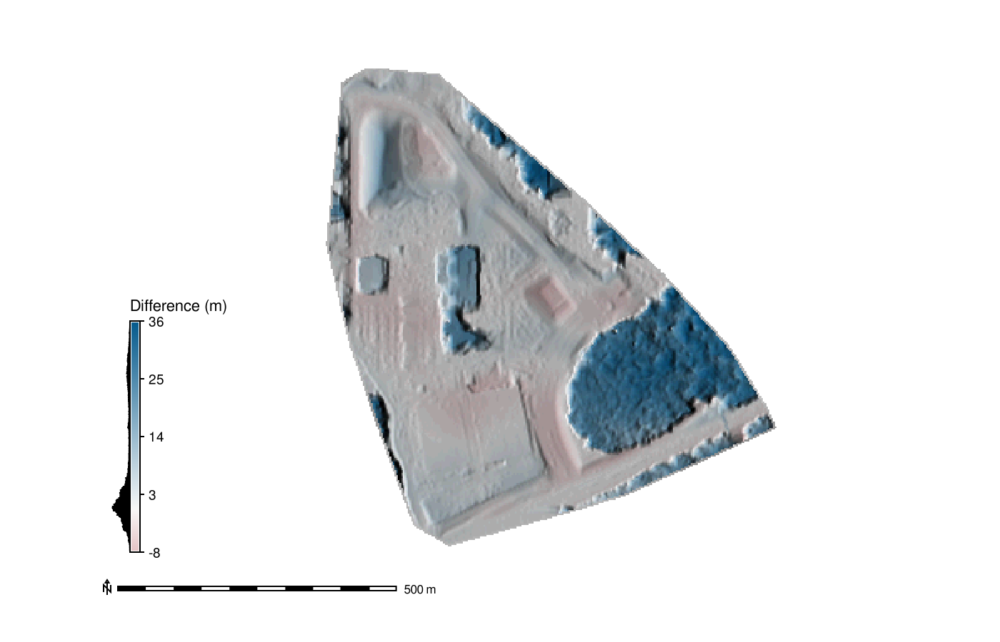

In [4754]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.colors",map="fenton_bare_earth_fused_diff_corrected", rules="grass_config/corrected_diff_colors.txt", flags="n")

gs.run_command("r.relief", input="fenton_bare_earth_fused_vertically_corrected_uas", output="fenton_bare_earth_fused_vertically_corrected_uas_relief", overwrite=True)
gs.run_command("r.shade", shade="fenton_bare_earth_fused_vertically_corrected_uas_relief", color="fenton_bare_earth_fused_diff_corrected", output="fenton_bare_earth_fused_diff_corrected_shaded_relief", overwrite=True)
!r.univar fenton_bare_earth_fused_diff_corrected -e

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_bare_earth_fused_diff_corrected.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_diff_corrected_shaded_relief")
fenton_bare_earth_fused_diff_map.d_legend(raster="fenton_bare_earth_fused_diff_corrected",
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

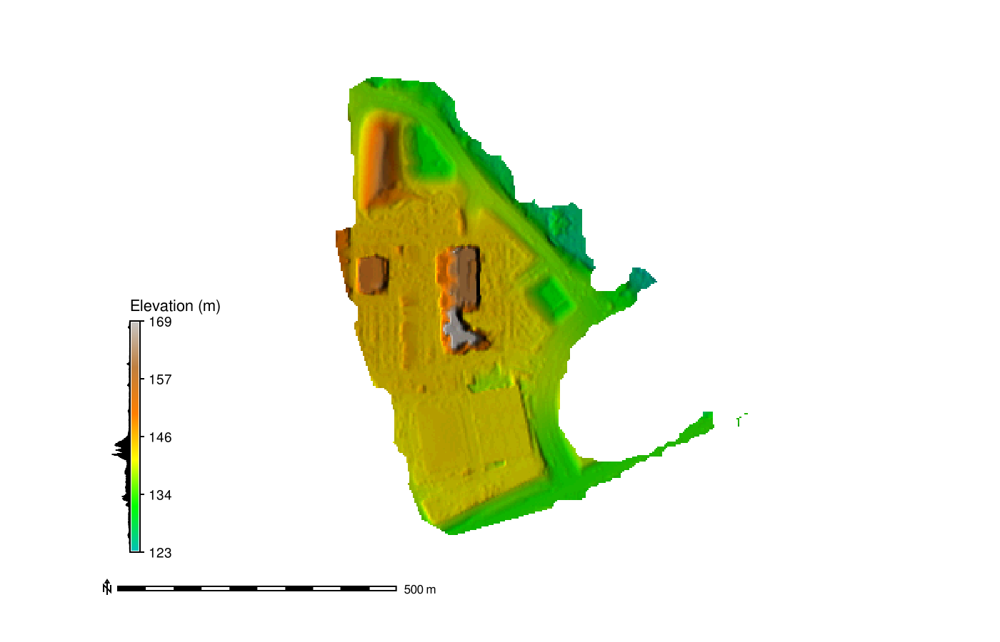

In [4644]:
# Building cats = 7,4 
gs.run_command("g.region",region="site_1", res=3, flags="pa")
# gs.run_command("r.fill.stats", input="bare_earth_thin", 
#                output="bare_earth_thin",
#                uncertainty="bare_earth_thin_filled_uncertainty",
#                mode="wmean",
#                power=4,
#                distance=16, flags="k")
gs.run_command("r.colors", map="bare_earth_thin", color="elevation")

shadedRelief(elevation="bare_earth_thin",relief="bare_earth_thin_relief", output="bare_earth_thin_shaded_relief")
# gs.run_command("r.fill.stats", input="ground_dem", output="bare_earth_dem_filled",uncertainty="bare_earth_dem_filled_uncertainty",mode="wmean",distance=100)
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/ground_dem.png")
fenton_bare_earth_fused_diff_map.d_erase()
# fenton_bare_earth_fused_diff_map.d_rast(map="ground_dem_shaded_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="bare_earth_thin_shaded_relief")
fenton_bare_earth_fused_diff_map.d_legend(raster="bare_earth_thin",
                                             at=(14,50,13,14),
                                             title="Elevation (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

### Variable Overlap

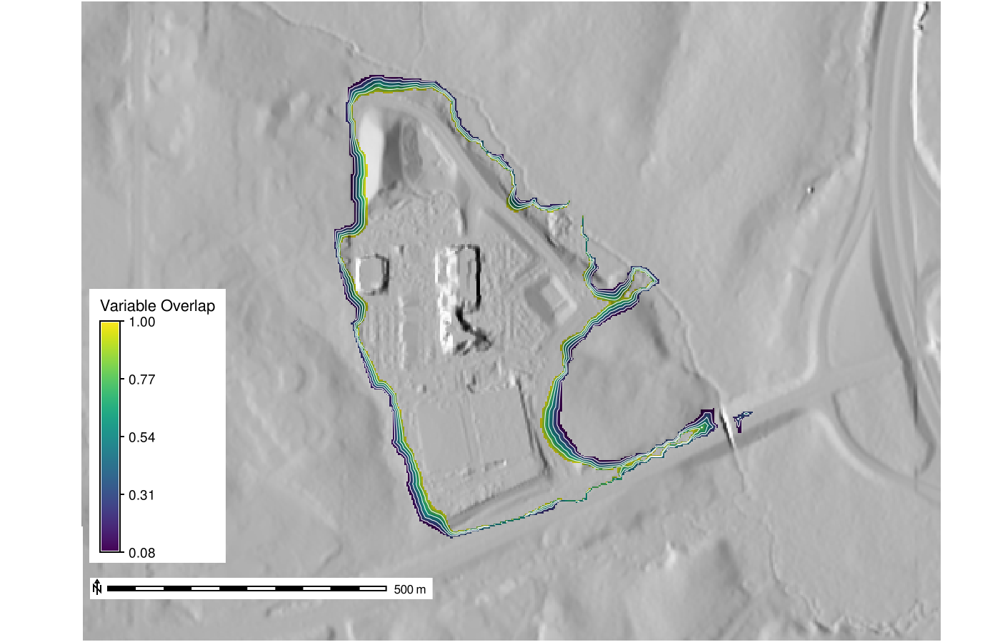

In [4770]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_overlap", output="fenton_bare_earth_fused_overlap_shaded_relief", overwrite=True)
gs.run_command("r.contour",overwrite=True, input="fenton_bare_earth_fused_overlap", output="fenton_bare_earth_fused_overlap_contours",step=0.2)
fenton_bare_earth_fused_overlap_map = gj.GrassRenderer(height=900, width=1400, filename="output/fenton_bare_earth_fused_overlap.png")
fenton_bare_earth_fused_overlap_map.d_erase()
fenton_bare_earth_fused_overlap_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_overlap_map.d_rast(map="fenton_bare_earth_fused_overlap_shaded_relief")
fenton_bare_earth_fused_overlap_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="white", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_overlap_map.d_legend(raster="fenton_bare_earth_fused_overlap",
                                             # label_values="0.2,0.4,0.6,0.8", labelnum=5,
                                             at=(14,50,10,12),
                                             title="Variable Overlap", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="bt")
fenton_bare_earth_fused_overlap_map.d_barscale(at=(9,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_overlap_map.show()

### DEMs

#### USGS DEM

Image Save Location: output/ned_19sec_site_priority_1_shaded_relief.png


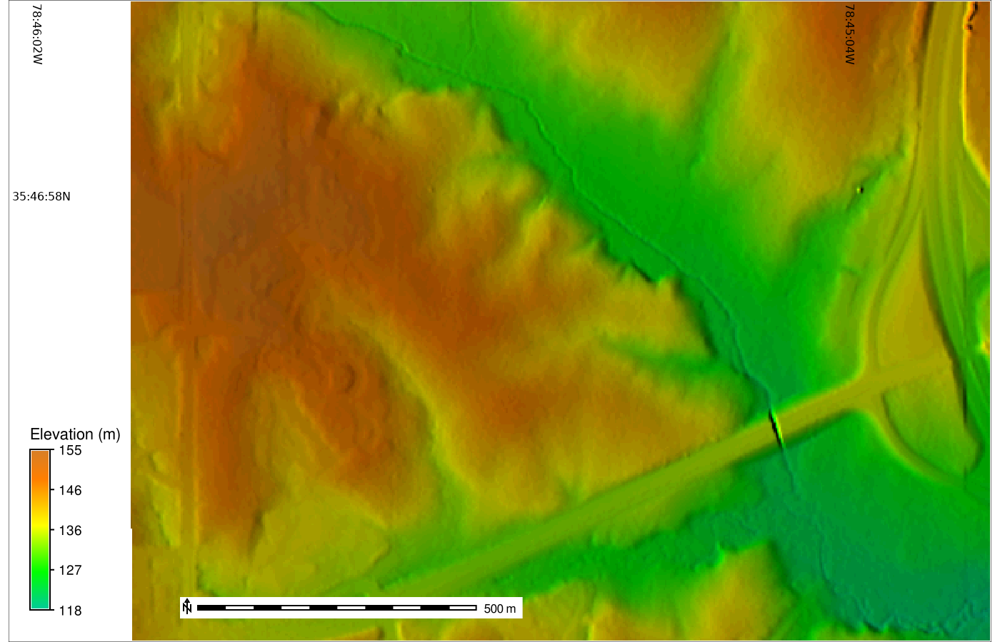

In [4795]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
def generate_elevation_figure(elev, filename):
    """
    Generates a shade png image of an elevation (DTM, DSM)
    @param elev : string : Name of raster
    @param filename: string: Name of file
    """
    relief = f"{elev}_relief"
    shaded_relief = f"{elev}_shaded_relief"
    shadedRelief(elevation=elev,relief=relief, output=shaded_relief)
    output = f"output/{filename}.png"
    print(f"Image Save Location: {output}")
    elev_map = gj.GrassRenderer(height=900, width=1400, filename=output)
    elev_map.d_erase()
    elev_map.d_rast(map=shaded_relief)
    # elev_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=2, legend_label="Fenton (White Area)")
    elev_map.d_legend(raster=elev, at=(5,30,3,5),
                      title="Elevation (m)",font="FreeSans", border_color="none",
                      title_fontsize=16, fontsize=14, 
                      flags="bt")
    elev_map.d_barscale(at=(18,7), units="meters", flags="n",font="FreeSans")
    elev_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)

    return elev_map.show()


view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")
generate_elevation_figure(elev="ned_19sec_site_priority_1", filename="ned_19sec_site_priority_1_shaded_relief")

#### Fused DEM

Image Save Location: output/fenton_bare_earth_shaded_relief.png


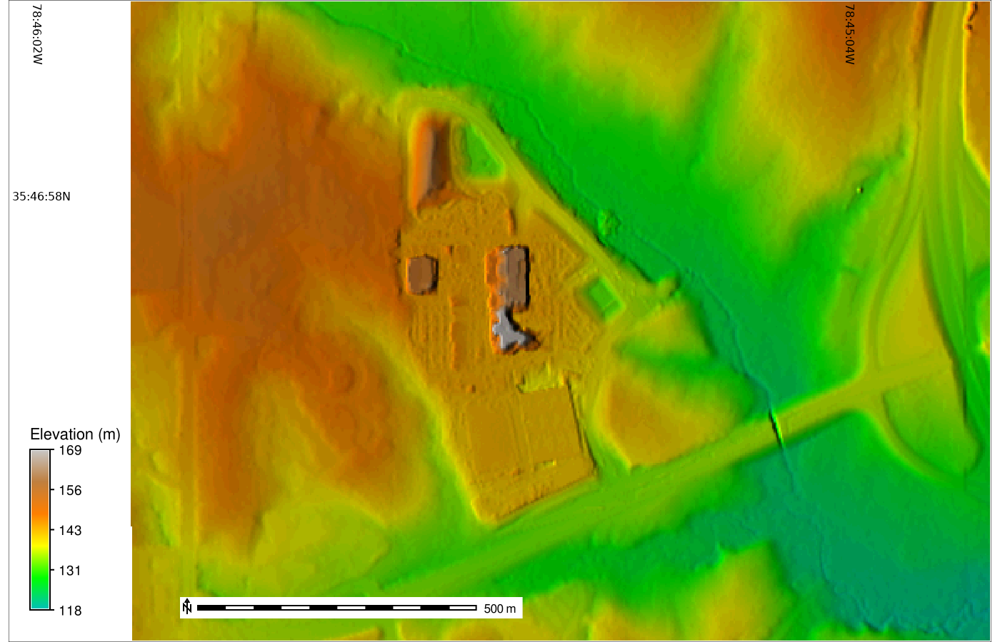

In [4794]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")

view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

generate_elevation_figure(elev="fenton_bare_earth_fused", filename="fenton_bare_earth_shaded_relief")

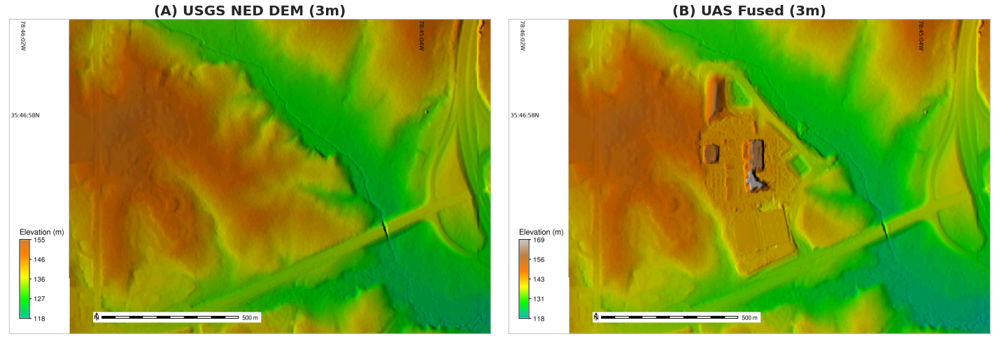

In [4796]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img_ortho = Image.open("output/ned_19sec_site_priority_1_shaded_relief.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('(A) USGS NED DEM (3m)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img1 = Image.open("output/fenton_bare_earth_shaded_relief.png")
imgplot = plt.imshow(img1)
ax.set_title('(B) UAS Fused (3m)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/cary_town_blvd_dtm_3m_fusion.png",bbox_inches='tight', dpi=300)

### Slopes

#### USGS Slope

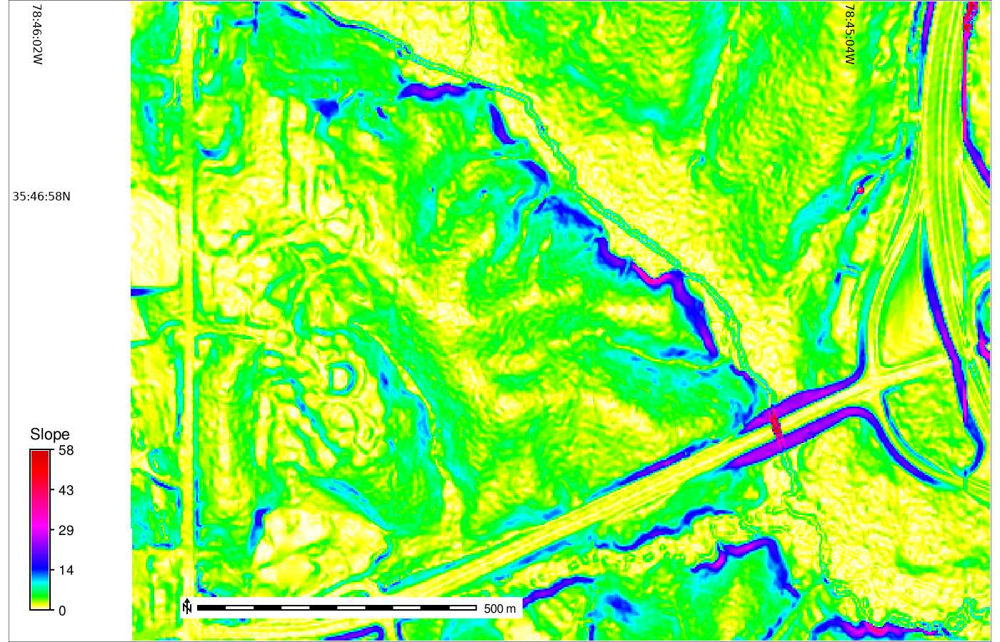

In [4798]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.slope.aspect", elevation="ned_19sec_site_priority_1", slope="ned_19sec_site_priority_1_3m_slope_3m", aspect="ned_19sec_site_priority_1_3m_aspect_3m", overwrite=True)
view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")
ned_19sec_site_priority_1_3m_slope_3m_map = gj.GrassRenderer(height=900, width=1400,filename="output/ned_19sec_site_priority_1_3m_slope_3m_slope.png")
ned_19sec_site_priority_1_3m_slope_3m_map.d_erase()
ned_19sec_site_priority_1_3m_slope_3m_map.d_rast(map="ned_19sec_site_priority_1_3m_slope_3m")


ned_19sec_site_priority_1_3m_slope_3m_map.d_legend(raster="ned_19sec_site_priority_1_3m_slope_3m", at=(5,30,3,5),
                      title="Slope",font="FreeSans", border_color="none",
                      title_fontsize=16, fontsize=14, 
                      flags="bt")
ned_19sec_site_priority_1_3m_slope_3m_map.d_barscale(at=(18,7), units="meters", flags="n",font="FreeSans")
ned_19sec_site_priority_1_3m_slope_3m_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)
ned_19sec_site_priority_1_3m_slope_3m_map.show()

#### Fused Slope

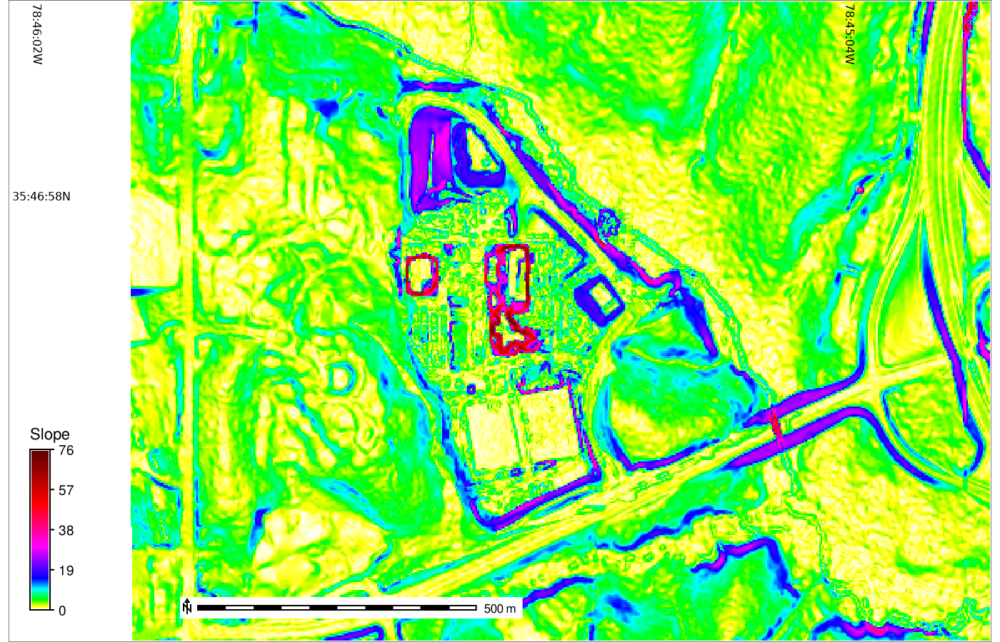

In [4799]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.slope.aspect", elevation="fenton_bare_earth_fused", slope="fenton_bare_earth_fused_slope_3m", aspect="fenton_bare_earth_fused_aspect_3m", overwrite=True)
view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")
fenton_fused_f1_3m_slope_3m_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_fused_f1_3m_slope_3m_slope.png")
fenton_fused_f1_3m_slope_3m_map.d_erase()
fenton_fused_f1_3m_slope_3m_map.d_rast(map="fenton_bare_earth_fused_slope_3m")
# fenton_fused_f1_3m_slope_3m_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="black", width="2",legend_label="Fenton (White Area)")

# fenton_fused_f1_3m_slope_3m_map.d_legend(raster="fenton_bare_earth_fused_slope_3m", at=(13,50,10,12),
#                       title="Slope",font="FreeSans", border_color="none",
#                       title_fontsize=16, fontsize=14, 
#                       flags="bt")
# fenton_fused_f1_3m_slope_3m_map.d_barscale(at=(9,7), units="meters", flags="n",font="FreeSans")

fenton_fused_f1_3m_slope_3m_map.d_legend(raster="fenton_bare_earth_fused_slope_3m", at=(5,30,3,5),
                      title="Slope",font="FreeSans", border_color="none",
                      title_fontsize=16, fontsize=14, 
                      flags="bt")
fenton_fused_f1_3m_slope_3m_map.d_barscale(at=(18,7), units="meters", flags="n",font="FreeSans")
fenton_fused_f1_3m_slope_3m_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)
fenton_fused_f1_3m_slope_3m_map.show()

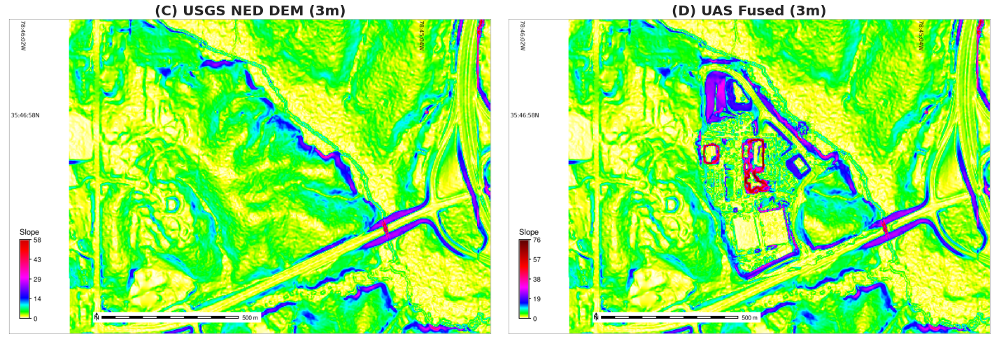

In [4802]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/ned_19sec_site_priority_1_3m_slope_3m_slope.png")
imgplot = plt.imshow(img1)
ax.set_title('(C) USGS NED DEM (3m)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img2 = Image.open("output/fenton_fused_f1_3m_slope_3m_slope.png")
imgplot = plt.imshow(img2)
ax.set_title('(D) UAS Fused (3m)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fenton_fusion_slope_fig.png",bbox_inches='tight',dpi=300)

#### Difference (Fused Slope - USGS Slope)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 6854

Of the non-null cells:
----------------------
n: 195898
minimum: -23.936
maximum: 72.9721
range: 96.9081
mean: 0.642864
mean of absolute values: 1.07926
standard deviation: 4.48827
variance: 20.1446
variation coefficient: 698.169 %
sum: 125935.759373441
1st quartile: 0
median (even number of cells): 0
3rd quartile: 0
90th percentile: 0


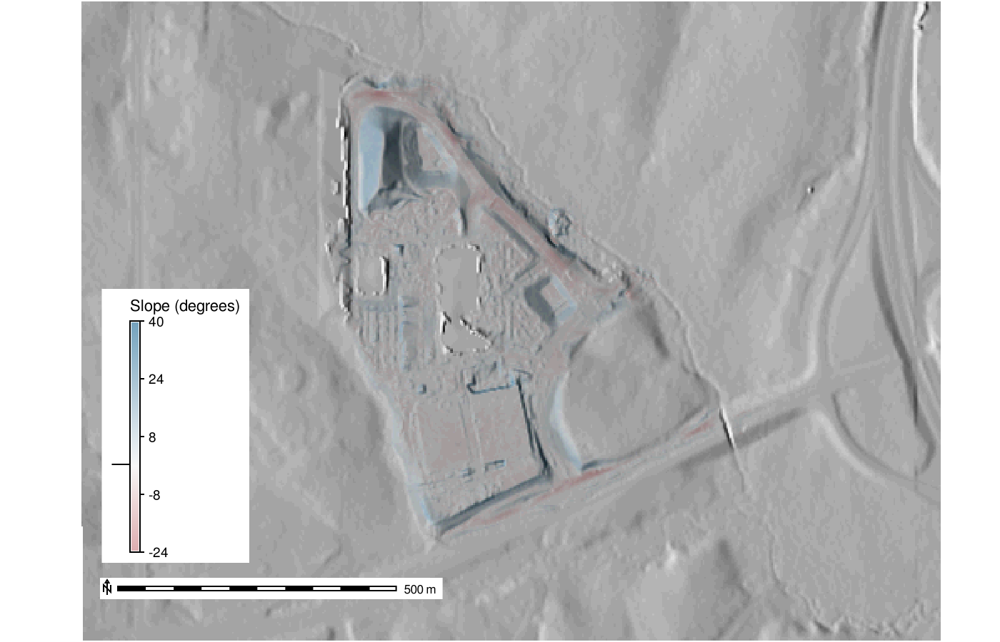

In [4169]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.mapcalc("diff_slope_fused_dem_usgs_dem = fenton_bare_earth_fused_slope_3m - ned_19sec_site_priority_1_3m_slope_3m")
gs.run_command("r.colors",map="diff_slope_fused_dem_usgs_dem", rules="grass_config/diff_slope_color.txt", flags="n")

# gs.run_command("r.relief", input="fenton_bare_earth_fused_vertically_corrected_uas", output="fenton_bare_earth_fused_vertically_corrected_uas_relief", overwrite=True)
# gs.run_command("r.shade", shade="fenton_bare_earth_fused_aspect_3m", color="diff_fused_dem_usgs_dem", output="diff_fused_dem_usgs_dem_shaded_relief", overwrite=True)
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="diff_slope_fused_dem_usgs_dem", output="diff_slope_fused_dem_usgs_dem_shaded_relief", overwrite=True)

# fenton_bare_earth_fused
!r.univar diff_fused_dem_usgs_dem -e

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/diff_slope_fused_dem_usgs_dem.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="diff_slope_fused_dem_usgs_dem_shaded_relief")
fenton_bare_earth_fused_diff_map.d_legend(raster="diff_slope_fused_dem_usgs_dem",
                                             at=(14,50,13,14),
                                             title="Slope (degrees)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

#### Difference (USA Slope - USGS Slope)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 166008

Of the non-null cells:
----------------------
n: 36744
minimum: -51.359
maximum: 58.6822
range: 110.041
mean: 2.54262
mean of absolute values: 5.96538
standard deviation: 8.99574
variance: 80.9233
variation coefficient: 353.798 %
sum: 93425.9313906729
1st quartile: -2.39547
median (even number of cells): 0.375138
3rd quartile: 5.13957
90th percentile: 14.7702


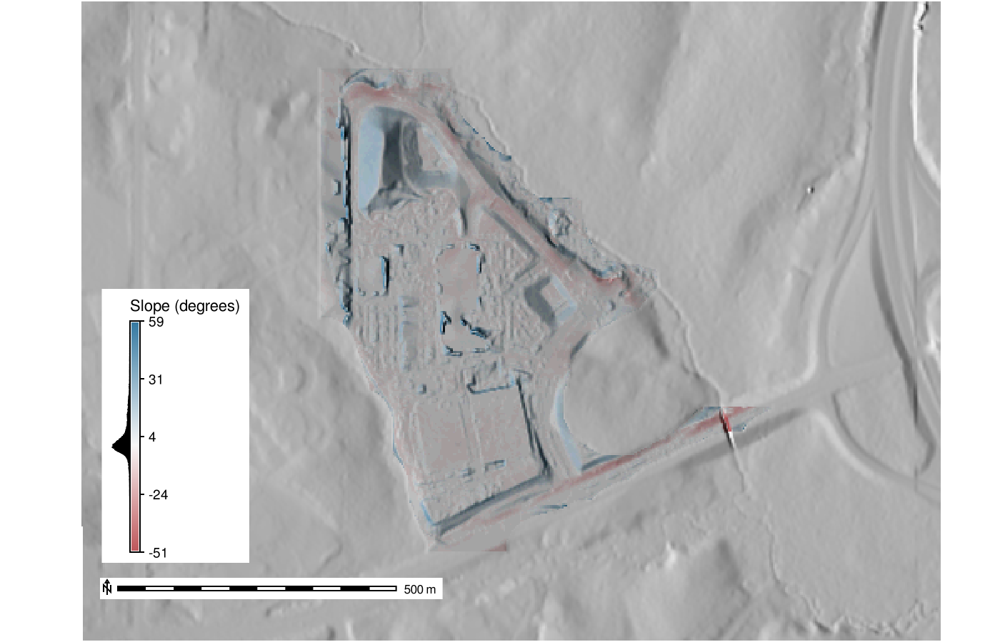

In [4170]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.slope.aspect", elevation="bare_earth_thin", slope="bare_earth_thin_slope_3m", aspect="bare_earth_thin_aspect_3m", overwrite=True)

gs.mapcalc("diff_sloep_bare_earth_thin_dem_usgs_dem = bare_earth_thin_slope_3m - ned_19sec_site_priority_1_3m_slope_3m")


gs.run_command("r.colors",map="diff_sloep_bare_earth_thin_dem_usgs_dem", rules="grass_config/diff_slope_color.txt", flags="n")

# gs.run_command("r.relief", input="fenton_bare_earth_fused_vertically_corrected_uas", output="fenton_bare_earth_fused_vertically_corrected_uas_relief", overwrite=True)
# gs.run_command("r.shade", shade="fenton_bare_earth_fused_aspect_3m", color="diff_fused_dem_usgs_dem", output="diff_fused_dem_usgs_dem_shaded_relief", overwrite=True)
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="diff_sloep_bare_earth_thin_dem_usgs_dem", output="diff_sloep_bare_earth_thin_dem_usgs_dem_shaded_relief", overwrite=True)

# fenton_bare_earth_fused
!r.univar diff_sloep_bare_earth_thin_dem_usgs_dem -e

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/diff_sloep_bare_earth_thin_dem_usgs_dem.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="diff_sloep_bare_earth_thin_dem_usgs_dem_shaded_relief")
fenton_bare_earth_fused_diff_map.d_legend(raster="diff_sloep_bare_earth_thin_dem_usgs_dem",
                                             at=(14,50,13,14),
                                             title="Slope (degrees)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

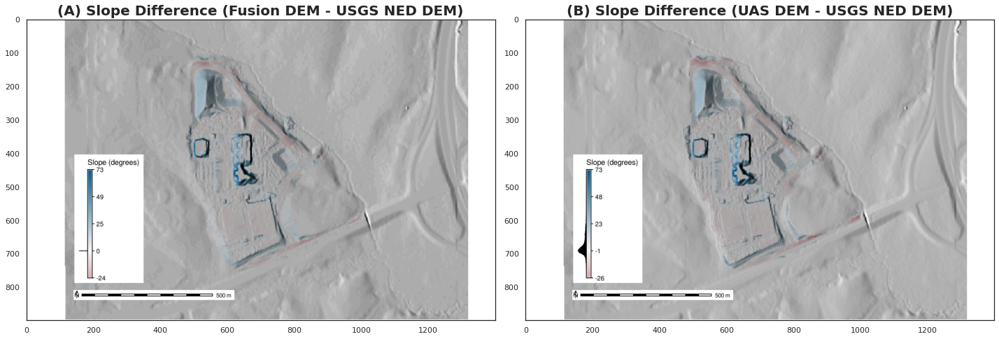

In [3676]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
# ax.set_axis_off()
img1 = Image.open("output/diff_slope_fused_dem_usgs_dem.png")
imgplot = plt.imshow(img1)
ax.set_title('(A) Slope Difference (Fusion DEM - USGS NED DEM)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
# ax.set_axis_off()
img2 = Image.open("output/diff_sloep_bare_earth_thin_dem_usgs_dem.png")
imgplot = plt.imshow(img2)
ax.set_title('(B) Slope Difference (UAS DEM - USGS NED DEM)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fusion_slope_diff_figures.png",bbox_inches='tight',dpi=300)

### USGS DEM + Fused DEM (DEM and Slope Figure)

Image Save Location: output/feton_geomorphology_fig.png


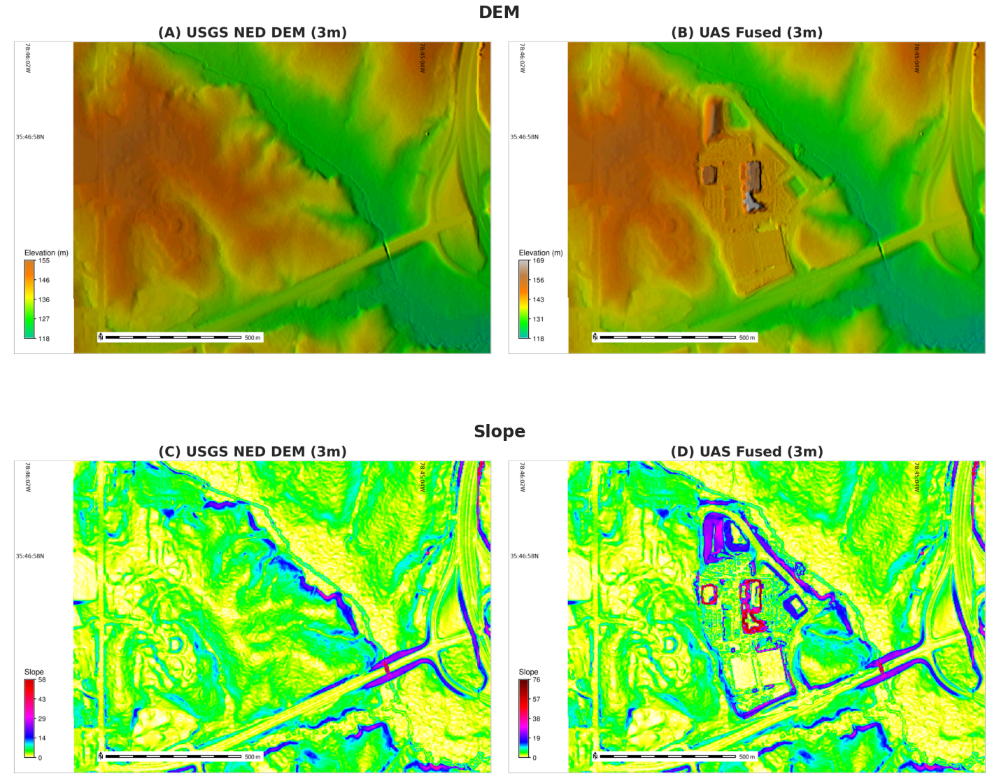

In [4803]:
create_3_flight_figure(
    input_1="cary_town_blvd_dtm_3m_fusion",
    title_1="DEM",
    input_2="fenton_fusion_slope_fig", 
    title_2="Slope", 
    input_3="fenton_fusion_aspect_fig", 
    title_3="Aspect", 
    filename="feton_geomorphology_fig"
)

### Absolute Difference (USGS and Fusion)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 325428
total null cells: 287380

Of the non-null cells:
----------------------
n: 38048
minimum: 3.09193e-05
maximum: 17.2604
range: 17.2604
mean: 2.20817
mean of absolute values: 2.20817
standard deviation: 2.17323
variance: 4.72294
variation coefficient: 98.4178 %
sum: 84016.4704004965
1st quartile: 0.647865
median (even number of cells): 1.60968
3rd quartile: 3.20759
90th percentile: 4.65737


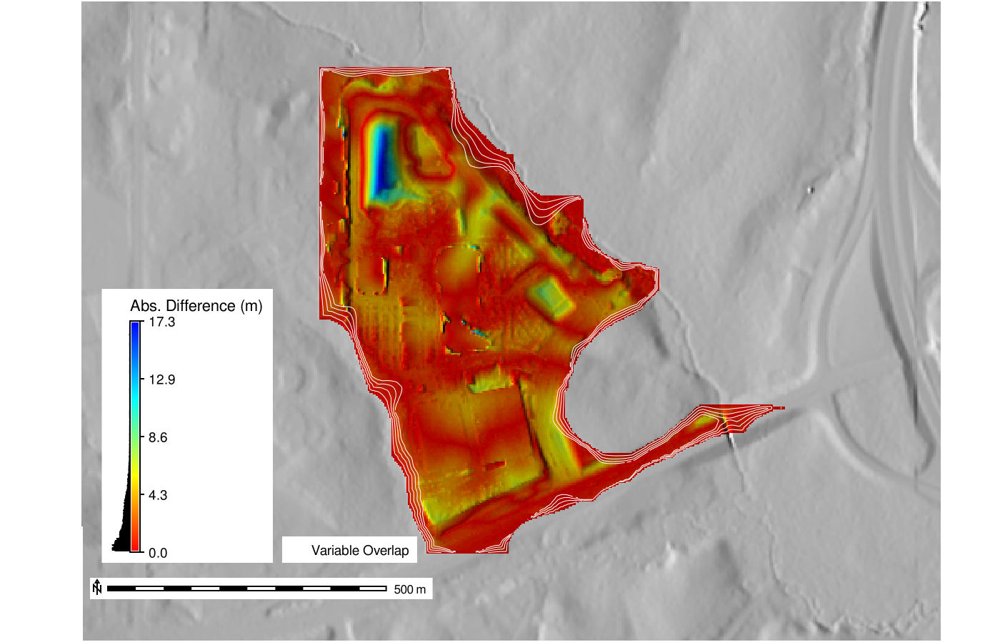

In [4171]:
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
# gs.mapcalc(f"fenton_bare_earth_fused_abs_diff = if(bare_earth_smooth,abs(fenton_bare_earth_fused - ned_19sec_site_priority_1), null())")
gs.mapcalc(f"fenton_bare_earth_fused_abs_diff = if(bare_earth_thin,abs(fenton_bare_earth_fused - ned_19sec_site_priority_1), null())")

gs.run_command("r.colors",map="fenton_bare_earth_fused_abs_diff", color="bcyr", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_abs_diff", output="fenton_bare_earth_fused_abs_diff_shaded_relief", overwrite=True)
!r.univar fenton_bare_earth_fused_abs_diff -e
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fenton_bare_earth_fused_abs_diff_map = gj.GrassRenderer(height=900,width=1400,filename="output/fenton_bare_earth_fused_abs_diff.png")
fenton_bare_earth_fused_abs_diff_map.d_erase()
fenton_bare_earth_fused_abs_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_abs_diff_map.d_rast(map="fenton_bare_earth_fused_abs_diff_shaded_relief")
fenton_bare_earth_fused_abs_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="white", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_abs_diff_map.d_legend_vect(at=(29,16.25),font="FreeSans", flags="b",border_color="none")
fenton_bare_earth_fused_abs_diff_map.d_legend(raster="fenton_bare_earth_fused_abs_diff",
                                             at=(14,50,13,14),
                                             title="Abs. Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_abs_diff_map.d_barscale(at=(9,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_abs_diff_map.show()


### Total Difference (USGS and Fusion)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 5060

Of the non-null cells:
----------------------
n: 197692
minimum: -8.40063
maximum: 26.1634
range: 34.564
mean: 0.179838
mean of absolute values: 0.462503
standard deviation: 1.83678
variance: 3.37377
variation coefficient: 1021.35 %
sum: 35552.5805186159
1st quartile: 0
median (even number of cells): 0
3rd quartile: 0
90th percentile: 0


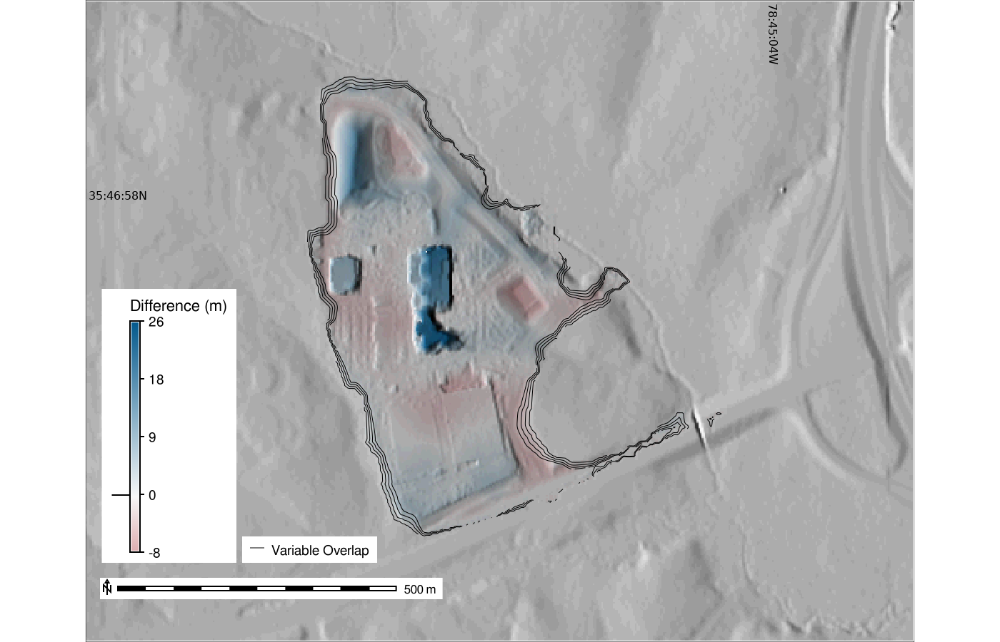

In [4806]:

# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")

# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map="fenton_bare_earth_fused_diff", rules="grass_config/diff_colors.txt", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_diff", output="fenton_bare_earth_fused_diff_shaded_relief", overwrite=True)
!r.univar fenton_bare_earth_fused_diff -e
gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 100
gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_bare_earth_fused_diff.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster="fenton_bare_earth_fused_diff",
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)

fenton_bare_earth_fused_diff_map.show()


### Edge (Corrected UAS and USGS DEM)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 201446

Of the non-null cells:
----------------------
n: 1306
minimum: -5.82528
maximum: 6.41232
range: 12.2376
mean: 0.11751
mean of absolute values: 1.7556
standard deviation: 2.25885
variance: 5.10242
variation coefficient: 1922.27 %
sum: 153.467617286313
1st quartile: -1.09818
median (even number of cells): 0.0646473
3rd quartile: 1.53009
90th percentile: 3.04725
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 201412

Of the non-null cells:
----------------------
n: 1340
minimum: -5.61252
maximum: 5.85929
range: 11.4718
mean: 0.0294324
mean of absolute values: 1.70046
standard deviation: 2.18399
variance: 4.76983
variation coefficient: 7420.3

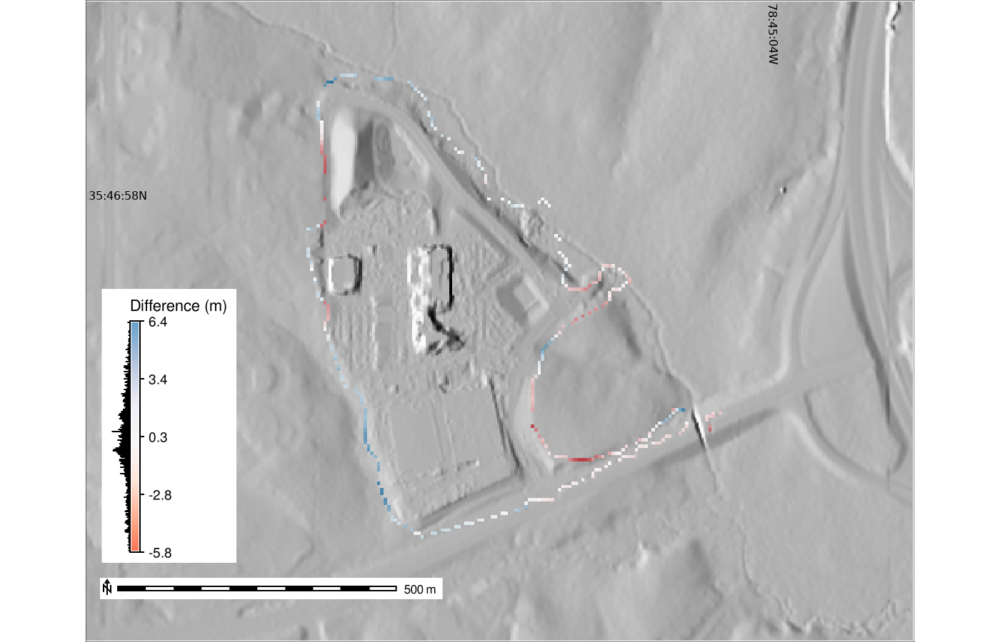

In [4807]:
# Generate Edge
# gs.run_command("r.mask",flags="r")

gs.run_command("g.region",region="site_1", res=3, flags="pa")

# Create mask of UAS bare earth DEM
# gs.mapcalc(f"bare_earth_mask = if(bare_earth_smooth,1,null())")
gs.mapcalc(f"bare_earth_mask = if(bare_earth_thin,1,null())")
# Create raster of the difference between the Vertically Corrected UAS and USGS NED DEM
# gs.mapcalc(f"fenton_bare_earth_ned_diff = if(bare_earth_mask,bare_earth_smooth - ned_19sec_site_priority_1, null())")
gs.mapcalc(f"fenton_bare_earth_ned_diff = if(bare_earth_mask,bare_earth - ned_19sec_site_priority_1, null())")

# Create raster 2 pixels smaller than bare earth dem
gs.run_command("r.grow", overwrite=True, input="bare_earth_mask", output="bare_earth_thin_edge", radius=-2)
# Assign int values of UAS - DEM to pixels representing the bare earth dem boarder.
# The raster needs to be of TYPE CELL to work with r.thin below
gs.mapcalc(f"fenton_bare_earth_ned_edge_diff = if(bare_earth_mask && isnull(bare_earth_thin_edge), fenton_bare_earth_ned_diff, null())")
!r.univar fenton_bare_earth_ned_edge_diff -e
# Thin boarder so it can be converted to raster
# gs.run_command("r.thin", overwrite=True, input="fenton_bare_earth_ned_edge_diff", output="fenton_bare_earth_ned_edge_diff_vect_thin")
# Add float boarder differences to thinned raster
# gs.mapcalc(f"fenton_bare_earth_ned_edge_diff1 = if(fenton_bare_earth_ned_edge_diff_vect_thin, fenton_bare_earth_ned_diff, null())")
# Convert thinned boarder raster to vector
# gs.run_command("r.to.vect", input="fenton_bare_earth_ned_edge_diff1", output="fenton_bare_earth_ned_edge_diff", type="line", overwrite=True)
# Assign Color schemes and shade
# gs.run_command("v.colors", map="fenton_bare_earth_ned_edge_diff", use="attr", column="value", rules="grass_config/diff_edge.txt", flags="n")
# Make edge thick to visulize
gs.run_command("g.region",region="site_1", res=6, flags="pa")
gs.run_command("r.resamp.interp", input="fenton_bare_earth_ned_edge_diff", output="fenton_bare_earth_ned_edge_diff_10m", overwrite=True, method="nearest")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.colors",map="fenton_bare_earth_ned_edge_diff_10m", rules="grass_config/diff_edge.txt", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_ned_edge_diff_10m", output="fenton_bare_earth_ned_edge_diff_shaded_relief", overwrite=True)


# Generate Overlap Contours

!r.univar fenton_bare_earth_ned_edge_diff_10m -e

view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 100
gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")

fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_bare_earth_ned_edge_diff_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff_10m")
# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.25", legend_label="Variable Overlap")

# fenton_bare_earth_edge_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_edge_diff_map.d_legend(raster="fenton_bare_earth_ned_edge_diff",
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)

fenton_bare_earth_edge_diff_map.show()
# !r.univar fenton_bare_earth_fused_diff -e
# !r.univar fenton_bare_earth_diff -e

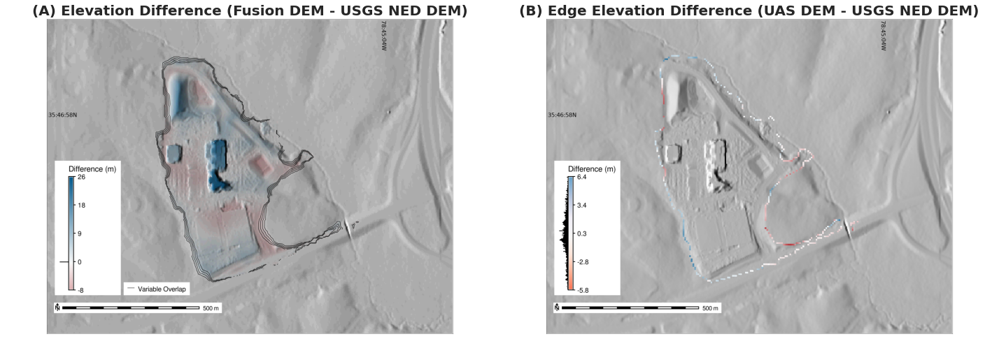

In [4808]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/fenton_bare_earth_fused_diff.png")
imgplot = plt.imshow(img1)
ax.set_title('(A) Elevation Difference (Fusion DEM - USGS NED DEM)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img2 = Image.open("output/fenton_bare_earth_ned_edge_diff_map.png")
imgplot = plt.imshow(img2)
ax.set_title('(B) Edge Elevation Difference (UAS DEM - USGS NED DEM)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fusion_diff_figures.png",bbox_inches='tight',dpi=300)

### Extract Stormwater Inlets and Gravity Mains from Town of Cary

In [3351]:

gs.run_command("r.to.vect", input="bare_earth_mask_thin", output="bare_earth_mask_thin", type="area", overwrite=True)

# https://data.wakegov.com/datasets/carync::storm-inlets/about
# https://opendata.arcgis.com/datasets/0bd48809ae264e848532188b893df894_35.geojson
!v.select -c --overwrite ainput=Cary_Stormwater_Network_Inlets binput=bare_earth_mask_thin output=site_1_inlets operator=within

# https://data.wakegov.com/datasets/carync::storm-gravity-mains/about
# https://opendata.arcgis.com/datasets/0bd48809ae264e848532188b893df894_31.geojson
!v.select -c --overwrite ainput=Cary_Stormwater_Network_Gravity_Mains binput=bare_earth_mask_thin output=site_1_gravity_mains operator=within

Processing features...
   0  25  50  75 100
Processing areas...
   0  50 100
Writing selected features...
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
Writing attributes...
Building topology for vector map <site_1_inlets@rapid-dsm>...
Registering primitives...
v.select complete. 10 features written to output.
Processing features...
   0  25  50  75 100
Processing areas...
   0  50 100
         overwritten
Writing selected features...
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
Writing attributes...
Building topology for vector map <site_1_gravity_mains@rapid-dsm>...
Registering primitives...
v.select complete. 9 features written to output.


In [3352]:
import pandas as pd
import sqlite3
 
# Read in the attribute table
sqlpath = gs.read_command("db.databases", driver="sqlite").replace('\n', '')
con = sqlite3.connect(sqlpath)
sqlstat="SELECT * FROM site_1_inlets"
df_inlets = pd.read_sql_query(sqlstat, con)
con.close()
df_profile = df_inlets[['cat','FACILITYID','RIMELEV', 'INLETTYPE']][df_inlets.RIMELEV> 0]
df_profile.head()

,cat,FACILITYID,RIMELEV,INLETTYPE
0,3617,DP77305061,435.23,Yard
1,3618,DP77306010,437.60,Yard
2,3619,DP77306002,444.40,Yard
4,30778,DP77306019,441.28,Yard
5,30779,DP77305094,439.21,Yard


In [4809]:
# !r.what -n -v map=bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1 points=site_1_inlets
gs.parse_command("r.what", map="bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1", points="site_1_inlets", flags="nv", output="output/inlet_elevations.csv")
df_inlet_dem_elevs = pd.read_csv("output/inlet_elevations.csv",sep="|")
df_inlet_dem_elevs = df_inlet_dem_elevs.drop(['site_name'], axis=1)
df_inlet_dem_elevs.head(10)

,cat,easting,northing,bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1
0,3617,631623.47076,224987.204574,133.095230,133.095230,133.5082
1,3618,631748.74386,225045.603274,133.636707,134.100639,137.9426
2,3619,631960.66406,225122.242074,134.045873,134.806423,135.0465
3,4220,631617.06996,225000.724474,135.841048,135.841048,133.7924
4,30778,631762.51316,225027.431374,133.863539,133.863539,134.0154
5,30779,631694.29116,225064.871974,133.289918,133.659982,139.0885
6,30780,631702.84086,225048.581974,133.065975,133.065975,138.3381
7,30781,631690.23736,225038.681774,133.398722,133.398722,137.6727
8,30782,631673.86196,225025.991674,133.622863,133.622863,136.8225
9,30783,631668.64226,225008.351474,133.185445,133.185445,134.9834


In [4810]:
df_inlet_elves = df_profile.set_index('cat').join(df_inlet_dem_elevs.set_index('cat'),on="cat",lsuffix="_inlets", rsuffix="_dem", how="outer")
df_inlet_elves = df_inlet_elves.dropna(axis='rows')

def perc_err(t, e):
    err = abs(round((( e - t ) / t) * 100,2))
    return err


# df_inlet_elves.info()
df_inlet_elves['inlet_rim_m'] = df_inlet_elves.apply(lambda x: x['RIMELEV'] / 3.2808, axis=1)
df_inlet_elves['USGS NED DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['ned_19sec_site_priority_1']), axis=1)
df_inlet_elves['Fused UAS DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['fenton_bare_earth_fused']), axis=1)
df_inlet_elves['UAS DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['bare_earth_thin']), axis=1)

df_inlet_elves['USGS NED Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['ned_19sec_site_priority_1'], axis=1)
df_inlet_elves['Fused UAS Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['fenton_bare_earth_fused'], axis=1)
df_inlet_elves['UAS DEM Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['bare_earth_thin'] , axis=1)

df_inlet_latex = df_inlet_elves.drop(['cat','INLETTYPE','RIMELEV','easting','northing'],axis=1).rename(columns={
    # "easting":"x",
    # "northing": "y",
    "inlet_rim_m": "Inlet Rim Elev",
    "bare_earth_thin": "UAS DEM",
    "fenton_bare_earth_fused": "Fused UAS DEM",
    "ned_19sec_site_priority_1": "USGS NED DEM"
}, errors="raise")
df_inlet_latex = df_inlet_latex[['FACILITYID','Inlet Rim Elev','USGS NED DEM','USGS NED Diff',"UAS DEM",'UAS DEM Diff',"Fused UAS DEM",'Fused UAS Diff']].round(2)

caption = "The inlets ..."

print(df_inlet_latex.to_latex(index=False,bold_rows=True, caption=caption))

\begin{table}
\centering
\caption{The inlets ...}
\begin{tabular}{lrrrrrrr}
\toprule
FACILITYID &  Inlet Rim Elev &  USGS NED DEM &  USGS NED Diff &  UAS DEM &  UAS DEM Diff &  Fused UAS DEM &  Fused UAS Diff \\
\midrule
DP77305061 &          132.66 &        133.51 &          -0.85 &   133.10 &         -0.44 &         133.10 &           -0.44 \\
DP77306010 &          133.38 &        137.94 &          -4.56 &   133.64 &         -0.25 &         134.10 &           -0.72 \\
DP77306002 &          135.45 &        135.05 &           0.41 &   134.05 &          1.41 &         134.81 &            0.65 \\
DP77306019 &          134.50 &        134.02 &           0.49 &   133.86 &          0.64 &         133.86 &            0.64 \\
DP77305094 &          133.87 &        139.09 &          -5.22 &   133.29 &          0.58 &         133.66 &            0.21 \\
DP77306020 &          133.61 &        138.34 &          -4.73 &   133.07 &          0.54 &         133.07 &            0.54 \\
DP77305095 &     

In [4811]:
df_inlet_elves[['USGS NED DEM % Error','Fused UAS DEM % Error','UAS DEM % Error']].describe()


,USGS NED DEM % Error,Fused UAS DEM % Error,UAS DEM % Error
count,9.000000,9.000000,9.000000
mean,2.116667,0.316667,0.371111
std,1.440642,0.174929,0.289717
min,0.300000,0.030000,0.030000
25%,0.640000,0.170000,0.190000
50%,2.430000,0.330000,0.330000
75%,3.420000,0.480000,0.440000
max,3.900000,0.540000,1.040000


#### RMSE

In [4812]:
def rmse(predictions, targets):
    # print((df_inlet_latex[predictions] - df_inlet_latex[targets]) ** 2)
    return np.sqrt(((df_inlet_latex[predictions] - df_inlet_latex[targets]) ** 2).mean())

usgs_dem_rmse = rmse('USGS NED DEM', 'Inlet Rim Elev')
print(f"USGS DEM RMSE: {usgs_dem_rmse}")
uas_dem_rmse = rmse('UAS DEM', 'Inlet Rim Elev')
print(f"UAS DEM RMSE: {uas_dem_rmse}")
fused_dem_rmse = rmse('Fused UAS DEM', 'Inlet Rim Elev')
print(f"Fused UAS DEM RMSE: {fused_dem_rmse}")

# from sklearn.metrics import mean_squared_error
# from math import sqrt

# rms = sqrt(mean_squared_error(y_actual, y_predicted))
# df_inlet_elves['USGS NED DEM RMSE'] = df_inlet_elves.apply(lambda x: rmse(x['inlet_rim_m'],x['ned_19sec_site_priority_1'], x.count()), axis=1)


USGS DEM RMSE: 3.359078908140006
UAS DEM RMSE: 0.6172429739485763
Fused UAS DEM RMSE: 0.4757450297515798


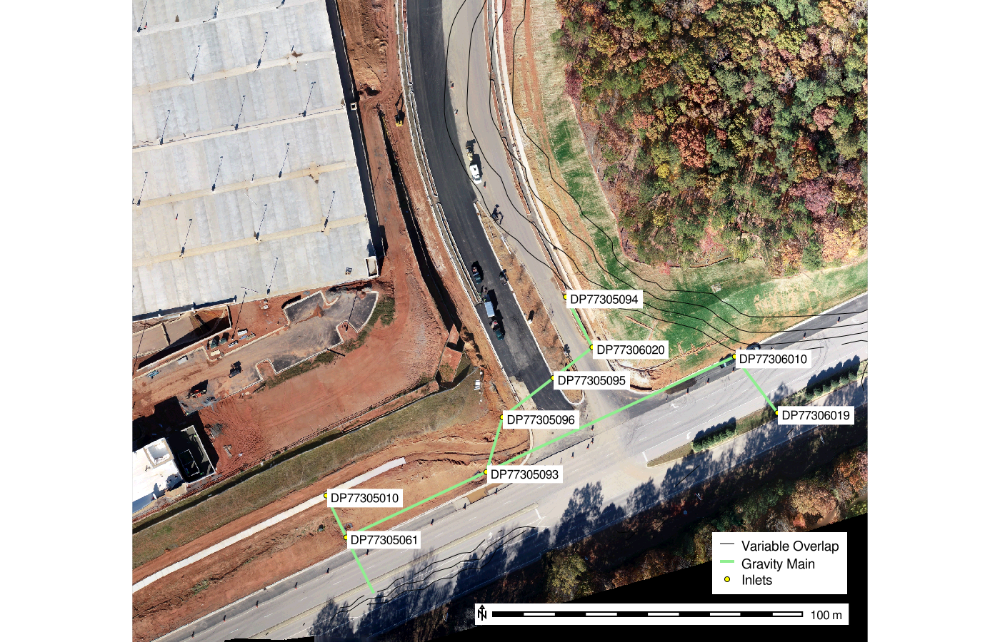

In [3376]:
gs.run_command("g.region",region="region_site_1_inlets", res=0.05, flags="pa")

fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_inlets_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff1")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_odm_ortho_composite_5cm")


fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="144:238:144:255", width="4", legend_label="Gravity Main")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=14, color="black",
                                       type="point",
                                       legend_label="Inlets",
                                       attribute_column="FACILITYID",label_size=12, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans"
                                      )


fenton_bare_earth_edge_diff_map.d_legend_vect(at=(72,17),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_edge_diff_map.d_legend(raster="fenton_bare_earth_ned_edge_diff1",
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(47.5,6), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_edge_diff_map.show()

### Profiles

#### Profile 1

631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
population standard deviation: 1.37514
population variance: 1.89101
population coefficient of variation: 1.7227
sample standard deviation: 1.38193
sample variance: 1.90973
kurtosis: -1.40899
skewness: -0.290488
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
popu

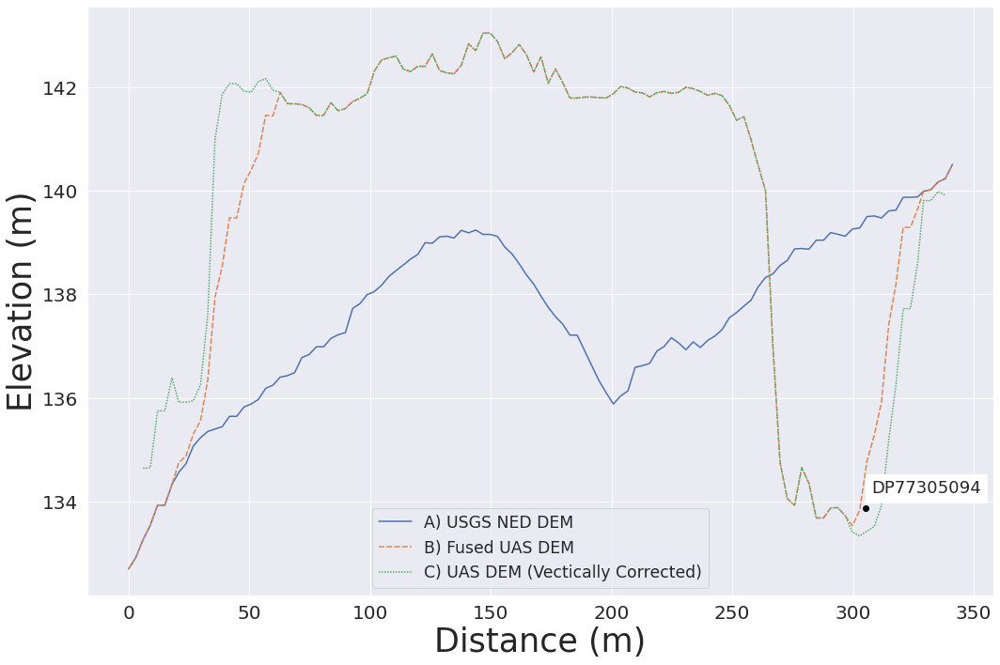

In [5096]:
#https://ncsu-geoforall-lab.github.io/uav-lidar-analytics-course/assignments/fusion_uas_lidar.html
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")

def profile_dem(dem, output, coords):
    out = f"output/{output}.csv"
    gs.run_command("r.profile", flags="gc", input=dem, coordinates=coords, output=out,null_value="0", overwrite=True)
    gs.run_command("v.in.ascii", input=out, output=output, separator="space", columns="x double,y double,profile double,diff double, color varchar", overwrite=True)
    # gs.run_command("v.in.ascii", input=out,format="line", output=f"{output}_line", separator="space", columns="x double,y double,profile double,diff double, color varchar", overwrite=True)

    # gs.run_command("v.to.lines", input=output, output=f"{output}_line", overwrite=True)
    !v.univar map=profile_fenton_shift column=diff
    df = pd.read_csv(out,delimiter=" ", names=['x','y','profile','diff','color'])
    return df

# original
pcoords = "631762.560090676,225027.32533114706,631748.6951814141,225045.6585523984,631702.8559240397,225048.70779850797,631694.5815714869,225064.8967491548,631659.1685947867,225157.70719988446,631686.3436535287,225251.37442363356,631744.7411201871,225321.3357450758" #,631696.7511228342,225387.82791008288,631549.3119743402,225545.67452788228,631484.5543875508,225641.65452258813" #,631445.2372812857,225685.01897802754,631401.2946331071,225705.83391663845,631371.2286106691,225714.5068077263,631333.6460826216,225715.6631932047"
# New
pcoords = "631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778"
pcoords_fused = "631414.1714507325, 224944.61835873662,631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778,631727.3167138431, 225085.0137442272"
print(pcoords)
df_ned = profile_dem("ned_19sec_site_priority_1","ned_19sec_fenton_profile",pcoords_fused)
# df_uas = profile_dem("bare_earth_smooth","bare_earth_profile",pcoords)
df_uas = profile_dem("bare_earth","bare_earth_profile",pcoords_fused)
df_fused = profile_dem("fenton_bare_earth_fused","fenton_bare_earth_fused_profile",pcoords_fused)
df_ned['DEMs'] = "A) USGS NED DEM"
df_fused['DEMs'] = "B) Fused UAS DEM"
df_uas['DEMs'] = "C) UAS DEM (Vectically Corrected)"
df_uas = df_uas[df_uas['diff'] > 0]
df_profiles = pd.concat([df_ned, df_fused, df_uas], ignore_index=True)
df_profiles.head(10)

# df_inlet_elves_profiles.reset_index(inplace=True)
sns.set_theme(style="darkgrid")
fig = plt.figure(figsize=(15, 10))
ax = sns.lineplot(x="profile", y="diff", hue="DEMs", data=df_profiles, style="DEMs");

# ax.set_title('Elevation Profiles',{"fontsize":20, "fontweight":"bold"})
ax.set_xlabel('Distance (m)', fontsize=35)
ax.set_ylabel('Elevation (m)', fontsize=35)
ax.tick_params(labelsize=20)
ax.legend(loc='upper right', fontsize=40)
plt.setp(ax.get_legend().get_texts(), fontsize='50') # for legend text
plt.legend(fontsize='x-large', title_fontsize='50')

# plt.axhline(df_ned["diff"].mean(), color='blue', linestyle='dashed',label="USGS NED DEM (Mean)")
# plt.axhline(df_fused["diff"].mean(), color='orange', linestyle='dashed',label="Fused DEM (Mean)") #max
# plt.axhline(df_uas["diff"].mean(), color='green', linestyle='dashed',label="UAS DEM (Vectically Corrected) (Mean)") #min
# sns.scatterplot(data=df_inlet_elves_profiles, x="diff", y="Inlet Rim Elev", hue="DEMs", size="Fused UAS DEM % Error", ax=ax)
print(f'USGS NED DEM Mean: {df_ned["diff"].mean()}')

# plt.axhline(df_priority["value"].median(), color='black', ls="--")
# plt.axhline(df_conf_envelope["value_thres"].max(), color='grey', ls=":") #max
# plt.axhline(df_conf_envelope["value_thres"].min(), color='grey', ls=":") #min
# handles, labels = ax.get_legend_handles_labels()
# print(handles, labels)

print(df_uas['profile'].loc[0:0])
inlet_point = [df_uas['profile'].loc[0:0],df_uas['diff'].loc[0:0]]
# plt.text(0 + 2.5,134.503780 + 0.25,'DP77306019',backgroundcolor="white",va="bottom",ha="center",fontsize=10)
# plt.plot(0, 134.503780, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")
# plt.text(68.55 + 2.5,133.610705 + 0.55,'DP77306020',backgroundcolor="white",va="top",ha="left",fontsize=10)
# plt.plot(68.55, 133.610705, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")
plt.text(305.2 + 2.5,133.87 + 0.55,'DP77305094',backgroundcolor="white",va="top",ha="left",fontsize=18)
plt.plot(305.2, 133.87, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")


# plt.legend(handles=[plt],labels=['Median', 'Envelope'])

plt.tight_layout()
plt.savefig("output/elvation_profiles.png",bbox_inches='tight',dpi=300)
sns.set_theme(style="white", palette=None)

#### Profile 2

631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
population standard deviation: 1.37514
population variance: 1.89101
population coefficient of variation: 1.7227
sample standard deviation: 1.38193
sample variance: 1.90973
kurtosis: -1.40899
skewness: -0.290488
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
po

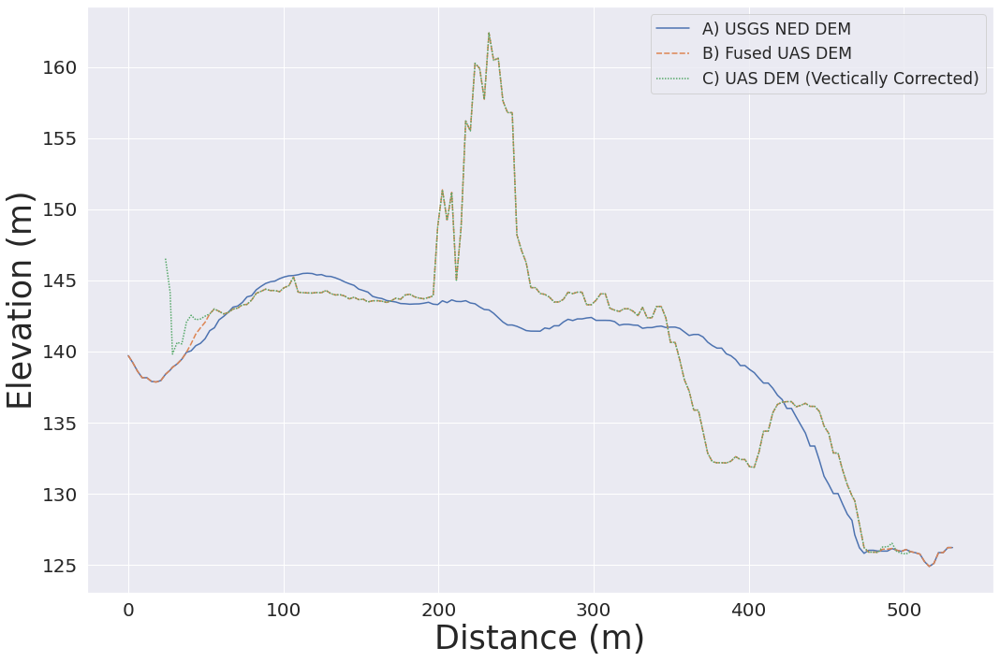

In [5065]:
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")

pcoords = "631358.3092306032,225189.8634794216,631711.8418597612,225424.4077803193"
pcoords = "631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065"
pcoords_fused = "631349.512049384, 225133.45258284573,631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065,631772.4050179613, 225458.1747846255"

print(pcoords)
df_ned = profile_dem("ned_19sec_site_priority_1","ned_19sec_fenton_profile2",pcoords_fused)
# df_uas = profile_dem("bare_earth_smooth","bare_earth_profile",pcoords)
df_uas = profile_dem("bare_earth","ned_19sec_fenton_profile2",pcoords_fused)
df_fused = profile_dem("fenton_bare_earth_fused","ned_19sec_fenton_profile2",pcoords_fused)
df_ned['DEMs'] = "A) USGS NED DEM"
df_fused['DEMs'] = "B) Fused UAS DEM"
df_uas['DEMs'] = "C) UAS DEM (Vectically Corrected)"
df_uas = df_uas[df_uas['diff'] > 0]

df_profiles = pd.concat([df_ned, df_fused, df_uas], ignore_index=True)
df_profiles.head(10)

# df_inlet_elves_profiles.reset_index(inplace=True)
sns.set_theme(style="darkgrid")
fig = plt.figure(figsize=(15, 10))
ax = sns.lineplot(x="profile", y="diff", hue="DEMs", data=df_profiles, style="DEMs");
# plt.legend(fontsize='x-large', title_fontsize='40')

ax.set_xlabel('Distance (m)', fontsize=35)
ax.set_ylabel('Elevation (m)', fontsize=35)
ax.tick_params(labelsize=20)
ax.legend(loc='upper right', fontsize=40)
plt.setp(ax.get_legend().get_texts(), fontsize='50') # for legend text
plt.legend(fontsize='x-large', title_fontsize='50')
# plt.axhline(df_ned["diff"].mean(), color='blue', linestyle='dashed',label="USGS NED DEM (Mean)")
# plt.axhline(df_fused["diff"].mean(), color='orange', linestyle='dashed',label="Fused DEM (Mean)") #max
# plt.axhline(df_uas["diff"].mean(), color='green', linestyle='dashed',label="UAS DEM (Vectically Corrected) (Mean)") #min
# sns.scatterplot(data=df_inlet_elves_profiles, x="diff", y="Inlet Rim Elev", hue="DEMs", size="Fused UAS DEM % Error", ax=ax)
print(f'USGS NED DEM Mean: {df_ned["diff"].mean()}')


# ax.legend(loc='upper right',fontsize=30)

# plt.legend(handles=[plt],labels=['Median', 'Envelope'])
# plt.legend()
plt.tight_layout()
plt.savefig("output/elvation_profiles2.png",bbox_inches='tight',dpi=300)
sns.set_theme(style="white", palette=None)

In [4968]:
gs.run_command("r.mask", raster="fenton_odm_dtm_5cm", overwrite=True)


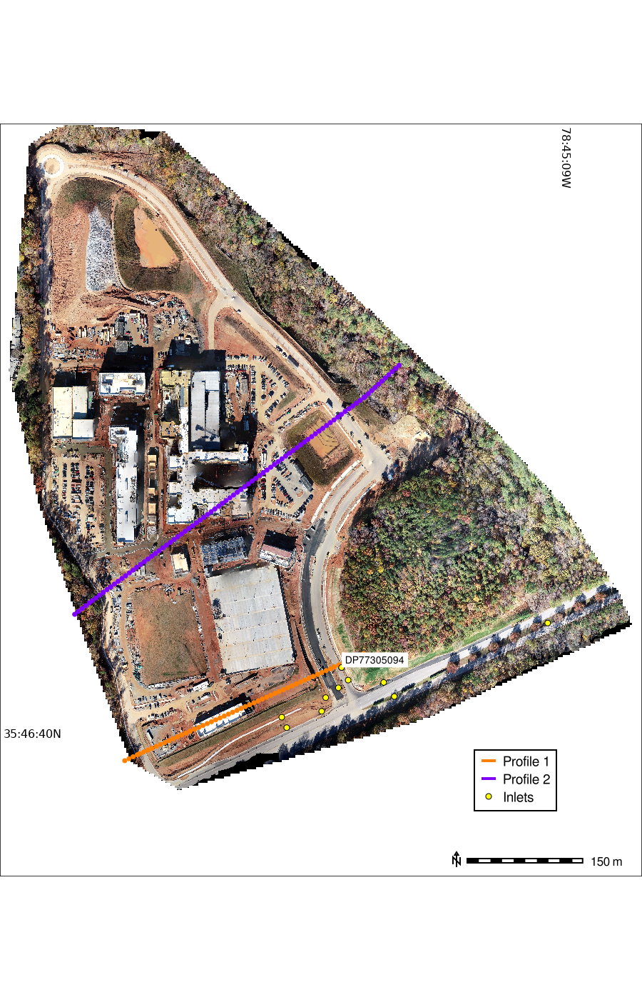

In [5004]:
# gs.run_command("g.region",region="region_site_1_inlets", res=0.05, flags="pa")
# gs.run_command("g.region",region="site_1", res=0.05, flags="pa")
# gs.run_command("g.region",raster="profile_view", res=3, flags="pa")

# gs.run_command("g.region",raster="fenton_odm_dtm_5cm", res=3, flags="pa")
# gs.run_command("r.contour",overwrite=True, input="fenton_bare_earth_fused", output="fenton_bare_earth_fused_contours",step=2)
gs.run_command("g.region",raster="fenton_odm_dtm_5cm", res=0.05, flags="pa")

# gs.run_command("g.region",region="profile_view", res=0.05, flags="pa")
gs.run_command("r.mask", raster="cary_town_blvd_flight_1_odm_dtm_3m")
view_reg = gs.region("fenton_odm_dtm_5cm")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 100



gs.run_command("g.region",
               raster="fenton_odm_dtm_5cm",
               # n=view_reg_n,
               # w=view_reg_w,
               # e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=0.05, flags="pa")
fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=1400, width=900,filename="output/fenton_proife_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")
# Trick the legend to show the profile as a line using another feature
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="orange", width="4", legend_label="Profile 1")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="purple", width="4", legend_label="Profile 2")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_odm_ortho_composite_5cm")

fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=16, color="black",
                                       type="point",
                                       legend_label="Inlets",
                                       # attribute_column="FACILITYID",label_size=10, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans",
                                       # where="FACILITYID = 'DP77305094'", #OR FACILITYID = 'DP77306010'
                                       # xref="left",
                                       # yref="bottom",
                                       flags="s"
                                      )




# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff1")


# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_contours",fill_color="none",type="line", color="191:191:191", width="2", legend_label="Elev Contours (2m)")

# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
# fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="144:238:144:255", width="4", legend_label="Gravity Main")
fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_profile",
                                       # rgb_column="color",
                                       color="orange",
                                       fill_color="orange",
                                       size="12", 
                                       legend_label="Profile 1",
                                       where="profile % 2 = 0",
                                       icon="basic/point",
                                       flags="s")

fenton_bare_earth_edge_diff_map.d_vect(map="ned_19sec_fenton_profile2",
                                       # rgb_column="color",
                                       color="purple",
                                       fill_color="purple",
                                       size="12", 
                                       legend_label="Profile 2",
                                       where="profile % 2 = 0",
                                       icon="basic/point",
                                       flags="s")


fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=16, color="black",
                                       type="point",
                                       # legend_label="Inlets",
                                       attribute_column="FACILITYID",label_size=10, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans",
                                       where="FACILITYID = 'DP77305094'", #OR FACILITYID = 'DP77306010'
                                       xref="left",
                                       yref="bottom",
                                       legend_label="Inlets"
                                      )





fenton_bare_earth_edge_diff_map.d_legend_vect(at=(75,25),font="FreeSans", flags="b",border_color="black")

# fenton_bare_earth_edge_diff_map.d_legend(raster="bare_earth_profile",
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(70,15), units="meters",font="FreeSans", flags="n",length="150")
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:50", flags="dw", width=1, color="black",text_color="black",fontsize=16)
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="black",fontsize=16)

gs.run_command("r.mask", flags="r")
fenton_bare_earth_edge_diff_map.show()


w: 823, h: 487


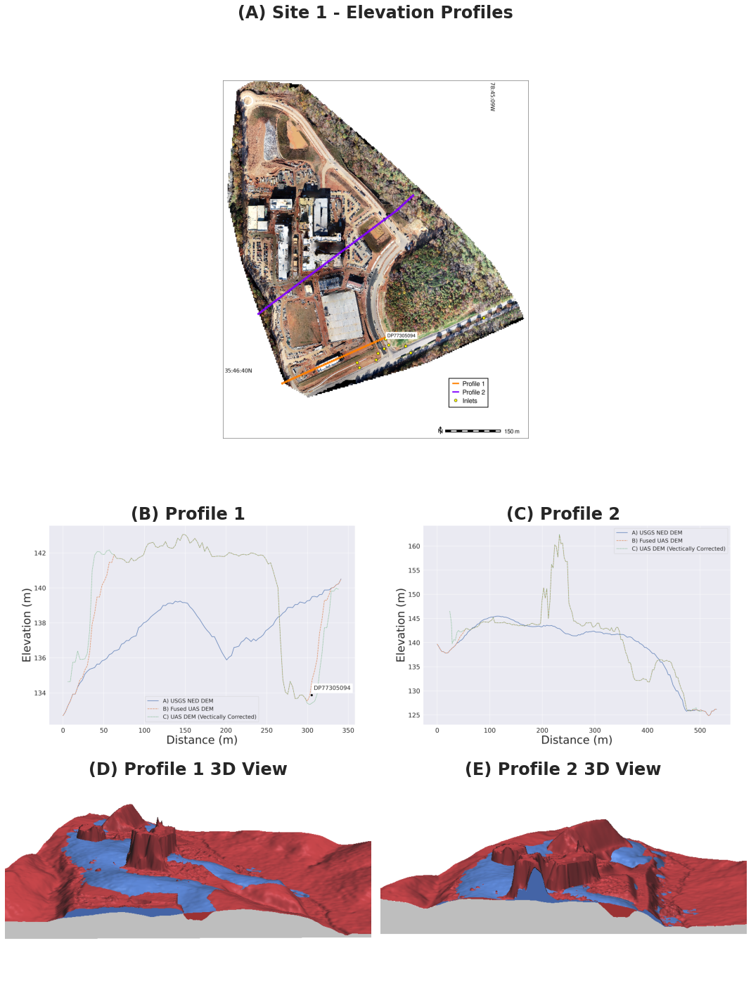

In [5097]:
from PIL import Image

fig = plt.figure(figsize=(15, 20),constrained_layout=False)
sns.set_theme(style="white", palette=None)
grs = fig.add_gridspec(8, 2)

ax = fig.add_subplot(grs[0:4, :])
# fig.subplots_adjust(hspace=0.5, wspace=0.5)
ax.set_axis_off()
img_ortho = Image.open("output/fenton_proife_map.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('(A) Site 1 - Elevation Profiles',{"fontsize":24, "fontweight":"bold"})
# ax.axis('off')
# plt.colorbar(ticks=[0.1, 0.3, 0.5, 0.7], orientation='horizontal')
ax = fig.add_subplot(grs[4:6, 0])
ax.set_title('(B) Profile 1',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/elvation_profiles.png")
imgplot = plt.imshow(img2)
ax.axis('off')

# imgplot.set_clim(0.0, 0.7)
ax = fig.add_subplot(grs[4:6, 1])
ax.set_title('(C) Profile 2',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/elvation_profiles2.png")
imgplot = plt.imshow(img2)
ax.axis('off')


ax = fig.add_subplot(grs[6:8,0])
ax.set_title('(D) Profile 1 3D View',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/profile13d.png")
imgplot = plt.imshow(img2)
ax.axis('off')


ax = fig.add_subplot(grs[6:8, 1])
ax.set_title('(E) Profile 2 3D View',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/profile23d.png")
img2width, img2height = img2.size
print(f"w: {img2width}, h: {img2height}")
# Setting the points for cropped image
img2left = 0 #img2width
img2top = 0 -200 # img2height
img2right = img2width# img2width
img2bottom = img2height #300 * img2height / 4

 
# Cropped image of above dimension
# (It will not change original image)
# img2 = img2.crop((img2left, img2top, img2right, img2bottom))
imgplot = plt.imshow(img2)
ax.axis('off')


plt.tight_layout()
plt.savefig("output/elvation_profiles_figures.png",dpi=300)

Check for Shift

# Surface Water Flow

In [3584]:
def simwe(elev, nlcd, output):
    dx = f'dx_{output}'
    dy = f'dy_{output}'
    mannings = f'mancover_{output}'
    raincover = f'raincover_{output}'
    runoff_coef = f'runoff_coef_{output}'
    freq_factor = 1.25
    rain_intensity = 79.248
    depth = f'depth_variable_rainfall_{output}'
    print(f"Depth: {depth}")
    
    discharge = f'discharge_variable_rainfall_{output}'
    print(f"Discharge: {discharge}")
    # compute dx, dy
    gs.run_command("r.slope.aspect", elevation=elev, dx=dx, dy=dy, overwrite=True)

    # # Calculate manning coefficient
    gs.run_command("r.recode", input=nlcd, output=mannings, rules="grass_config/classified_to_mannings.txt")

    # # Calculate variable rainfall using nlcd
    gs.run_command("r.recode", input=nlcd, output=runoff_coef, rules="grass_config/classified_runoff_coefficent.txt")
    rain_fall_excess_calc = f"({runoff_coef} * {freq_factor} * {rain_intensity})"
    gs.run_command("r.mapcalc", 
        expression=f"{raincover} = if({rain_fall_excess_calc} > {rain_intensity}, {rain_intensity}, {rain_fall_excess_calc})",
        overwrite=True)

    # NOAA ATLAS 14 POINT PRECIPITATION FREQUENCY ESTIMATES
    # Get 100 year flood event critiera (Percipiation frequency)
    # https://hdsc.nws.noaa.gov/hdsc/pfds/pfds_map_cont.html?bkmrk=nc

    # Duration | 100 yr 
    # 30 min     2.33 in
    # 60 min     3.21 in (79.248mm)

    # Calculate SCS Curve Number (CN)
    # https://serc.carleton.edu/hydromodules/steps/creating_excess.html
    # initial abstraction (la) = 0.2S # 20% of the total maximum storage or retention of watershed
    # continous abstraction (Fa) = S * (P-la)\(P-la + S)
        # Total Retention (S) = 0
        # Total Rainfall (P) = 79.248mm

    #Rational Method
    # C
    # Cf = 1.25

    gs.run_command("r.sim.water", 
        elevation=elev, 
        dx=dx,
        dy=dy,
        # rain_value=79.248,
        rain=raincover,
        infil_value=0,
        man=mannings,
        depth=depth,
        disch=discharge,
        nwalk=1000000,
        nprocs=14,
        output_step=60, # Time step in minutes
        niterations=60 # Total time of event in minutes
    )

    # Extract flooded pixels with a depth >= 0.025m (~1in)
    filtered_depth = f"pf_100yr_{output}"
    print(f"Filtered Depth: {filtered_depth}")
    expression = f"{filtered_depth} = if({depth} >= 0.025,  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=filtered_depth, raster=depth)

    return filtered_depth


def simweSimple(elev, output):
    dx = f'dx_{output}'
    dy = f'dy_{output}'
    error = f'simwe_error_{output}'
    walkers = f'walkers_{output}'
    print(f"Walkers: {walkers}")

    depth = f'depth_{output}'
    print(f"Depth: {depth}")
    
    discharge = f'discharge_{output}'
    print(f"Discharge: {discharge}")
    # compute dx, dy
    gs.run_command("r.slope.aspect", elevation=elev, dx=dx, dy=dy, overwrite=True)
    # r.sim.water -t rain_value=30 man_value=0.15 depth=ground_depth discharge=ground_disch nwalkers=100000 niterations=20 output_step=1 hmax=0.2 halpha=8.0 hbeta=1.0

    gs.run_command("r.sim.water", 
        elevation=elev, 
        dx=dx,
        dy=dy,
        depth=depth,
        disch=discharge,
        rain_value=100,
        infil_value=0,
        man_value=0.1,
        output_step=60, # Time step in minutes
        niterations=60, # Total time of event in minutes
                   
        # rain_value=30, #Rainfall excess rate unique value [mm/hr]
        # infil_value=0, # Runoff infiltration rate unique value [mm/hr]
        # man_value=0.15, # Manning's n unique value
        # output_step=1, # Time step in minutes
        # niterations=30, # Total time of event in minutes
        # hmax=0.2,   # Threshold water depth [m]. Diffusion increases after this water depth is reached
        # halpha=8.0, #Diffusion increase constant
        # hbeta=1.0, #Weighting factor for water flow velocity vector
                   
        flags="", #t
        # error=error,
        # walkers_output=walkers,
        nwalk=100000, # Set Back to 1m
        nprocs=14,
        random_seed="1"
    )

def analyze_hydrology(dem, uas, fused, drainage, stream, basin, accumulation, threshold, memory=10000, overwrite=False):
    print("*" * 50)
    
    if uas:
        print(f"Starting Fusion...")
        fusion(dem = dem,uas=uas, output=fused, usgs=False)
        print(f"Fused: {fused}")
    else:
        # Set fused variable to dem if no fusion is performed
        fused = dem
        
        
    # Need to reset the region to the whole study area
    gs.run_command("g.region",raster=dem, res=3, flags="pa")
    print(f"Creating Watersheds...")
    gs.run_command("r.watershed", elevation=fused, 
                   threshold=threshold,
                   drainage=drainage, 
                   stream=stream, 
                   basin=basin,
                   accumulation=accumulation,
                   memory=memory, overwrite=overwrite)
    
    print(f"Extracting Streams...")
    gs.run_command("r.stream.extract",
        elevation=fused,
        threshold=threshold, 
        mexp=0, 
        memory=memory, 
        stream_raster=f"{stream}_ext", 
        stream_vector=f"{stream}_ext",
        overwrite=overwrite
      )
    print(f"Converting Basins to Vectors...")
    gs.run_command("r.to.vect", input=basin, output=basin, type="area", overwrite=overwrite)
    
    print(f"Running SIMWE...")
    simweSimple(fused, fused)
    print("*" * 50)
    
    
def generate_depth_map(depth, flooding, filename, relief, depth_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({depth} >= {depth_filter},  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=depth)
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(height=900,width=1400,filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Depth (m)",flags="l")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()

def generate_discharge_map(disch, flooding, filename, relief, disch_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({disch} >= {disch_filter},  {disch}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=disch)
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Discharge (m3/s)")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()


## Analyze Surface Water Flow

### UAS Bare Earth DEM

depth stats: {'n': '34847', 'null_cells': '167905', 'cells': '202752', 'min': '0.000794529507402331', 'max': '1.34876918792725', 'range': '1.34797465841984', 'mean': '0.0484136839327921', 'mean_of_abs': '0.0484136839327921', 'stddev': '0.100204761315925', 'variance': '0.0100409941903815', 'coeff_var': '206.976113313395', 'sum': '1687.07164400601', 'first_quartile': '0.00322593', 'median': '0.00800514', 'third_quartile': '0.0361175', 'percentile_90': '0.151127'}


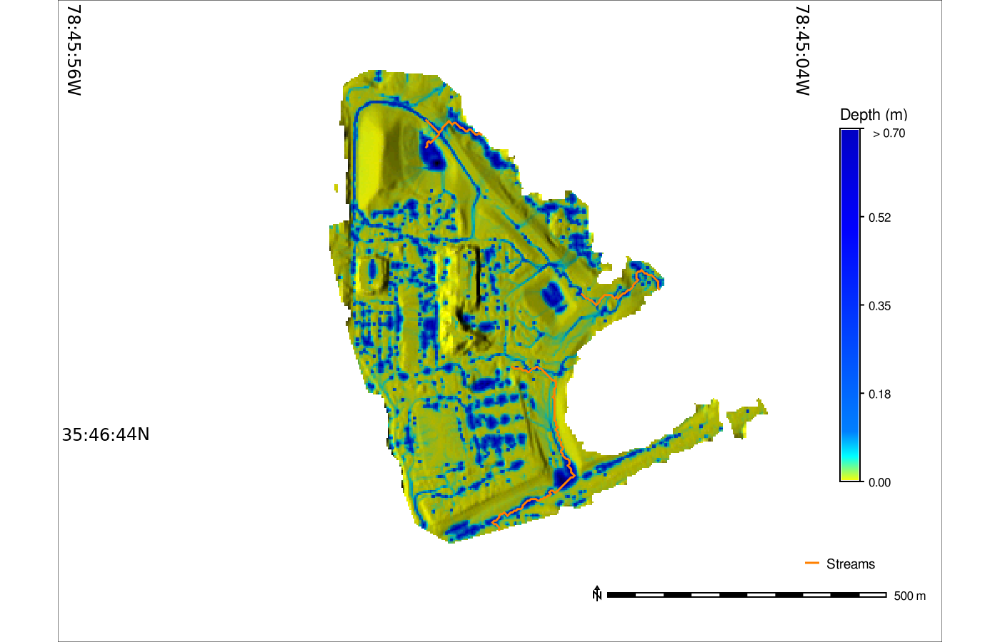

In [4949]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="bare_earth", 
#     uas=False, 
#     fused=False, 
#     drainage="bare_earth_direction_3k", 
#     stream="bare_earth_streams_3k",
#     basin="bare_earth_basins_3k",
#     accumulation="bare_earth_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=bare_earth_streams_3k_ext binput=fenton_3m_fused_basin_3k output=bare_earth_pre_fusion_stream operator=within
# gs.run_command("r.relief", input="bare_earth", output="bare_earth_relief", overwrite=True)
# gs.run_command("r.shade", shade="bare_earth_relief", color="depth_bare_earth.60", output="depth_bare_earth_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
fenton_fused_depth_map = gj.GrassRenderer(height=900, width=1400, filename="output/bare_earth_depth_map.png")
fenton_fused_depth_map.d_erase()
fenton_fused_depth_map.d_rast(map="depth_bare_earth_60_shaded_relief")
fenton_fused_depth_map.d_vect(map="bare_earth_pre_fusion_stream", color="orange", type="line", width=3, legend_label="Streams")
# fenton_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_fused_depth_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Overlap")
# fenton_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")

depth_univ = gs.parse_command("r.univar", map="depth_bare_earth.60", flags="ge")
print(f"depth stats: {depth_univ}")
fenton_fused_depth_map.d_legend(raster="depth_bare_earth.60", 
                                range=(0.0,0.7),
                                at=(80,25,84,86), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")
fenton_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")

fenton_fused_depth_map.d_text(at=(92.2,78.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_fused_depth_map.d_barscale(at=(59,9),units="kilometers",font="FreeSans",flags="n")
fenton_fused_depth_map.d_grid(size="00:00:52", flags="dw", width=1, color="black",text_color="black",fontsize=24)

fenton_fused_depth_map.show()

### USGS NED DEM

depth stats: {'n': '180480', 'null_cells': '0', 'cells': '180480', 'min': '0.00095128221437335', 'max': '2.19864749908447', 'range': '2.1976962168701', 'mean': '0.0591328568860572', 'mean_of_abs': '0.0591328568860572', 'stddev': '0.147484231147479', 'variance': '0.0217515984371629', 'coeff_var': '249.411645088728', 'sum': '10672.2980107956', 'first_quartile': '0.00556623', 'median': '0.00958447', 'third_quartile': '0.0245256', 'percentile_90': '0.166909'}


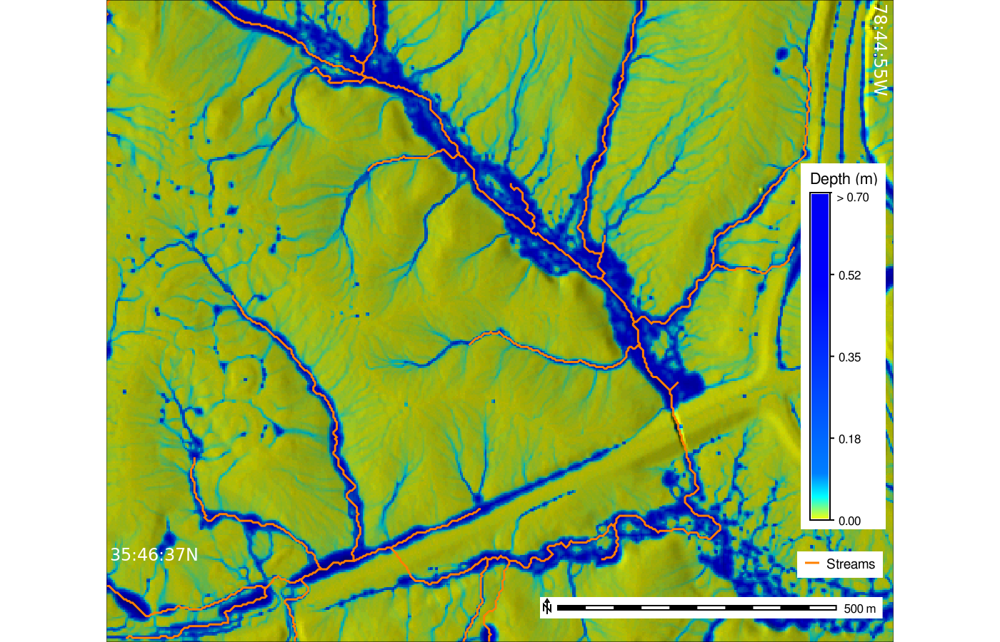

In [4952]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="ned_19sec_site_priority_1", 
#     uas=False, 
#     fused=False, 
#     drainage="ned_19sec_fenton_basin_direction_3k", 
#     stream="ned_19sec_fenton_basin_streams_3k",
#     basin="ned_19sec_fused_fenton_basin_basins_3k",
#     accumulation="ned_19sec_fused_fenton_basin_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=ned_19sec_fenton_basin_streams_3k_ext binput=fenton_3m_fused_basin_3k output=pre_fusion_stream operator=within
# gs.run_command("r.shade", shade="ned_19sec_relief", color="depth_ned_19sec.60", output="depth_ned_19sec_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")

fenton_pre_fused_depth_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_pre_fused_depth_map.png")
fenton_pre_fused_depth_map.d_erase()
fenton_pre_fused_depth_map.d_rast(map="depth_ned_19sec_60_shaded_relief")
fenton_pre_fused_depth_map.d_vect(map="pre_fusion_stream", color="orange",type="line", width=3,  legend_label="Streams")
# fenton_pre_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_pre_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")
# fenton_pre_fused_depth_map.d_legend_vect(at=(60,95,70,70),font="FreeSans", flags="b")
# fenton_pre_fused_depth_map.d_legend(raster="depth_ned_19sec.60", at=(65,25,77,80), title="Depth (m)",title_fontsize=16, fontsize=12, font="FreeSans", flags="lb")
# fenton_pre_fused_depth_map.d_barscale(at=(54,9,70,80), units="kilometers", fontsize=14, font="FreeSans")
fenton_pre_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")


depth_univ = gs.parse_command("r.univar", map="depth_ned_19sec.60", flags="ge")
print(f"depth stats: {depth_univ}")
fenton_pre_fused_depth_map.d_legend(raster="depth_ned_19sec.60", 
                                range=(0.0,0.7),
                                at=(70,19,81,83), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")

fenton_pre_fused_depth_map.d_text(at=(92.8,68.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_pre_fused_depth_map.d_barscale(at=(54,7),units="kilometers",font="FreeSans",flags="n")
fenton_pre_fused_depth_map.d_grid(size="00:00:59", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_pre_fused_depth_map.show()

### Fused DEM

depth stats: {'n': '180480', 'null_cells': '0', 'cells': '180480', 'min': '0.000571778800804168', 'max': '2.38359427452087', 'range': '2.38302249572007', 'mean': '0.0572491017930036', 'mean_of_abs': '0.0572491017930036', 'stddev': '0.145017221324768', 'variance': '0.0210299944807566', 'coeff_var': '253.309164306382', 'sum': '10332.3178916013', 'first_quartile': '0.00465947', 'median': '0.00878744', 'third_quartile': '0.0240012', 'percentile_90': '0.164806'}


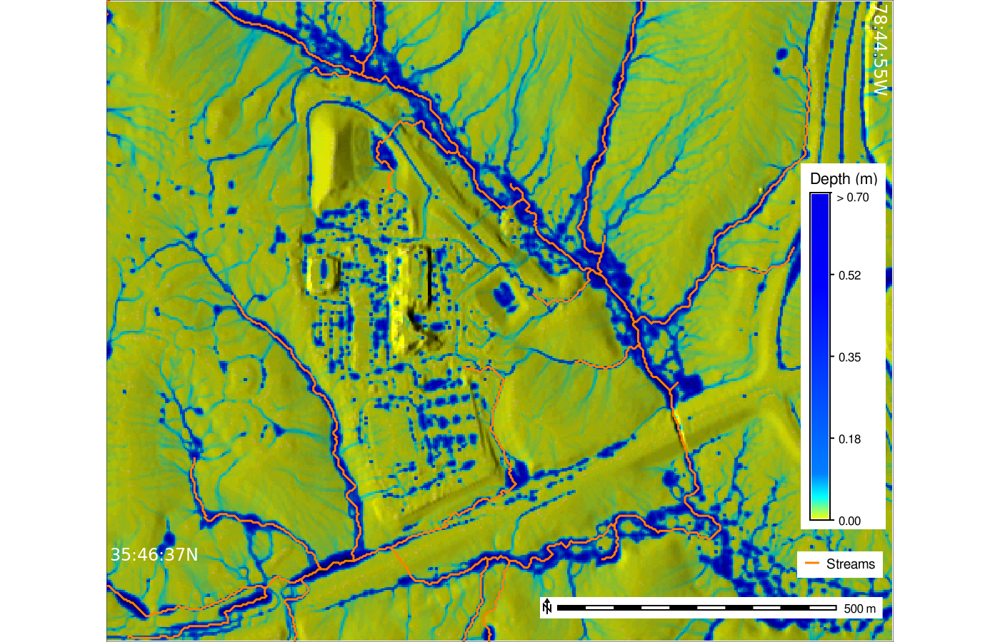

In [4938]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="fenton_bare_earth_fused", 
#     uas=False, 
#     fused=False, 
#     drainage="fenton_bare_earth_fused_direction_3k", 
#     stream="fenton_bare_earth_fused_streams_3k",
#     basin="fenton_bare_earth_fused_basins_3k",
#     accumulation="fenton_bare_earth_fused_fused_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=fenton_bare_earth_fused_streams_3k_ext binput=fenton_3m_fused_basin_3k output=post_fusion_stream operator=within
# gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="depth_fenton_bare_earth_fused.60", output="depth_fenton_bare_earth_fused_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")
fenton_fused_depth_map = gj.GrassRenderer(height=900, width=1400, filename="output/fenton_fused_depth_map.png")
fenton_fused_depth_map.d_erase()
fenton_fused_depth_map.d_rast(map="depth_fenton_bare_earth_fused_60_shaded_relief")
fenton_fused_depth_map.d_vect(map="post_fusion_stream", color="orange", type="line", width=3, legend_label="Streams")
# fenton_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_fused_depth_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Overlap")
# fenton_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")

fenton_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")
depth_univ = gs.parse_command("r.univar", map="depth_fenton_bare_earth_fused.60", flags="ge")
print(f"depth stats: {depth_univ}")
# fenton_fused_depth_map.d_legend(raster="depth_fenton_bare_earth_fused.60", 
#                                 range=(0.0,0.7),
#                                 at=(80,25,84,86), 
#                                 border_color="none", 
#                                 title="Depth (m)",title_fontsize=16, 
#                                 fontsize=12, font="FreeSans", 
#                                 flags="tsbf")

# fenton_fused_depth_map.d_text(at=(92.2,78.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")
fenton_fused_depth_map.d_legend(raster="depth_fenton_bare_earth_fused.60", 
                                range=(0.0,0.7),
                                at=(70,19,81,83), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")

fenton_fused_depth_map.d_text(at=(92.8,68.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_fused_depth_map.d_barscale(at=(54,7),units="kilometers",font="FreeSans",flags="n")
fenton_fused_depth_map.d_grid(size="00:00:59", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_fused_depth_map.show()

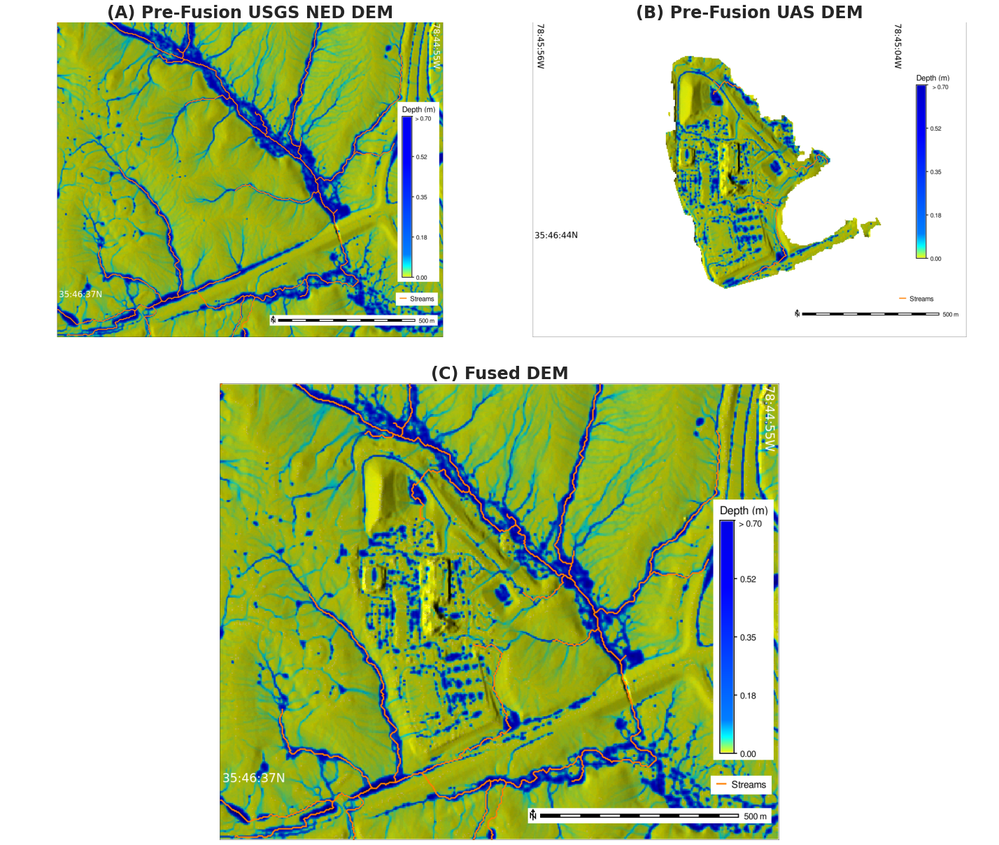

In [4953]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

# ax = fig.add_subplot(2, 1, 1)

grs = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.set_axis_off()

img1 = Image.open("output/fenton_pre_fused_depth_map.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) Pre-Fusion USGS NED DEM',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0, 1])
ax2.set_axis_off()

img1 = Image.open("output/bare_earth_depth_map.png")
imgplot = plt.imshow(img1)
ax2.set_title('(B) Pre-Fusion UAS DEM',{"fontsize":24, "fontweight":"bold"})
# spans two rows:
ax3 = fig.add_subplot(grs[1, :])
ax3.set_axis_off()

fig.subplots_adjust(hspace=0, wspace=0.1)


# ax = fig.add_subplot(2, 1, 2)
# ax.set_axis_off()
img2 = Image.open("output/fenton_fused_depth_map.png")
imgplot = plt.imshow(img2)
ax3.set_title('(C) Fused DEM',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fenton_basin_fusion_depth.png",bbox_inches='tight', dpi=300)

#### Fusion Depth - USGS Depth

depth_diff_fusion_usgs: Mean: -0.00362857477788956, STD: 0.0678677828580513, Median: -0.000625148, Min: -0.996213436126709, Max: 1.44697606563568


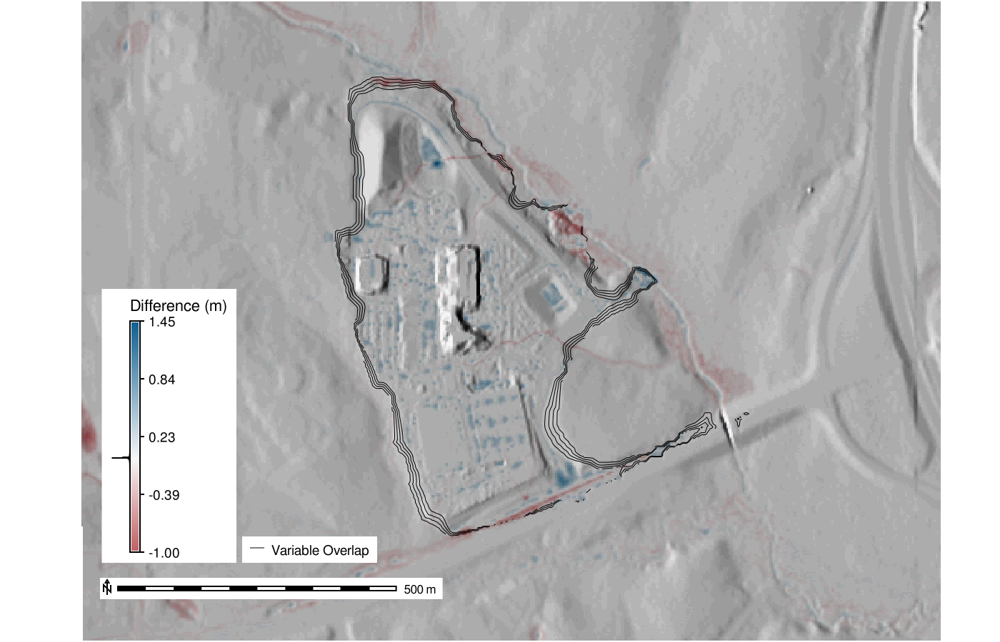

In [3521]:

# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "depth_diff_fusion_usgs"
gs.mapcalc(f"{fusion_depth_diff} = depth_fenton_bare_earth_fused.60 - depth_ned_19sec.60")
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color=fusion_depth_diff, output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()


#### Fusion Depth - UAS Bare Earth Depth

depth_diff_fusion_usa: Mean: 0.0112460358990462, STD: 0.0978957161301291, Median: -0.000507713, Min: -0.632968246936798, Max: 1.24882805347443


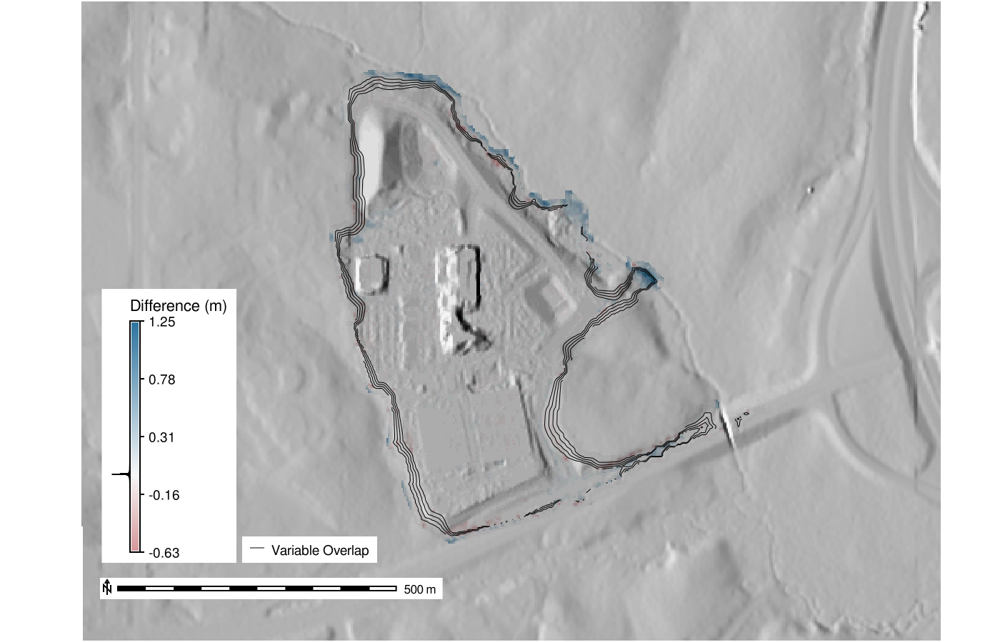

In [3522]:
# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "depth_diff_fusion_usa"
gs.mapcalc(f"{fusion_depth_diff} = depth_fenton_bare_earth_fused.60 - depth_bare_earth.60")
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color=fusion_depth_diff, output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

#### Basin Comparison

In [ ]:
def generate_depth_map(depth, flooding, filename, relief, depth_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({depth} >= {depth_filter},  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=depth)
    print(f"Image Save Location: {output}")
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(height=900,width=1400,filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Depth (m)",flags="l")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()

generate_depth_map()

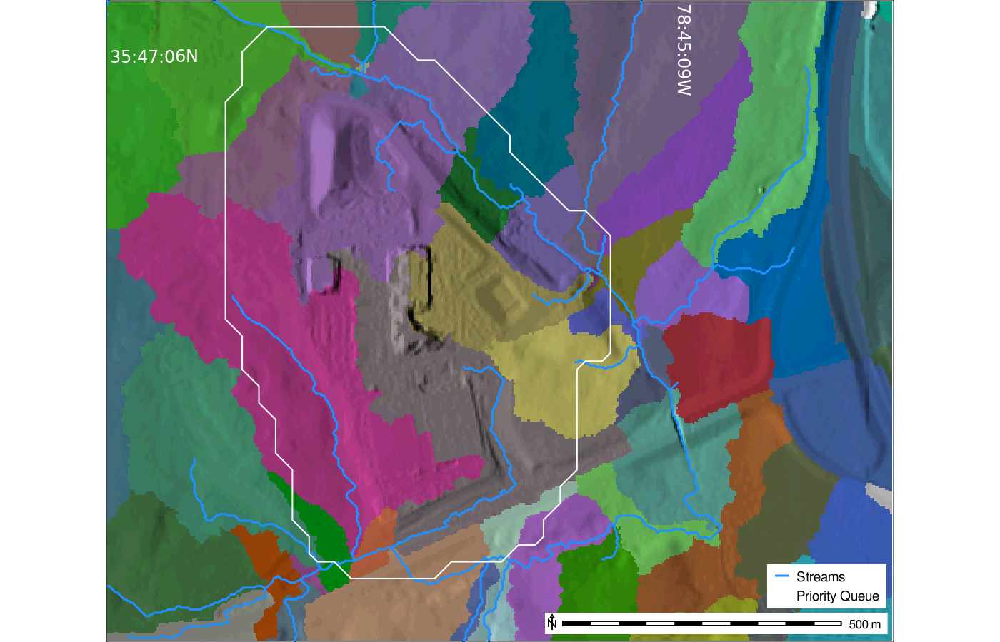

In [4961]:
# fenton_bare_earth_fused_basins_3k
# ned_19sec_fused_fenton_basin_basins_3k
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
# !r.cross input=fenton_bare_earth_fused_basins_3k,ned_19sec_fused_fenton_basin_basins_3k output=fusion_usgs_basins_cross
# gs.mapcalc(f"{fusion_depth_diff} = if(fenton_bare_earth_fused_basins_3k == ned_19sec_fused_fenton_basin_basins_3k )")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "fenton_bare_earth_fused_basins_3k"
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
# gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_basins_3k", output=depth_shaded_releif, overwrite=True)
# flooding= "fused_flooding"
# depth = "depth_fenton_bare_earth_fused.60" # - depth_ned_19sec.60
# expression = f"{flooding} = if({depth} >= 0.03,  {depth}, null())"
# gs.run_command("r.mapcalc", expression=expression, overwrite=True)
# gs.run_command("r.colors", map=flooding, raster=depth)

gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
# fenton_bare_earth_fused_diff_map.d_rast(map=flooding)
# fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_diff_map.d_vect(map="post_fusion_stream", color="30:144:255:255",type="line", width=3,  legend_label="Streams")
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=2, legend_label="Priority Queue")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(77.5,12),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(54.5,4.5), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_bare_earth_fused_diff_map.show()

ned_19sec_fused_fenton_basin_basins_3k: Mean: 63.7242111287428, STD: 29.4101782687402, Median: 66.0, Min: 4.0, Max: 120.0


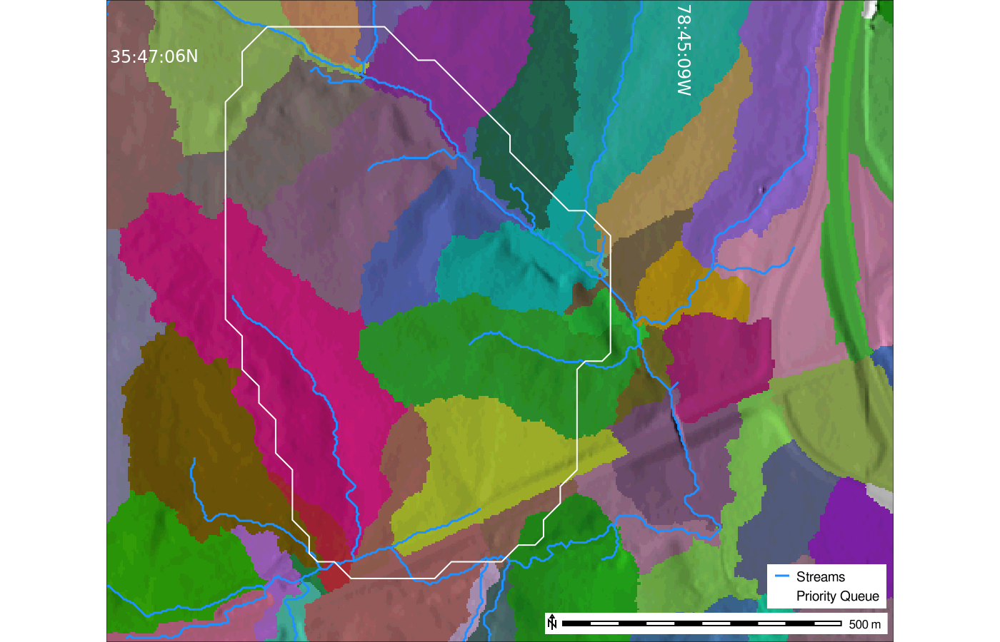

In [4962]:
# fenton_bare_earth_fused_basins_3k
# ned_19sec_fused_fenton_basin_basins_3k
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
# !r.cross input=fenton_bare_earth_fused_basins_3k,ned_19sec_fused_fenton_basin_basins_3k output=fusion_usgs_basins_cross
# gs.mapcalc(f"{fusion_depth_diff} = if(fenton_bare_earth_fused_basins_3k == ned_19sec_fused_fenton_basin_basins_3k )")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "ned_19sec_fused_fenton_basin_basins_3k"
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
# gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="ned_19sec_relief", color="ned_19sec_fused_fenton_basin_basins_3k", output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="ned_19sec_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
# fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_diff_map.d_vect(map="pre_fusion_stream", color="30:144:255:255",type="line", width=3,  legend_label="Streams")
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=2, legend_label="Priority Queue")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(77.5,12),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(54.5,4.5), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="white",fontsize=24)
fenton_bare_earth_fused_diff_map.show()

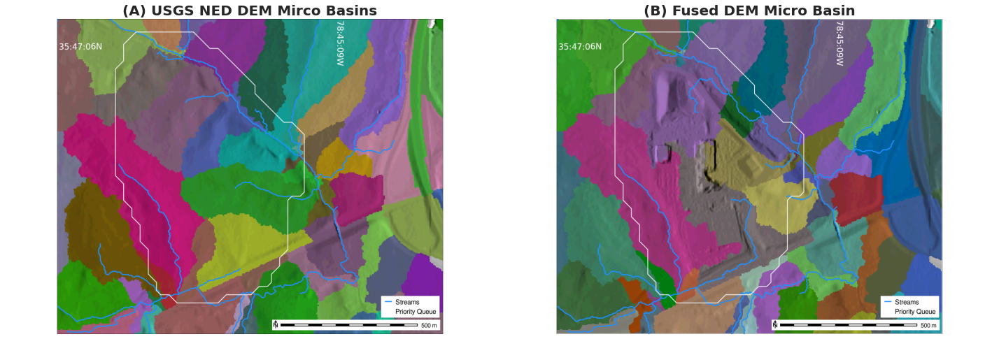

In [4963]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/ned_19sec_fused_fenton_basin_basins_3k.png")
imgplot = plt.imshow(img1)
ax.set_title('(A) USGS NED DEM Mirco Basins',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img2 = Image.open("output/fenton_bare_earth_fused_basins_3k.png")
imgplot = plt.imshow(img2)
ax.set_title('(B) Fused DEM Micro Basin',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/pre_post_fusion_basins.png",bbox_inches='tight',dpi=300)

# PS Before

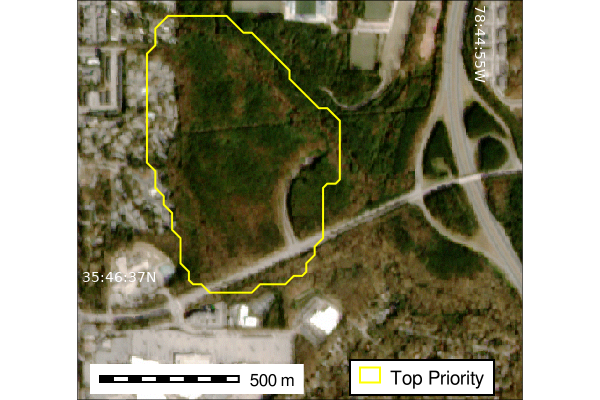

In [4624]:
gs.run_command("g.region",raster="ned_19sec_site_priority_1", res=3, flags="pa")
view_reg = gs.region("ned_19sec_site_priority_1")
view_reg_w = view_reg['w'] + 100
view_reg_n = view_reg['n'] - 300
gs.run_command("g.region",raster="ned_19sec_site_priority_1", res=3, flags="pa", w=view_reg_w, n=view_reg_n)
ps_before_3m_cary_map = gj.GrassRenderer(filename="output/ps_before_3m_fenton_map.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_rast(map="ps_before_3m_comp")
ps_before_3m_cary_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="yellow", width="2",legend_label="Top Priority")
ps_before_3m_cary_map.d_legend_vect(at=(60,10,2,6),font="FreeSans", flags="b")
ps_before_3m_cary_map.d_barscale(at=(15,9,2,2), units="meters",font="FreeSans")
ps_before_3m_cary_map.d_grid(size="00:00:59", flags="dw", width=4, color="black",text_color="white",fontsize=14)

ps_before_3m_cary_map.show()

# PS After Image w/Priorty Queue

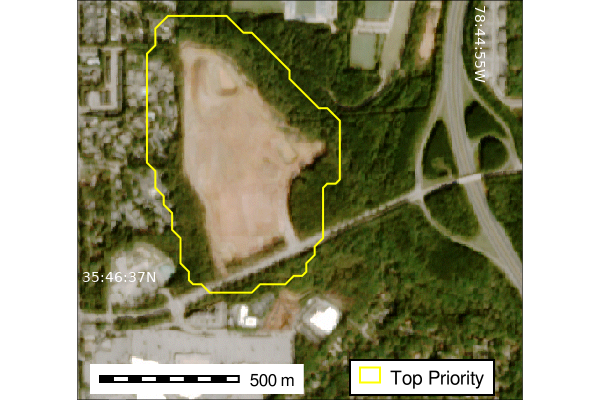

In [4623]:
gs.run_command("g.region",raster="ned_19sec_site_priority_1", res=3, flags="pa")
view_reg = gs.region("ned_19sec_site_priority_1")
view_reg_w = view_reg['w'] + 100
view_reg_n = view_reg['n'] - 300
gs.run_command("g.region",raster="ned_19sec_site_priority_1", res=3, flags="pa", w=view_reg_w, n=view_reg_n)

# gs.run_command("r.mask", flags="r")
priority_queue_3m_cary_map = gj.GrassRenderer(filename="output/priority_queue_3m_fenton_map.png")
priority_queue_3m_cary_map.d_erase()
priority_queue_3m_cary_map.d_rast(map="ps_after_3m_comp")
# priority_queue_3m_cary_map.d_rast(map="priorityQueueMulti30m_norm")
priority_queue_3m_cary_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="yellow", width="2",legend_label="Top Priority")
priority_queue_3m_cary_map.d_legend_vect(at=(60,10,2,6),font="FreeSans", flags="b")

# priority_queue_3m_cary_map.d_legend(raster="priorityQueueMulti30m_norm", title="Priority", title_fontsize=10, at=(12,60,2,5))
priority_queue_3m_cary_map.d_barscale(at=(15,9,2,2), units="meters", font="FreeSans")
priority_queue_3m_cary_map.d_grid(size="00:00:59", flags="dw", width=4, color="black",text_color="white",fontsize=14)
priority_queue_3m_cary_map.show()

# Priority Queue Figure

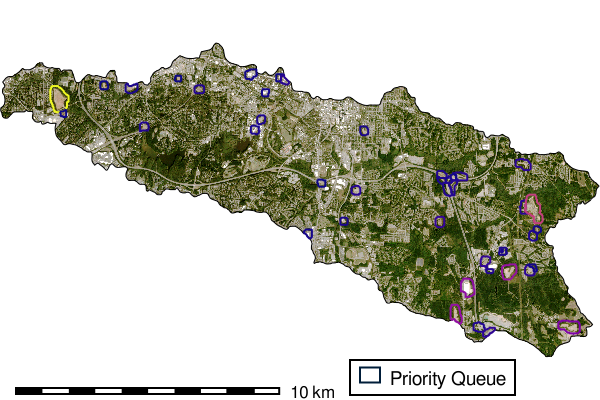

In [180]:
# priority_queue_clean_med
gs.run_command("g.region",raster="walnut_creek", res=3, flags="pa")
# view_reg = gs.region("ned_19sec_site_priority_1")
# view_reg_w = view_reg['w'] + 100
# view_reg_n = view_reg['n'] - 300
# gs.run_command("g.region",raster="ned_19sec_site_priority_1", res=3, flags="pa", w=view_reg_w, n=view_reg_n)
ps_before_3m_cary_map = gj.GrassRenderer(filename="output/ps_after_3m_priority_queue_map.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_rast(map="ps_after_3m_comp")
ps_before_3m_cary_map.d_vect(map="walnut_creek", fill_color="none", color="black", width="1", flags="s")

ps_before_3m_cary_map.d_vect(map="priority_queue_clean_med", fill_color="none", width="2",legend_label="Priority Queue")
ps_before_3m_cary_map.d_legend_vect(at=(60,10,2,6),font="FreeSans", flags="b")

ps_before_3m_cary_map.d_barscale(at=(1,6,2,2), units="meters",font="FreeSans")
ps_before_3m_cary_map.show()

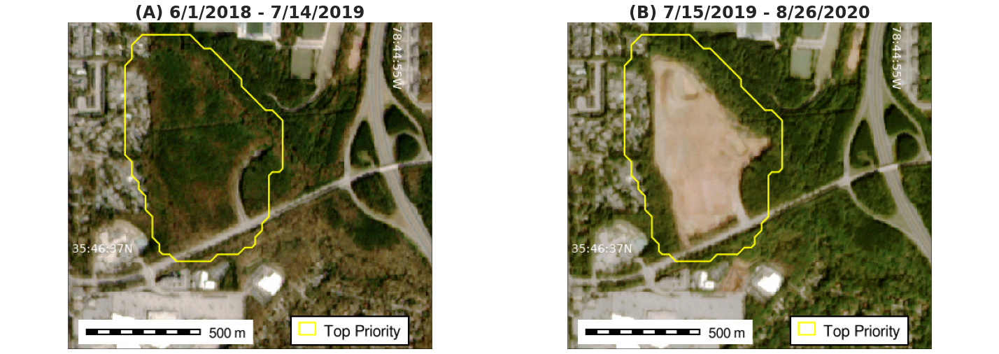

In [4626]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img_ortho = Image.open("output/ps_before_3m_fenton_map.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('(A) 6/1/2018 - 7/14/2019',{"fontsize":24, "fontweight":"bold"})

# ax = fig.add_subplot(2, 3, 2)
# # ax.set_axis_off()
# img1 = Image.open("output/ps_after_3m_fenton_map.png")
# imgplot = plt.imshow(img1)
# ax.set_title('After (2019 - 2020)')

# plt.colorbar(ticks=[0.1, 0.3, 0.5, 0.7], orientation='horizontal')
ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()

img2 = Image.open("output/priority_queue_3m_fenton_map.png")
imgplot = plt.imshow(img2)
# imgplot.set_clim(0.0, 0.7)
ax.set_title('(B) 7/15/2019 - 8/26/2020',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/priority_queue_3m_fenton_figure.png",bbox_inches='tight')

## Priority Queue Figure

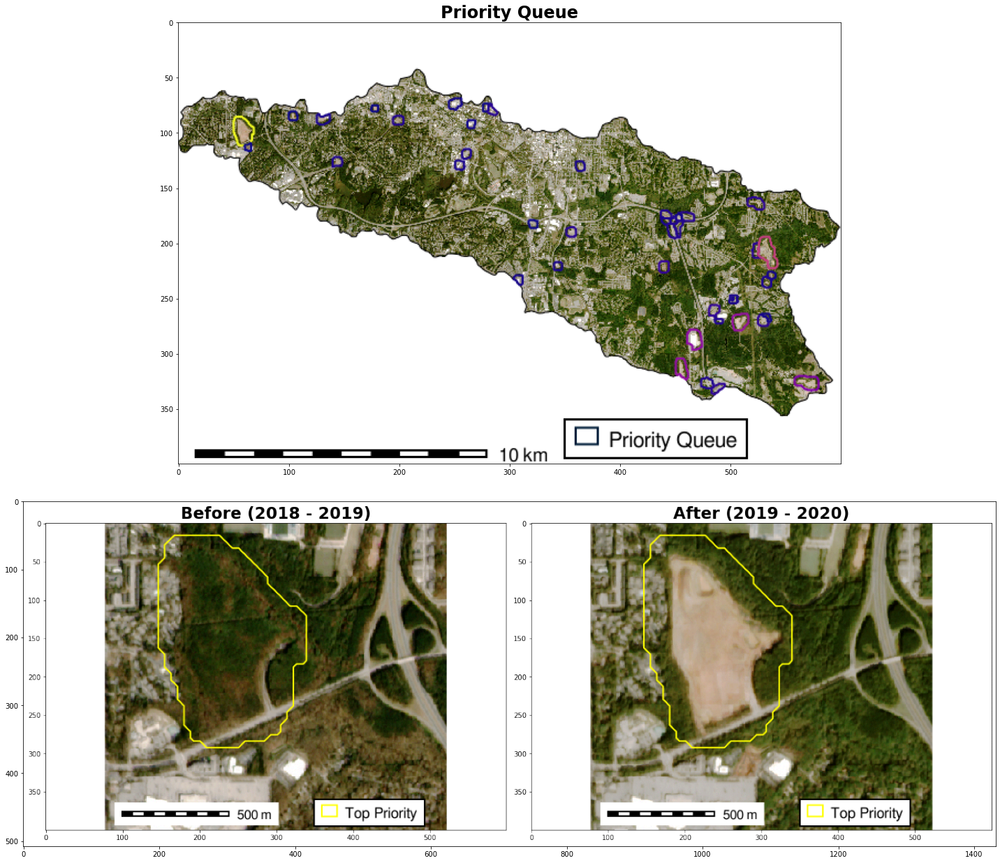

In [181]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(2, 1, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
# ax.set_axis_off()
img_ortho = Image.open("output/ps_after_3m_priority_queue_map.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('Priority Queue',{"fontsize":24, "fontweight":"bold"})

# plt.colorbar(ticks=[0.1, 0.3, 0.5, 0.7], orientation='horizontal')
ax = fig.add_subplot(2, 1, 2)
img2 = Image.open("output/priority_queue_3m_fenton_figure.png")
imgplot = plt.imshow(img2)
# imgplot.set_clim(0.0, 0.7)
# ax.set_title('After (2019 - 2020)',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/priority_queue_3m_fenton_full_figure.png",bbox_inches='tight')

# Compare Results

### Create Before after watersheds and streams to compare effects of fusion

In [401]:
def subtract(before, after, output, shade="cary_flight_2_odm_dtm_3m_fused_relief"):
    expression = f"{output} = {after} - {before}"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=output, color="differences", flags="")
    #Shaded Relief Map
    output2=f"{output}_relief_shaded"
    gs.run_command("r.shade", shade=shade, color=output, output=output2, overwrite=True)

In [ ]:
gs.run_command("g.region",raster="depth_ned_19sec_site_priority_1.60", res=3, flags="pa")

subtract(
    before="depth_ned_19sec_site_priority_1.60",
    after="depth_cary_town_blvd_flight_1_odm_dtm_3m_fused.60",
    output="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60",
    shade="cary_town_blvd_flight_1_odm_dtm_3m_fused_relief")

depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map = gj.GrassRenderer(filename="output/depth_fenton_sub_ned_f1_odm_dtm_3m_fused_60.png")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_erase()
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_rast(map="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60_relief_shaded")
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_vect(map="wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_basins_3k", fill_color="none", legend_label="Subwatersheds")
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_vect(map="wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_streams_3k_ext", color="blue", type="line", width=1, legend_label="Post-Fusion Streams")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_legend(raster="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60", at=(12,60,2,5),title="Depth (m)", title_fontsize=10)
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_legend_vect(at=(2,9,2,6),fontsize=10,flags="b", bgcolor="white", border_width=1)
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_barscale(at=(2,7,100,100), units="meters", flags="n")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.show()

# Compare USGS DEM to Fusion geomorphology

# Compare NLCD 2016 with 2019

{'0 road 8100.000000 9 3.56%': None, '3 forest 222300.000000 247 97.63%': None}


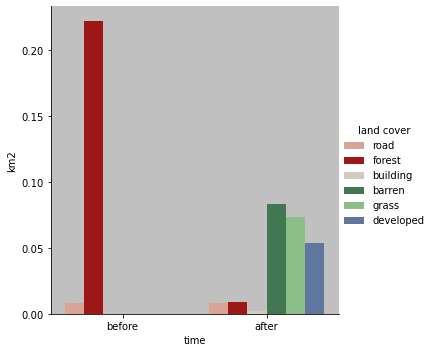

In [544]:
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dtm_3m_pmask", res=30, flags="pa")

gs.run_command("r.mask", raster="cary_town_blvd_flight_1_odm_dtm_3m_pmask", overwrite=True)
before_class_stats = gs.parse_command("r.stats", input="classified_before_30m_recl", flags="acpln")
after_class_stats = gs.parse_command("r.stats", input="classified_after_30m_recl", flags="acpln")

landcover_dict = {"class":[] , "land cover":[], "m2":[], "cells":[], "percent":[], "time":[] }
print(before_class_stats)
for k in before_class_stats.keys():
    row = k.split(" ") 
    row.append("before")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])

for k in after_class_stats.keys():
    row = k.split(" ")
    row.append("after")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])  

df_landcover = pd.DataFrame(landcover_dict)
df_landcover.head(10)
df_landcover['km2'] = df_landcover['m2'].apply(pd.to_numeric) / 1e6
landcover_color_palette = [
    'E29E8C', # Class 0 - road/highways         NLCD class color 22
    'B50000', # Class 1 - Building dark red     NLCD class color 24
    'D2CDC0', # Class 2 - barren                NLCD class color 31
    '38814E', # Class 3 - Forest                NLCD class color 42
    '85C77E', # Class 4 - Grass                 NLCD class color 41
    '5475A8', # Class 5 -  water                 NLCD class color 11
    'E8D1D1' # Class 5 -  developed             NLCD class color 21
]
sns.catplot(x="time", y="km2", hue="land cover", data=df_landcover, kind="bar", palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))

In [545]:
df_landcover.head(10)

,class,land cover,m2,cells,percent,time,km2
0,0,road,8100.000000,9,3.56%,before,0.0081
1,3,forest,222300.000000,247,97.63%,before,0.2223
2,0,road,8100.000000,9,3.61%,after,0.0081
3,1,building,1800.000000,2,0.80%,after,0.0018
4,2,barren,83700.000000,93,37.35%,after,0.0837
5,3,forest,9000.000000,10,4.02%,after,0.0090
6,4,grass,73800.000000,82,32.93%,after,0.0738
7,6,developed,54000.000000,60,24.10%,after,0.0540


In [546]:
df_landcover_p = pd.pivot_table(df_landcover, values='km2', index=['land cover'], columns=['time'], aggfunc=np.sum) #.pct_change(axis='columns')
df_landcover_p['% change'] = df_landcover_p.apply(lambda r : ((r['after'] - r['before'])/r['before']) * 100, axis = 1)
df_landcover_p.reset_index().head()

time,land cover,after,before,% change
0,barren,0.0837,NaN,NaN
1,building,0.0018,NaN,NaN
2,developed,0.0540,NaN,NaN
3,forest,0.0090,0.2223,-95.951417
4,grass,0.0738,NaN,NaN


### Evaluate with pandas

Color table for raster map <nlcd_2016_recl> set to 'nlcd'
Color table for raster map <nlcd_2019_recl> set to 'nlcd'
{'11|Open Water|1269000.000000|1410|1.07%': None, '21|Developed (Open Space)|38799900.000000|43111|32.64%': None, '22|Developed (Low Intensity)|22307400.000000|24786|18.77%': None, '23|Developed (Medium Intensity)|14373900.000000|15971|12.09%': None, '24|Developed (High Intensity)|4059000.000000|4510|3.41%': None, '31|Barren Land|1181700.000000|1313|0.99%': None, '41|Deciduous Forest|8063100.000000|8959|6.78%': None, '42|Evergreen Forest|8843400.000000|9826|7.44%': None, '43|Mixed Forest|9930600.000000|11034|8.35%': None, '52|Shrub/Scrub|721800.000000|802|0.61%': None, '71|Grassland/Herbaceous|1474200.000000|1638|1.24%': None, '81|Pasture/Hay|2786400.000000|3096|2.34%': None, '82|Cultivated Crops|385200.000000|428|0.32%': None, '90|Woody Wetlands|4502700.000000|5003|3.79%': None, '95|Emergent Herbaceous Wetlands|182700.000000|203|0.15%': None}
Type: <class 'str'>, class: 

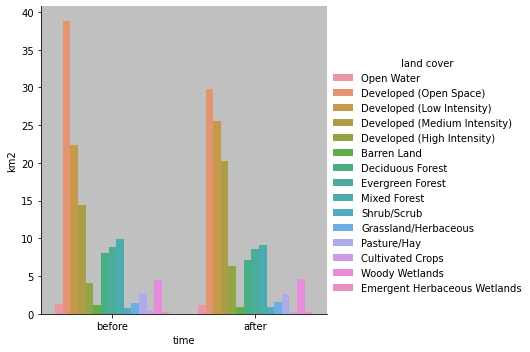

In [587]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
gs.run_command("g.region", raster="walnut_creek", res=30, flags="pa")
gs.run_command("r.mask", raster="walnut_creek", overwrite=True)
before_class_stats = gs.parse_command("r.stats", input="nlcd_2016_recl", flags="acpln", separator="|")
after_class_stats = gs.parse_command("r.stats", input="nlcd_2019_recl", flags="acpln", separator="|")

landcover_dict = {"class":[] , "land cover":[], "m2":[], "cells":[], "percent":[], "time":[] }
print(before_class_stats)
for k in before_class_stats.keys():
    row = k.split("|") 
    row.append("before")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])

for k in after_class_stats.keys():
    row = k.split("|")
    row.append("after")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])  

df_nlcd = pd.DataFrame(landcover_dict)
df_nlcd.head(10)
df_nlcd['km2'] = df_nlcd['m2'].apply(pd.to_numeric) / 1e6
# landcover_color_palette = [
#     'E29E8C', # Class 0 - road/highways         NLCD class color 22
#     'B50000', # Class 1 - Building dark red     NLCD class color 24
#     'D2CDC0', # Class 2 - barren                NLCD class color 31
#     '38814E', # Class 3 - Forest                NLCD class color 42
#     '85C77E', # Class 4 - Grass                 NLCD class color 41
#     '5475A8', # Class 5 -  water                 NLCD class color 11
#     'E8D1D1' # Class 5 -  developed             NLCD class color 21
# ]
sns.catplot(x="time", y="km2", hue="land cover", data=df_nlcd, kind="bar" ) #, palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))

In [591]:
df_nlcd.head(50)

,class,land cover,m2,cells,percent,time,km2
0,11,Open Water,1269000.000000,1410,1.07%,before,1.2690
1,21,Developed (Open Space),38799900.000000,43111,32.64%,before,38.7999
2,22,Developed (Low Intensity),22307400.000000,24786,18.77%,before,22.3074
3,23,Developed (Medium Intensity),14373900.000000,15971,12.09%,before,14.3739
4,24,Developed (High Intensity),4059000.000000,4510,3.41%,before,4.0590
5,31,Barren Land,1181700.000000,1313,0.99%,before,1.1817
6,41,Deciduous Forest,8063100.000000,8959,6.78%,before,8.0631
7,42,Evergreen Forest,8843400.000000,9826,7.44%,before,8.8434
8,43,Mixed Forest,9930600.000000,11034,8.35%,before,9.9306
9,52,Shrub/Scrub,721800.000000,802,0.61%,before,0.7218


In [601]:
df_nlcd[df_nlcd['time'] == 'after']['km2'].sum()

118.881

In [596]:
df_nlcd_p = pd.pivot_table(df_nlcd, values='km2', index=['land cover'], columns=['time'], aggfunc=np.sum) #.pct_change(axis='columns')
df_nlcd_p['% change'] = df_nlcd_p.apply(lambda r : ((r['after'] - r['before'])/r['before']) * 100, axis = 1)
# df_nlcd_p = df_nlcd_p[['land cover', 'before', 'after','% change']]
df_nlcd_p.reset_index().sort_values(by="% change").head(50)

time,land cover,after,before,% change
1,Cultivated Crops,0.2871,0.3852,-25.467290
0,Barren Land,0.8991,1.1817,-23.914699
6,Developed (Open Space),29.7369,38.7999,-23.358308
2,Deciduous Forest,7.1307,8.0631,-11.563791
11,Open Water,1.1340,1.2690,-10.638298
10,Mixed Forest,9.0621,9.9306,-8.745695
12,Pasture/Hay,2.6442,2.7864,-5.103359
8,Evergreen Forest,8.5968,8.8434,-2.788520
14,Woody Wetlands,4.5837,4.5027,1.798921
9,Grassland/Herbaceous,1.5372,1.4742,4.273504


In [614]:
!r.coin first=nlcd_2016_recl second=nlcd_2019_recl units=k -w

Tabulating Coincidence between 'nlcd_2016_recl' and 'nlcd_2019_recl'
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100

+------------------------------------------------------------------------------+
|                        COINCIDENCE TABULATION REPORT                         |
|------------------------------------------------------------------------------|
| Location: nc_spm_08_gras  Mapset: rapid-dsm        Date: Thu Dec 16 12:27:40 |
|                                                                              |
| Layer 1: nlcd_2016_recl -- NLCD 2016                                         |
| Layer 2: nlcd_2019_recl -- NLCD 2019                                         |
| Mask:    <walnut_creek> in mapset <rapid-dsm>                                |
|                                                                              |
| Units:   square kilometers                                

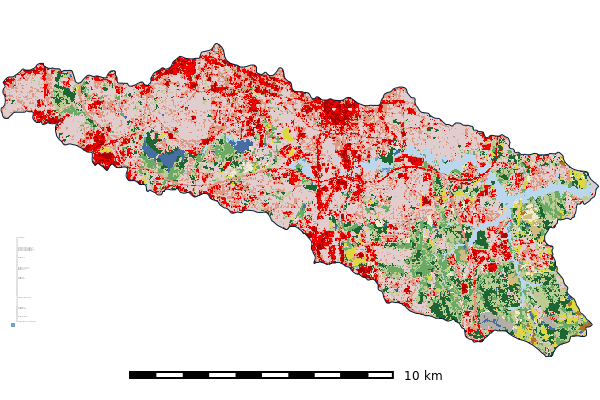

In [605]:
nlcd_2016_map = gj.GrassRenderer(filename="output/nlcd_2016_map.png")
nlcd_2016_map.d_erase()
nlcd_2016_map.d_rast(map="nlcd_2016_recl")
nlcd_2016_map.d_vect(map="walnut_creek", fill_color="none")
nlcd_2016_map.d_legend(raster="nlcd_2016_recl", at=(2,40,2,6))
nlcd_2016_map.d_barscale(at=(20,10,12,10), units="kilometers")
nlcd_2016_map.show()

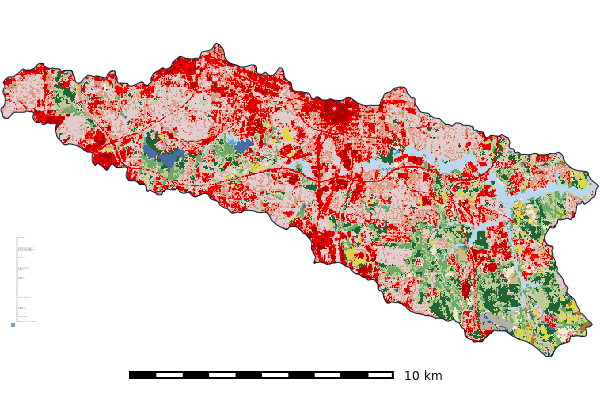

In [604]:
nlcd_2019_map = gj.GrassRenderer(filename="output/nlcd_2019_map.png")
nlcd_2019_map.d_erase()
nlcd_2019_map.d_rast(map="nlcd_2019_recl")
nlcd_2019_map.d_vect(map="walnut_creek", fill_color="none")
nlcd_2019_map.d_legend(raster="nlcd_2019_recl", at=(2,40,2,6))
nlcd_2019_map.d_barscale(at=(20,10,12,10), units="kilometers")
nlcd_2019_map.show()

In [20]:
gs.run_command("g.region", region="fenton_basin", res=3, flags="pa")
!r.stream.basins -m direction=wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_direction_3k coordinates=632060.1567576004,224932.19818562106 memory=3000 basins=fenton_3m_fused_basin_3k -l

Memory swap calculation (may take some time)...
Reading raster map
<wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_direction_3k>...
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
Calculating basins using coordinates...
Delineating basins for 1 outlets...
   0 100
Writing raster map <fenton_3m_fused_basin_3k>...
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100


# Priority Queue Validation

## Did Change Occur?

In [2]:
import pandas as pd
import sqlite3
 
# Read in the attribute table
sqlpath = gs.read_command("db.databases", driver="sqlite").replace('\n', '')
con = sqlite3.connect(sqlpath)
sqlstat="SELECT * FROM priority_queue_norm"
df = pd.read_sql_query(sqlstat, con)
con.close()

In [4]:
import seaborn as sns
df.head(5)

,cat,value,area,noise
0,1,0.015778,4162.5,0
1,2,0.026296,131400.0,0
2,3,0.015778,562.5,1
3,4,0.003757,6975.0,0
4,5,0.018032,52087.5,0


In [59]:
df[(df.value == 0) & (df.noise == 0)].describe()

,cat,value,area,noise
count,3.000000,3.0,3.000000,3.0
mean,116.333333,0.0,69112.500000,0.0
std,64.933299,0.0,72318.018372,0.0
min,42.000000,0.0,19575.000000,0.0
25%,93.500000,0.0,27618.750000,0.0
50%,145.000000,0.0,35662.500000,0.0
75%,153.500000,0.0,93881.250000,0.0
max,162.000000,0.0,152100.000000,0.0


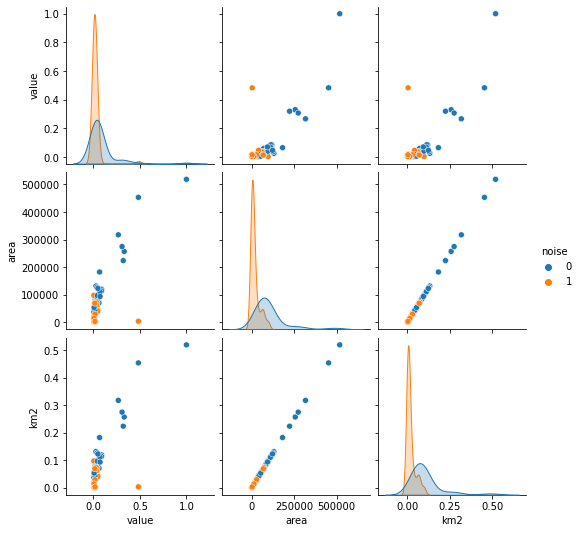

In [23]:
df_priority = df[df.value > 0].drop(columns=['cat'])
df_priority['km2'] = df_priority['area'].apply(lambda x : x/1e6)
sns.pairplot(df_priority, hue="noise")

In [25]:
df_priority.describe()

,value,area,noise,km2
count,109.000000,109.000000,109.000000,109.000000
mean,0.049559,58921.100917,0.532110,0.058921
std,0.124084,83623.005026,0.501273,0.083623
min,0.003757,562.500000,0.000000,0.000562
25%,0.009016,4162.500000,0.000000,0.004163
50%,0.015778,40275.000000,1.000000,0.040275
75%,0.037566,85500.000000,1.000000,0.085500
max,1.000000,518850.000000,1.000000,0.518850


## RMSE Raw Priorty Queue

In [3576]:
def rmse1(df,predictions, targets):
    # print((df_inlet_latex[predictions] - df_inlet_latex[targets]) ** 2)
    return np.sqrt(((df[predictions] - df[targets]) ** 2).mean())

df_priority['target'] = 0
priority_rmse = rmse1(df_priority,'noise','target')
print(f"Priority RMSE: {priority_rmse}")


Priority RMSE: 0.7294587663076778


In [26]:
df_priority.groupby("noise").describe()

value                                                              \
      count      mean       std       min       25%       50%       75%   
noise                                                                     
0      51.0  0.083823  0.162962  0.003757  0.017280  0.037566  0.058979   
1      58.0  0.019431  0.062476  0.003757  0.005259  0.010518  0.015402   

                 area                 ...                         km2  \
            max count           mean  ...         75%       max count   
noise                                 ...                               
0      1.000000  51.0  106394.117647  ...  116381.250  518850.0  51.0   
1      0.483095  58.0   17177.586207  ...   18590.625   97650.0  58.0   

                                                                            
           mean       std       min       25%       50%       75%      max  
noise                                                                       
0      0.106394  0.100317  0.004163  0.046069  0.085500  0.116381  0.51885  
1      0.017178  0.025145  0.000562  0.001575  0.004275  0.018591  0.09765  

[2 rows x 24 columns]

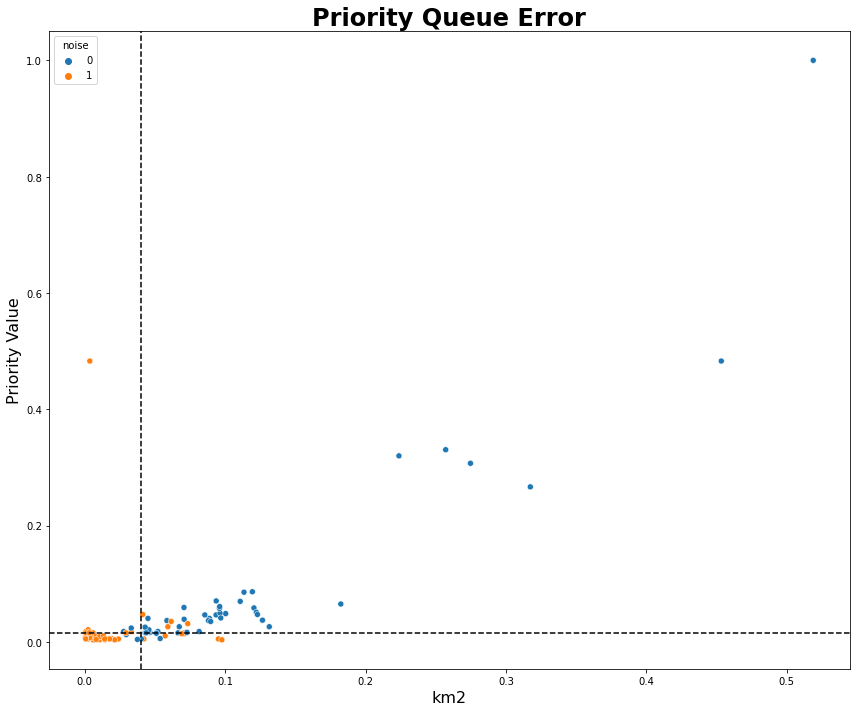

In [85]:
fig = plt.figure(figsize=(12, 10))
ax = sns.scatterplot(data=df_priority, x="km2", y="value", hue="noise")
ax.set_title('Priority Queue Error',{"fontsize":24, "fontweight":"bold"})
ax.set_xlabel('km2', fontsize=16)
ax.set_ylabel('Priority Value', fontsize=16)
plt.axvline(df_priority["km2"].median(), color='black', ls="--")
plt.axhline(df_priority["value"].median(), color='black', ls="--")

plt.tight_layout()
plt.savefig("output/priority_queue_error.png",bbox_inches='tight')

<AxesSubplot:xlabel='km2', ylabel='value'>

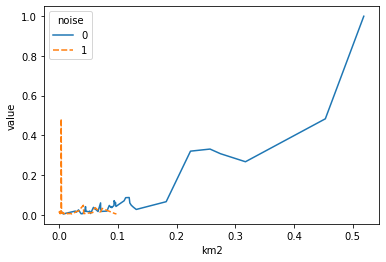

In [29]:
sns.lineplot(data=df_priority, x="km2", y="value", hue="noise", style="noise")

<AxesSubplot:xlabel='km2', ylabel='Count'>

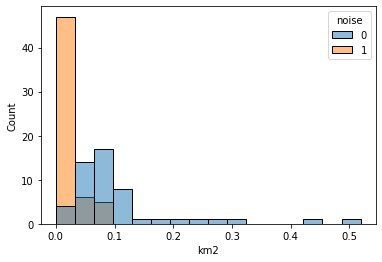

In [31]:
sns.histplot(data=df_priority, x="km2", hue="noise")

<AxesSubplot:xlabel='value', ylabel='Count'>

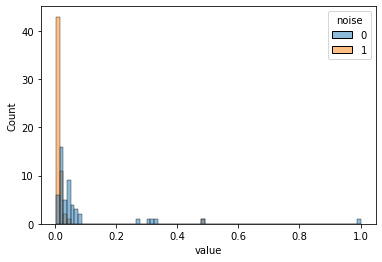

In [32]:
sns.histplot(data=df_priority, x="value", hue="noise")

<AxesSubplot:xlabel='value', ylabel='Count'>

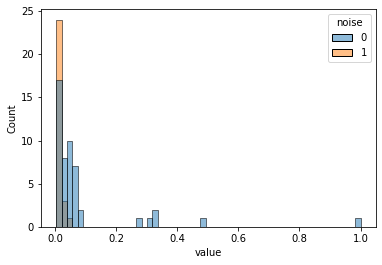

In [33]:
# Median
sns.histplot(data=df_priority[df_priority["km2"] > 0.004275] , x="value", hue="noise")

<AxesSubplot:xlabel='value', ylabel='Count'>

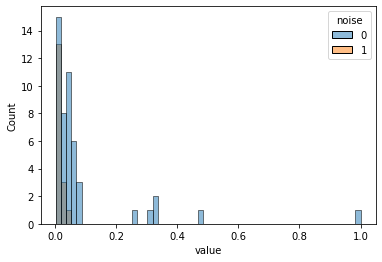

In [34]:
# Mean
sns.histplot(data=df_priority[df_priority["km2"] > 0.017178] , x="value", hue="noise")

In [36]:
df_priority[df_priority["km2"] > 0.017178].describe()

,value,area,noise,km2
count,66.000000,66.000000,66.000000,66.000000
mean,0.068313,94609.090909,0.257576,0.094609
std,0.145939,91266.217435,0.440650,0.091266
min,0.003757,17662.500000,0.000000,0.017663
25%,0.015778,44071.875000,0.000000,0.044072
50%,0.026296,70762.500000,0.000000,0.070763
75%,0.049399,97453.125000,0.750000,0.097453
max,1.000000,518850.000000,1.000000,0.518850


In [37]:
df_priority[df_priority["km2"] > 0.017178].groupby("noise").describe()

value                                                              \
      count      mean       std       min       25%       50%       75%   
noise                                                                     
0      49.0  0.086846  0.165602  0.004508  0.018032  0.039068  0.059354   
1      17.0  0.014894  0.012987  0.003757  0.005259  0.010518  0.018032   

                 area                 ...                       km2            \
            max count           mean  ...       75%       max count      mean   
noise                                 ...                                       
0      1.000000  49.0  110509.438776  ...  119362.5  518850.0  49.0  0.110509   
1      0.047333  17.0   48778.676471  ...   69075.0   97650.0  17.0  0.048779   

                                                                  
            std       min       25%       50%       75%      max  
noise                                                             
0      0.100210  0.027675  0.050963  0.088087  0.119362  0.51885  
1      0.026587  0.017663  0.023963  0.042075  0.069075  0.09765  

[2 rows x 24 columns]

<AxesSubplot:xlabel='km2', ylabel='value'>

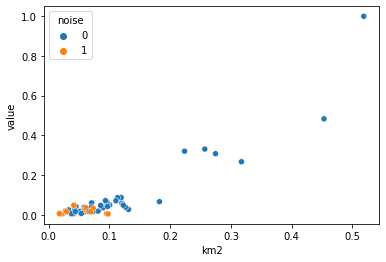

In [38]:
sns.scatterplot(data=df_priority[df_priority["km2"] > 0.017178], x="km2", y="value", hue="noise")

<AxesSubplot:xlabel='km2', ylabel='value'>

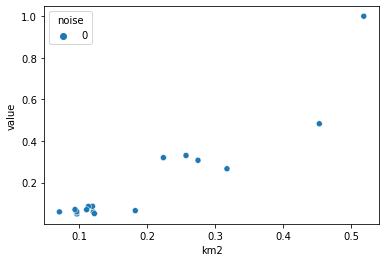

In [42]:
sns.scatterplot(data=df_priority[(df_priority["km2"] > df_priority["km2"].mean()) & (df_priority["value"] > df_priority["value"].mean())] , x="km2", y="value", hue="noise")

In [43]:
df_priority_clean = df_priority[(df_priority["km2"] > df_priority["km2"].mean()) & (df_priority["value"] > df_priority["value"].mean())]
df_priority_clean.describe()

,value,area,noise,km2
count,17.000000,17.000000,17.0,17.000000
mean,0.201352,192130.147059,0.0,0.192130
std,0.246153,133014.726192,0.0,0.133015
min,0.049587,70650.000000,0.0,0.070650
25%,0.059354,96300.000000,0.0,0.096300
50%,0.070624,120487.500000,0.0,0.120487
75%,0.307288,257062.500000,0.0,0.257063
max,1.000000,518850.000000,0.0,0.518850


<AxesSubplot:xlabel='value', ylabel='Count'>

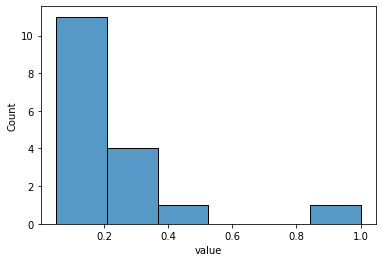

In [46]:
sns.histplot(data=df_priority_clean, x="value")

<AxesSubplot:xlabel='km2', ylabel='Count'>

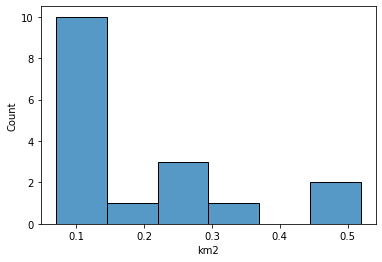

In [47]:
sns.histplot(data=df_priority_clean, x="km2")

In [51]:
print(df_priority["area"].mean())
print(df_priority["km2"].mean())

print(df_priority["value"].mean())

58921.10091743119
0.058921100917431204
0.049559220183486234


In [ ]:
!v.extract --overwrite input=priority_queue_norm@rapid-dsm where="area > 58921.10091743119 AND value > 0.049559220183486234" output=priority_queue_clean
!v.colors map=priority_queue_clean@rapid-dsm use=attr column=value color=plasma

In [3575]:
df_priority_clean_med = df_priority[(df_priority["km2"] > df_priority["km2"].median()) & (df_priority["value"] > df_priority["value"].median())]
df_priority_clean_med.describe()

,value,area,noise,km2,target
count,42.000000,42.000000,42.000000,42.000000,42.0
mean,0.101123,122710.714286,0.095238,0.122711,1.0
std,0.175251,103352.714093,0.297102,0.103353,0.0
min,0.016529,41287.500000,0.000000,0.041287,1.0
25%,0.032494,68118.750000,0.000000,0.068119,1.0
50%,0.046582,93543.750000,0.000000,0.093544,1.0
75%,0.064237,121753.125000,0.000000,0.121753,1.0
max,1.000000,518850.000000,1.000000,0.518850,1.0


In [53]:
df_priority_clean_med.groupby("noise").describe()

value                                                              \
      count      mean       std       min       25%       50%       75%   
noise                                                                     
0      38.0  0.108071  0.183047  0.016529  0.035687  0.046957  0.068745   
1       4.0  0.035124  0.008940  0.026296  0.030240  0.033434  0.038317   

                 area                 ...                         km2  \
            max count           mean  ...         75%       max count   
noise                                 ...                               
0      1.000000  38.0  129434.210526  ...  122765.625  518850.0  38.0   
1      0.047333   4.0   58837.500000  ...   64490.625   73350.0   4.0   

                                                                            
           mean       std       min       25%       50%       75%      max  
noise                                                                       
0      0.129434  0.106465  0.042975  0.071269  0.096019  0.122766  0.51885  
1      0.058838  0.013242  0.041287  0.054703  0.060356  0.064491  0.07335  

[2 rows x 24 columns]

In [56]:
median_query = f'area > {df_priority["area"].median()} AND value > {df_priority["value"].median()}'
gs.run_command("v.extract", overwrite=True, input="priority_queue_norm", where=median_query, output="priority_queue_clean_med")
!v.colors map=priority_queue_clean_med use=attr column=value color=plasma

Converting color rules into categories...
   0   4   7  11  14  19  23  26  30  33  38  42  45  50  54  57  61  64  69  73  76  80  83  88  92  95 100
Writing color rules...
Color table for vector map <priority_queue_clean_med@rapid-dsm> set to
'plasma'


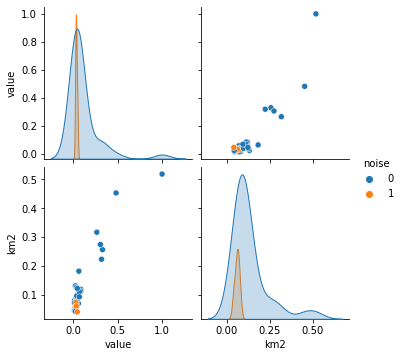

In [86]:

sns.pairplot(df_priority_clean_med.drop(columns=["area"]), hue="noise")

In [115]:
# Calculate confidence
n_size = []
n_correct = []
n_error = []
n_perc_error = []
nf_size = []
nf_correct = []
nf_error = []
nf_perc_error = []
nf_perc_loss_e = []
nf_perc_loss_c = []
area_thres = []
value_thres = []
df_conf_envelope = pd.DataFrame({})
for n in range(500):
    samp = df_priority.sample(frac=0.8, replace=False, random_state=n)
    samp_area_median = samp.km2.median()
    samp_value_median = samp.value.median()
    n_total = samp.count().value
    n_size.append(n_total)
    correct_total = samp[samp.noise == 0].count().value
    n_correct.append(correct_total)
    error_total = samp[samp.noise == 1].count().value
    n_error.append(error_total)
    error_rate = (error_total / (n_total)) * 100.0
    n_perc_error.append(error_rate)
#     print(f"Total Samples: {n_total}")
#     print(f"Total Correct: {correct_total}, Total Error: {error_total}, Error Rate: {error_rate}%")
    area_thres.append(samp_area_median)
    value_thres.append(samp_value_median)
#     print(f"(Medians) km2: {samp_area_median}, Value: {samp_value_median}")
    samp_filtered = samp[(samp["km2"] > samp_area_median) & (samp["value"] > samp_value_median)]
    n_filtered = samp_filtered.count().value
    nf_size.append(n_filtered)
    nf_error_count = samp_filtered[samp_filtered.noise == 1].count().value
    nf_error.append(nf_error_count)
    nf_correct_count = samp_filtered[samp_filtered.noise == 0].count().value
    nf_correct.append(nf_correct_count)
    nf_error_rate = (nf_error_count / (n_filtered)) * 100.0
    nf_perc_error.append(nf_error_rate)
    nf_loss_e = ((error_total - nf_error_count) / error_total)*100
    nf_perc_loss_e.append(nf_loss_e)
    nf_loss_c = ((correct_total - nf_correct_count) / correct_total)* 100
    nf_perc_loss_c.append(nf_loss_c)
    # print(f"Filtered Total: {n_filtered}")
    # print(f"Correct: {nf_correct_count}, Error: {nf_error_count},  Error Rate: {nf_error_rate}%")
    # print("#" * 50)
    # print(samp_filtered.groupby("noise").describe())
    
df_conf_envelope = pd.DataFrame({
    "n_size": n_size,
    "n_correct":n_correct,
    "n_error":n_error,
    "n_perc_error": n_perc_error,
    "nf_size": nf_size,
    "nf_correct": nf_correct,
    "nf_error": nf_error,
    "nf_perc_error":nf_perc_error,
    "nf_perc_loss_e": nf_perc_loss_e,
    "nf_perc_loss_c": nf_perc_loss_c,
    "area_thres": area_thres,
    "value_thres": value_thres
})

df_conf_envelope.head()

,n_size,n_correct,n_error,n_perc_error,nf_size,nf_correct,nf_error,nf_perc_error,nf_perc_loss_e,nf_perc_loss_c,area_thres,value_thres
0,87,38,49,56.321839,32,28,4,12.500000,91.836735,26.315789,0.033075,0.015778
1,87,41,46,52.873563,33,30,3,9.090909,93.478261,26.829268,0.037463,0.015778
2,87,41,46,52.873563,32,29,3,9.375000,93.478261,29.268293,0.037463,0.015778
3,87,39,48,55.172414,33,30,3,9.090909,93.750000,23.076923,0.041287,0.015778
4,87,41,46,52.873563,36,33,3,8.333333,93.478261,19.512195,0.042075,0.015778


In [116]:
df_conf_envelope.describe()

,n_size,n_correct,n_error,n_perc_error,nf_size,nf_correct,nf_error,nf_perc_error,nf_perc_loss_e,nf_perc_loss_c,area_thres,value_thres
count,500.0,500.000000,500.000000,500.000000,500.000000,500.00000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,87.0,40.622000,46.378000,53.308046,33.130000,30.19400,2.936000,8.886923,93.699103,25.621291,0.038397,0.015772
std,0.0,2.099508,2.099508,2.413227,1.495853,1.74541,0.818072,2.558004,1.620495,3.362698,0.004821,0.000184
min,87.0,35.000000,40.000000,45.977011,29.000000,24.00000,0.000000,0.000000,90.000000,11.111111,0.021263,0.014275
25%,87.0,39.000000,45.000000,51.724138,32.000000,29.00000,2.000000,6.401210,93.023256,23.684211,0.033075,0.015778
50%,87.0,41.000000,46.000000,52.873563,33.000000,30.00000,3.000000,8.823529,93.478261,25.641026,0.040275,0.015778
75%,87.0,42.000000,48.000000,55.172414,34.000000,31.00000,3.000000,9.677419,95.348837,27.906977,0.042075,0.015778
max,87.0,47.000000,52.000000,59.770115,38.000000,35.00000,5.000000,17.241379,100.000000,37.777778,0.045675,0.018032


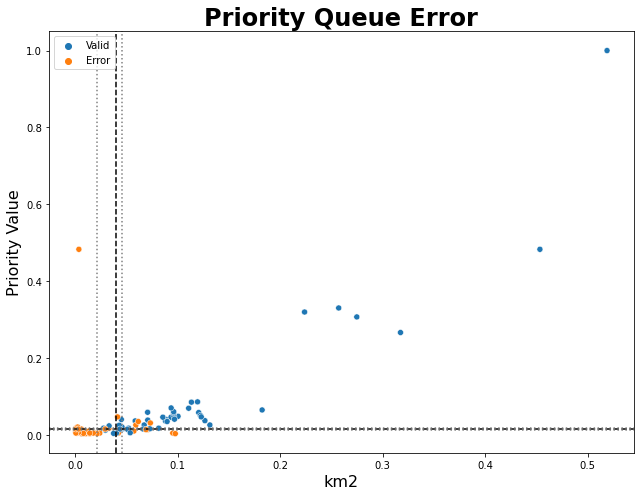

In [510]:
fig = plt.figure(figsize=(9, 7))
df_priority['Legend'] = df_priority.noise.map({0:"Valid", 1: "Error"})
ax = sns.scatterplot(data=df_priority, x="km2", y="value", hue="Legend")
ax.set_title('Priority Queue Error',{"fontsize":24, "fontweight":"bold"})
ax.set_xlabel('km2', fontsize=16)
ax.set_ylabel('Priority Value', fontsize=16)
plt.axvline(df_priority["km2"].median(), color='black', ls="--")
plt.axvline(df_conf_envelope["area_thres"].max(), color='grey', ls=":") #max
plt.axvline(df_conf_envelope["area_thres"].min(), color='grey', ls=":") #min
plt.axhline(df_priority["value"].median(), color='black', ls="--")
plt.axhline(df_conf_envelope["value_thres"].max(), color='grey', ls=":") #max
plt.axhline(df_conf_envelope["value_thres"].min(), color='grey', ls=":") #min
# handles, labels = ax.get_legend_handles_labels()
# print(handles, labels)
ax.legend(loc='upper left')
# plt.legend(handles=[plt],labels=['Median', 'Envelope'])

plt.tight_layout()
plt.savefig("output/priority_queue_error.png",bbox_inches='tight')

### Priority Queue Filterd RMSE

In [3577]:
df_priority_clean_med['target'] = 0
priority_clean_rmse = rmse1(df_priority_clean_med,'noise','target')
print(f"Priority RMSE: {priority_clean_rmse}")

Priority RMSE: 0.3086066999241838


<ipython-input-3577-6c0fa3abe13a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_priority_clean_med['target'] = 0


## Priority Validation Permits

## Validations Rim Elevations

In [4100]:
!v.select -c --overwrite ainput=City_of_Raleigh_Stormwater_Inlets binput=priority_queue_clean_med output=cor_validation_inlets operator=within


Processing features...
   0   2   4   6   8  10  12  14  16  18  20  22  24  26  28  30  32  34  36  38  40  42  44  46  48  50  52  54  56  58  60  62  64  66  68  70  72  74  76  78  80  82  84  86  88  90  92  94  96  98 100
Processing areas...
   0   4   9  13  16  20  23  27  30  34  37  41  44  48  51  55  58  62  65  69  72  76  79  83  86  90  93  97 100
Writing selected features...
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
Writing attributes...
Building topology for vector map <cor_validation_inlets@rapid-dsm>...
Registering primitives...
v.select complete. 763 features written to output.


# Study Area Figure

* National_Atlas_State_Boundaries_USGS@rapid-dsm
* NC_State_and_County_Boundaries@rapid-dsm
* Walnut Creek

## US View

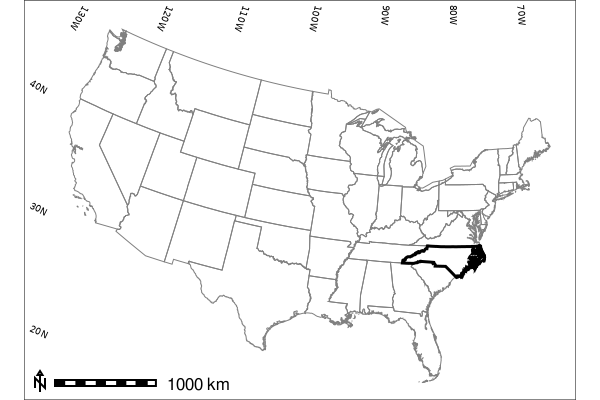

In [4276]:
# priority_queue_clean_med
gs.run_command("g.region",region="CONUS", res=3, flags="pa")
ps_before_3m_cary_map = gj.GrassRenderer(filename="output/us_states.png")
ps_before_3m_cary_map.d_erase()

# ps_before_3m_cary_map.d_rast(map="ps_after_3m_comp")
ps_before_3m_cary_map.d_vect(map="National_Atlas_State_Boundaries_USGS", fill_color="none", color="grey", width="1", flags="s", 
                             where="STATE_FIPS not in ('78','72','15','02')"
                            )
ps_before_3m_cary_map.d_vect(map="National_Atlas_State_Boundaries_USGS", fill_color="none", color="black", width="3", flags="s", 
                             where="STATE_FIPS = '37'"
                            )

ps_before_3m_cary_map.d_grid(size="10:00:00", flags="dw", width=1, color="black",text_color="black")
ps_before_3m_cary_map.d_barscale(at=(5,8), units="meters",font="FreeSans", flags="n")
ps_before_3m_cary_map.show()

## NC View

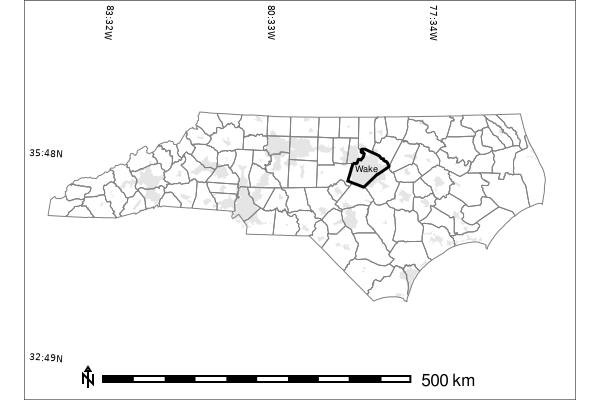

In [4527]:
gs.run_command("g.region",region="nc_state", res=3, flags="pa")

ps_before_3m_cary_map = gj.GrassRenderer(filename="output/nc_counties.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_vect(map="NCDOT_Smoothed_Urban_Boundaries_clean", fill_color="229:229:229", color="none", width="3", flags="s", 
                             where="NAME != 'Myrtle Beach--Socastee'"
                            )
ps_before_3m_cary_map.d_vect(map="NC_State_and_County_Boundaries", fill_color="none", color="grey", width="1", flags="s", 
                             #where="STATE_FIPS not in ('78','72','15','02')"
                            )
ps_before_3m_cary_map.d_vect(map="NC_State_and_County_Boundaries", fill_color="none", color="black", width="3", flags="s", 
                             where="FIPS = '183'"
                            )

ps_before_3m_cary_map.d_barscale(at=(13,9), units="meters",font="FreeSans", flags="n")

ps_before_3m_cary_map.d_grid(size="02:59:00", flags="dw", width=1, color="black",text_color="black")

ps_before_3m_cary_map.d_text(at=(60,57),text="Wake", bgcolor="none",font="FreeSans",size=2, color="black")

ps_before_3m_cary_map.show()

## Walnut Creek

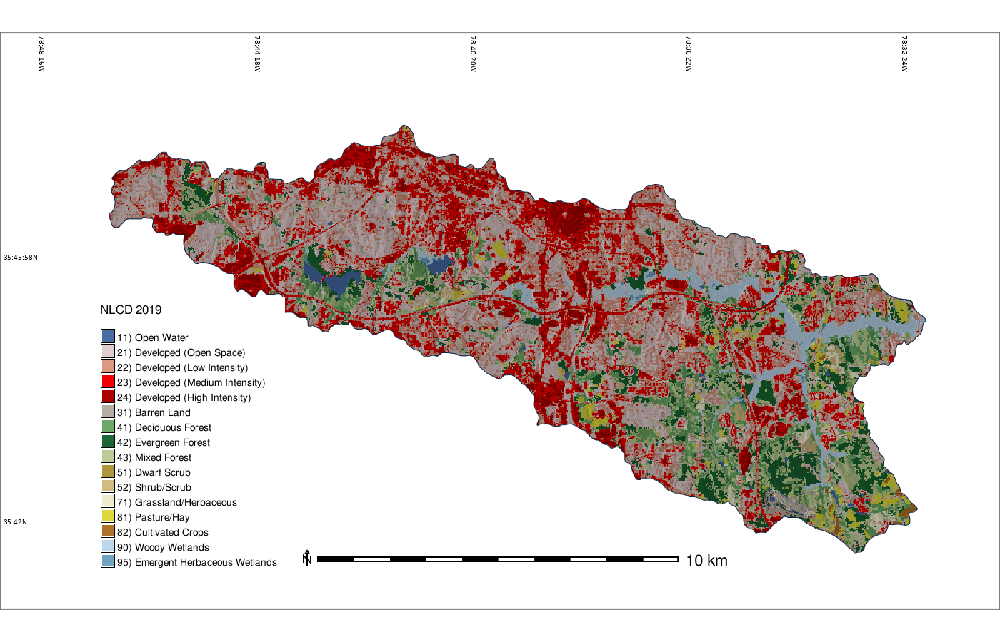

In [4516]:
gs.parse_command("g.region", raster="ned_19sec", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)

# shadedRelief(elevation="ned_19sec",relief="ned_19sec_relief", output="ned_19sec_shaded_relief")

# gs.run_command("r.shade", shade="ned_19sec_relief", color="nlcd_2019_recl", output="nlcd_2019_recl_shaded_releif", overwrite=True)

gs.run_command("g.region",
               raster="walnut_creek",
               # region="nw_one_third",
               res=3, flags="pa")

view_reg = gs.region("walnut_creek")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 3000
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 1500

gs.run_command("g.region",
               raster="walnut_creek",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

ned_19sec_map = gj.GrassRenderer(height=900, width=1400,filename="output/ned_19sec_shaded_relief.png")
ned_19sec_map.d_erase()

ned_19sec_map.d_rast(map="nlcd_2019_recl_shaded_releif")
ned_19sec_map.d_vect(map="walnut_creek", fill_color="none")
ned_19sec_map.d_legend(raster="nlcd_2019_recl", at=(9,50,10,15),
                    title="NLCD 2019", 
                    title_fontsize=12, 
                    border_color="none",
                    fontsize=10, font="FreeSans",
                    flags="btn")
ned_19sec_map.d_barscale(at=(30,14.5), units="kilometers", flags="n", font="FreeSans",fontsize=16)

ned_19sec_map.d_grid(size="00:03:58", flags="dw", width=1, color="black",text_color="black")

ned_19sec_map.show()

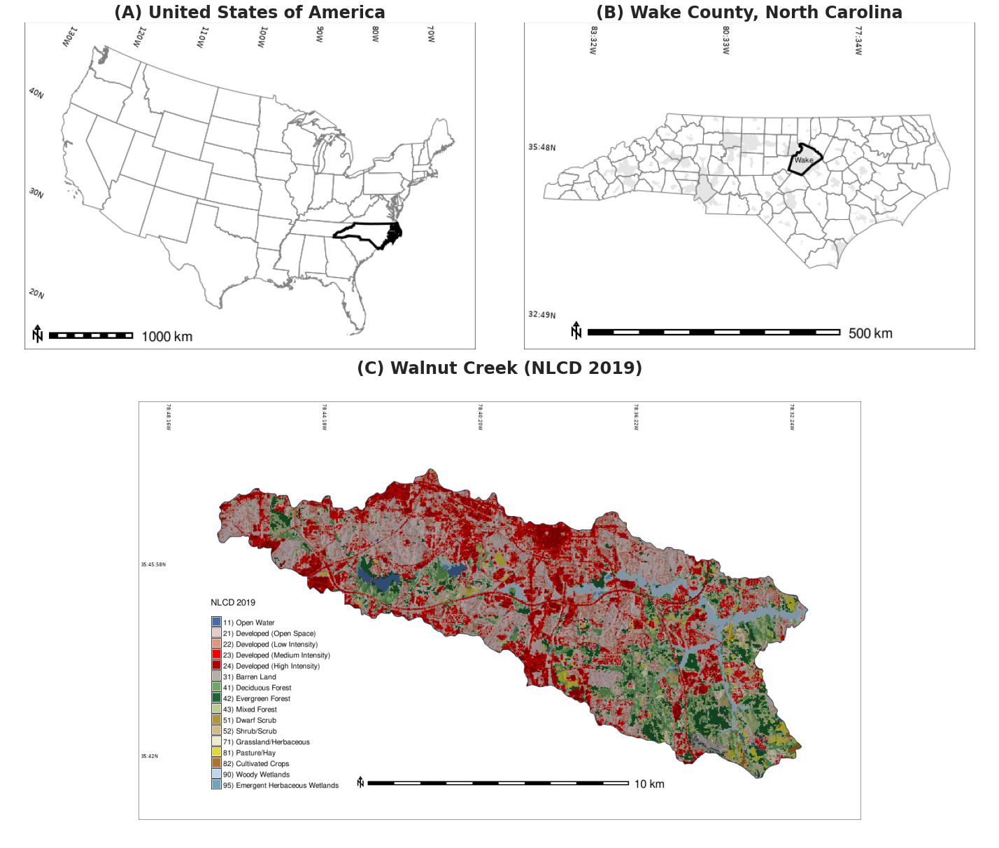

In [4528]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

# ax = fig.add_subplot(2, 1, 1)
# fig.subplots_adjust(hspace=0, wspace=0.1)

grs = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.1)

img1 = Image.open("output/us_states.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) United States of America',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0, 1])
ax2.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.1)

img1 = Image.open("output/nc_counties.png")
imgplot = plt.imshow(img1)
ax2.set_title('(B) Wake County, North Carolina',{"fontsize":24, "fontweight":"bold"})

# ax2 = fig.add_subplot(grs[0, 2])
# ax2.axis('off')
# fig.subplots_adjust(hspace=0, wspace=0.5)

# img1 = Image.open("output/wake_county.png")
# imgplot = plt.imshow(img1)
# ax2.set_title('(C) Wake County',{"fontsize":24, "fontweight":"bold"})

# spans two rows:
ax3 = fig.add_subplot(grs[1, :])
ax3.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)
img2 = Image.open("output/ned_19sec_shaded_relief.png")
imgplot = plt.imshow(img2)
ax3.set_title('(C) Walnut Creek (NLCD 2019)',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/study_area.png",bbox_inches='tight', dpi=300)

In [ ]:
# priority_queue_clean_med
gs.run_command("g.region",raster="walnut_creek", res=3, flags="pa")

ps_before_3m_cary_map = gj.GrassRenderer(filename="output/ps_after_3m_priority_queue_map.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_rast(map="ps_after_3m_comp")
ps_before_3m_cary_map.d_vect(map="walnut_creek", fill_color="none", color="black", width="1", flags="s")

ps_before_3m_cary_map.d_vect(map="priority_queue_clean_med", fill_color="none", width="2",legend_label="Priority Queue")
ps_before_3m_cary_map.d_legend_vect(at=(60,10,2,6),font="FreeSans", flags="b")

ps_before_3m_cary_map.d_barscale(at=(1,6,2,2), units="meters",font="FreeSans")
ps_before_3m_cary_map.show()